#  $\color{red}{\text{A. Preprocess}}$

###  $\color{blue}{\text{1. Importing Libs and custom Functions and Models}}$

In [1]:
#pip freeze > requirements.txt

In [2]:
import pandas as pd
import numpy as np
import sklearn
import tensorflow
import keras
print(pd.__version__)
print(np.__version__)
print(sklearn.__version__)
print(tensorflow.__version__)
print(keras.__version__)

1.3.3
1.24.3
1.2.1
2.9.1
2.9.0


In [3]:
# Impoting Lib.
import pandas as pd
import numpy as np
import xgboost
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, accuracy_score
pd.set_option('display.float_format', lambda x: '%.2f' % x)
pd.set_option('display.max_columns', None)

In [12]:
import Lithofacies_Classification
from Lithofacies_Classification import Functions
from Lithofacies_Classification import Models
print('Version:', Lithofacies_Classification.__version__)
print('------------------------------------------')
print('subpackage:', Lithofacies_Classification.__subpackage__)
print('------------------------------------------')
print('Module in Functions subpackage:', Functions.__all__)
print('------------------------------------------')
print('Module in Models subpackage:', Models.__all__)

Version: 0.0.2
------------------------------------------
subpackage: ['Functions', 'Models']
------------------------------------------
Module in Functions subpackage: ['additional_functions', 'augmentation', 'formating', 'imputer', 'plotting', 'preprocessing', 'scaler']
------------------------------------------
Module in Models subpackage: ['CatBoost_model', 'DT_model', 'KNN_model', 'LightBoost_model', 'LR_model', 'NN_model', 'RF_model', 'SVM_model', 'XGB_model']


In [13]:
# Impoting customized Functions and Models
from Lithofacies_Classification.Functions.formating import formating_data
from Lithofacies_Classification.Functions.preprocessing import preprocess_data
from Lithofacies_Classification.Functions.imputer import regression_imputer
from Lithofacies_Classification.Functions.augmentation import features_augmentation
from Lithofacies_Classification.Functions.scaler import standardscaler

from Lithofacies_Classification.Functions.plotting import triple_combo, show_log, augmented_logs, litho_prediction
from Lithofacies_Classification.Functions.additional_functions import matrix_score, clf_rep, cm_plot, error_plot

In [14]:
from Lithofacies_Classification.Models.CatBoost_model import run_CatBoost
from Lithofacies_Classification.Models.DT_model import run_DT
from Lithofacies_Classification.Models.KNN_model import run_KNN
from Lithofacies_Classification.Models.LightBoost_model import run_LightBoost
from Lithofacies_Classification.Models.LR_model import run_LR
from Lithofacies_Classification.Models.NN_model import run_NN
from Lithofacies_Classification.Models.RF_model import run_RF
from Lithofacies_Classification.Models.SVM_model import run_SVM
from Lithofacies_Classification.Models.XGB_model import run_XGB
from Lithofacies_Classification.Models.Blender_model import run_Blender

###  $\color{blue}{\text{2. Importing data | Data formating(Remove and Label encoding)}}$

In [28]:
"""Imporitng training, open test, and hidden test sets
"""
raw_training = pd.read_csv('CSV_train.csv', sep=';')       #raw_training dataset
test_data = pd.read_csv('CSV_test.csv', sep=';')
test_labels = pd.read_csv('CSV_test_target.csv', sep=';')
raw_test = pd.merge(test_data, test_labels, on=['WELL', 'DEPTH_MD'])   #raw_test dataset
raw_hidden = pd.read_csv('CSV_hidden_test.csv', sep=';')   #raw_hidden dataset

print('Shape of datasets >>> train: {} | test: {} | hidden: {}'.format(raw_training.shape, raw_test.shape, raw_hidden.shape))

Shape of datasets >>> train: (1170511, 29) | test: (136786, 28) | hidden: (122397, 29)


In [29]:
#Data formating
training_form, test_form, hidden_form, le = formating_data(raw_training, raw_test, raw_hidden)
#print(le.classes_)

1- For traing|test|hidden dataset column rename from FORCE_2020_LITHOFACIES_LITHOLOGY to LITHO
2- Column FORCE_2020_LITHOFACIES_CONFIDENCE removed.
3- Label encoding process is done for lithology column.
Shape of datasets after formating >>> train: (1170511, 28) | test: (136786, 28) | hidden: (122397, 28)


###  $\color{blue}{\text{3. some preprocess on Data(such catgorical encoding and dropping unncesary cols)}}$

In [16]:
traindata_prep, testdata_prep, hiddendata_prep = preprocess_data(training_form, test_form, hidden_form)

G:\Pc\litho-venv\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Shape of datasets after preprocessing >>> train: (1170511, 25) | test: (136786, 25) | hidden: (122397, 25)
1- Dropping categorial features columns GROUP / FORMATION / WELL and add encoded columns GROUP_encoded	/ FORMATION_encoded /	WELL_encoded
2- Clustering by unsipervides K-Means algorithm


In [18]:
print((traindata_prep.isna().sum() / traindata_prep.shape[0] *100).round(decimals = 2))
# drop >>> ROP DTS DCAL RMIC 

Cluster              0.00
DEPTH_MD             0.00
X_LOC                0.92
Y_LOC                0.92
Z_LOC                0.92
CALI                 7.51
RSHA                46.12
RMED                 3.33
RDEP                 0.94
RHOB                13.78
GR                   0.00
NPHI                34.61
PEF                 42.62
DTC                  6.91
SP                  26.16
BS                  41.68
ROP                 54.29
DTS                 85.08
DCAL                74.47
DRHO                15.60
RMIC                84.95
LITHO                0.00
GROUP_encoded        0.00
FORMATION_encoded    0.00
WELL_encoded         0.00
dtype: float64


###  $\color{blue}{\text{4. imputer}}$

In [19]:
training_imputed, test_imputed, hidden_imputed = regression_imputer(traindata_prep, testdata_prep, hiddendata_prep)

Number of Nan data is >>> tarin 6330263 | test753954 | hidden572439
-----------------------------------------PREDINCTING DTS------------------------------------------


G:\Pc\litho-venv\lib\site-packages\numpy\lib\nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


-----------------------EXTREME BOOST REGRESSOR MODEL-----------------------
[0]	validation_0-rmse:185.87624
[100]	validation_0-rmse:18.02031
[200]	validation_0-rmse:26.93679
[211]	validation_0-rmse:26.08286
--------TRAINING SET METRICS--------
    explianed varianve 0.9668672687450472,
    maximum error 213.28781127929688, 
    root mean squared error 12.986150548807235, 
    maximum absolute error 7.341391524131467,
    R2 0.9667905976012239
-------VALIDATION SET METRICS-------
    explianed varianve 0.963129548020138,
    maximum error 218.88494873492186, 
    root mean squared error13.570491696222975, 
    maximum absolute error 7.530159215635803,
    R2 0.9630704619695644
-----------TEST SET METRICS----------
    explianed varianve 0.9223859317886938,
    maximum error 164.28207397710935, 
    root mean squared error 17.747852252664927, 
    maximum absolute error 11.470536796955992,
    R2 0.9210721374167268
-----------------------CATBOOST REGRESSOR MODEL-----------------------
Le

[249]	validation_0-rmse:5.09116
--------TRAINING SET METRICS--------
    explianed varianve 0.9850720788957639,
    maximum error 122.50057983546873, 
    root mean squared error 3.6644332296453035, 
    maximum absolute error 2.3194185563865246,
    R2 0.9850720787014049
-------VALIDATION SET METRICS-------
    explianed varianve 0.9846010862639505,
    maximum error 109.38357544425781, 
    root mean squared error3.7211366191691293, 
    maximum absolute error 2.332723881048282,
    R2 0.9846008477888666
-----------TEST SET METRICS----------
    explianed varianve 0.9653752986508566,
    maximum error 48.603996271875005, 
    root mean squared error 5.089023818940217, 
    maximum absolute error 3.5791036526534716,
    R2 0.9651450214518554
-----------------------CATBOOST REGRESSOR MODEL-----------------------


Learning rate set to 0.127177
0:	learn: 26.6165614	test: 24.2947414	best: 24.2947414 (0)	total: 143ms	remaining: 2m 22s
100:	learn: 4.7339079	test: 4.8554281	best: 4.8554281 (100)	total: 2.34s	remaining: 20.8s
200:	learn: 4.0894059	test: 4.6710941	best: 4.6215725 (169)	total: 4.42s	remaining: 17.6s
300:	learn: 3.7642240	test: 4.6282996	best: 4.5962364 (255)	total: 6.53s	remaining: 15.2s
bestTest = 4.596236383
bestIteration = 255
Shrink model to first 256 iterations.
--------TRAINING SET METRICS--------
    explianed varianve 0.9832219874075167,
    maximum error 118.14258746639831, 
    root mean squared error 3.884878157446358, 
    maximum absolute error 2.5186404339163246,
    R2 0.9832219874007458
-------VALIDATION SET METRICS-------
    explianed varianve 0.9828937558366125,
    maximum error 109.35439519266254, 
    root mean squared error3.921984619456107, 
    maximum absolute error 2.5235010539861102,
    R2 0.982893649990018
-----------TEST SET METRICS----------
    explianed

Learning rate set to 0.127177
0:	learn: 26.6165614	test: 24.2947414	best: 24.2947414 (0)	total: 144ms	remaining: 2m 23s
100:	learn: 4.7339079	test: 4.8554281	best: 4.8554281 (100)	total: 2.31s	remaining: 20.5s
200:	learn: 4.0894059	test: 4.6710941	best: 4.6215725 (169)	total: 4.38s	remaining: 17.4s
300:	learn: 3.7642240	test: 4.6282996	best: 4.5962364 (255)	total: 6.55s	remaining: 15.2s
bestTest = 4.596236383
bestIteration = 255
Shrink model to first 256 iterations.


###  $\color{blue}{\text{5. Feature augmentation}}$

In [18]:
training_aug, test_aug, hidden_aug = features_augmentation(training_imputed, test_imputed, hidden_imputed)

--------------------------------Creating additional features--------------------------------
Shape of datasets after agumation >>> train: (1170511, 39) | test: (136786, 39) | hidden: (122397, 39)
Features included in the datasets: Index(['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'LITHO', 'GROUP_encoded',
       'FORMATION_encoded', 'WELL_encoded', 'DTS_pred', 'DTS_COMB',
       'NPHI_pred', 'NPHI_COMB', 'RHOB_pred', 'RHOB_COMB', 'DTC_pred',
       'DTC_COMB', 'S_I', 'P_I', 'DT_R', 'G', 'K', 'MD_TVD'],
      dtype='object')


In [19]:
# Inspecting dataframe after augmentation
training_aug.head()

,Cluster,DEPTH_MD,X_LOC,Y_LOC,Z_LOC,CALI,RSHA,RMED,RDEP,RHOB,GR,NPHI,PEF,DTC,SP,BS,ROP,DTS,DCAL,DRHO,RMIC,LITHO,GROUP_encoded,FORMATION_encoded,WELL_encoded,DTS_pred,DTS_COMB,NPHI_pred,NPHI_COMB,RHOB_pred,RHOB_COMB,DTC_pred,DTC_COMB,S_I,P_I,DT_R,G,K,MD_TVD
0,1,494.53,437641.97,6470972.50,-469.50,19.48,NaN,1.61,1.80,1.88,80.20,NaN,20.92,161.13,24.61,NaN,34.64,NaN,NaN,-0.57,NaN,10,6,-1,0,351.67,351.67,0.51,0.51,1.91,1.88,164.92,161.13,5357.85,11693.49,0.46,15235511.64,52257225.57,1.05
1,1,494.68,437641.97,6470972.50,-469.65,19.47,NaN,1.62,1.80,1.89,79.26,NaN,19.38,160.60,23.90,NaN,34.64,NaN,NaN,-0.57,NaN,10,6,-1,0,351.67,351.67,0.51,0.51,1.90,1.89,164.92,160.60,5373.79,11766.83,0.46,15280855.65,52891867.37,1.05
2,1,494.83,437641.97,6470972.50,-469.81,19.47,NaN,1.63,1.80,1.90,74.82,NaN,22.59,160.17,23.92,NaN,34.78,NaN,NaN,-0.57,NaN,10,6,-1,0,352.48,352.48,0.51,0.51,1.90,1.90,166.17,160.17,5380.50,11840.42,0.45,15264654.07,53569536.17,1.05
3,1,494.98,437641.97,6470972.50,-469.96,19.46,NaN,1.62,1.80,1.89,72.88,NaN,32.19,160.15,23.79,NaN,39.97,NaN,NaN,-0.59,NaN,10,6,-1,0,350.44,350.44,0.51,0.51,1.91,1.89,166.35,160.15,5398.71,11813.42,0.46,15405623.93,53224165.04,1.05
4,1,495.14,437641.97,6470972.50,-470.11,19.45,NaN,1.60,1.80,1.88,71.73,NaN,38.50,160.13,24.10,NaN,57.48,NaN,NaN,-0.60,NaN,10,6,-1,0,350.44,350.44,0.51,0.51,1.90,1.88,164.92,160.13,5364.82,11740.80,0.46,15308896.83,52909294.99,1.05


###  $\color{blue}{\text{6. Data Scaling}}$

In [20]:
train_scaled, test_scaled, hidden_scaled = standardscaler(training_aug, test_aug, hidden_aug)

In [6]:
#train_scaled.to_csv('./saved_step_one/train_scaled.csv')
#test_scaled.to_csv('./saved_step_one/test_scaled.csv')
#hidden_scaled.('./saved_step_one/hidden_scaled.csv')
#train_scaled = pd.read_csv('./saved_step_one/train_scaled.csv').drop('Unnamed: 0', axis=1)
#test_scaled = pd.read_csv('./saved_step_one/test_scaled.csv').drop('Unnamed: 0', axis=1)
#hidden_scaled = pd.read_csv('./saved_step_one/hidden_scaled.csv').drop('Unnamed: 0', axis=1)

#  $\color{red}{\text{B. Fit Models and Evaluation}}$

###  $\color{blue}{\text{0.Note: use below function for plotting class prediction error plot}}$
instead use cm_plot use this code for plotting class prediction error plot \
change y_true and y_pred

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

y_true = hidden_scaled.LITHO.values
y_pred = hidden_pred_blanced

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_names = np.array(['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS',
       'SS-Sh', 'Sh', 'Tuf'], dtype=object)
colors = ['tan', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']

support = np.sum(cm, axis=1)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(len(class_names)):
    ax.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
plt.xticks(range(len(support)), [class_names[i] for i in range(len(support))])
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')

# Display
ax.set_facecolor('#f0f0f0')

ax_zoom = ax.inset_axes([0.2, 0.4, 0.5, 0.35])

for i in range(len(class_names)):
    ax_zoom.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
ax_zoom.set_xticklabels(class_names)
labels = [item.get_text() for item in ax_zoom.get_xticklabels()]
labels[0] = ''; labels[1] = 'Anhy'; labels[2] = ''; labels[3] = 'Chlk'; labels[4] = ''; labels[5] = 'Coal'
labels[6] = ''; labels[7] = 'Dol'
ax_zoom.set_xticklabels(labels)

ax_zoom.set_xlim(-0.5, 3.5)
ax_zoom.set_ylim(0, 3000)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")


ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')
ax.legend(fontsize="10", loc ="upper right")

plt.savefig('balanced.pdf')
plt.show()


###  $\color{blue}{\text{1. LOGISTIC REGRESSION MODEL (LR)}}$

In [ ]:
train_pred_lr, test_pred_lr, hidden_pred_lr = run_LR(train_scaled, test_scaled, hidden_scaled)

In [ ]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_lr))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_lr, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_lr, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_lr, le)

In [ ]:
train_lr_res = training_form.copy()
test_lr_res = test_form.copy()
hidden_lr_res = hidden_form.copy()

train_lr_res['LR_TM'] = train_pred_lr
test_lr_res['LR_TM'] = test_pred_lr
hidden_lr_res['LR_TM'] = hidden_pred_lr

In [ ]:
for i in range(0, 10):
  litho_prediction(hidden_lr_res, i, 1, le)

###  $\color{blue}{\text{2. K-NEAREST NEIGHBOR MODEL (KNN)}}$

In [ ]:
train_pred_knn, test_pred_knn, hidden_pred_knn = run_KNN(train_scaled, test_scaled, hidden_scaled)

In [ ]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_knn))
print('Hidden set report:', clf_rep(hidden_scaled.LITHO.values, hidden_pred_knn, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_knn, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_knn, le)

In [ ]:
train_knn_res = training_form.copy()
test_knn_res = test_form.copy()
hidden_knn_res = hidden_form.copy()

train_knn_res['KNN_TM'] = train_pred_knn
test_knn_res['KNN_TM'] = test_pred_knn
hidden_knn_res['KNN_TM'] = hidden_pred_knn

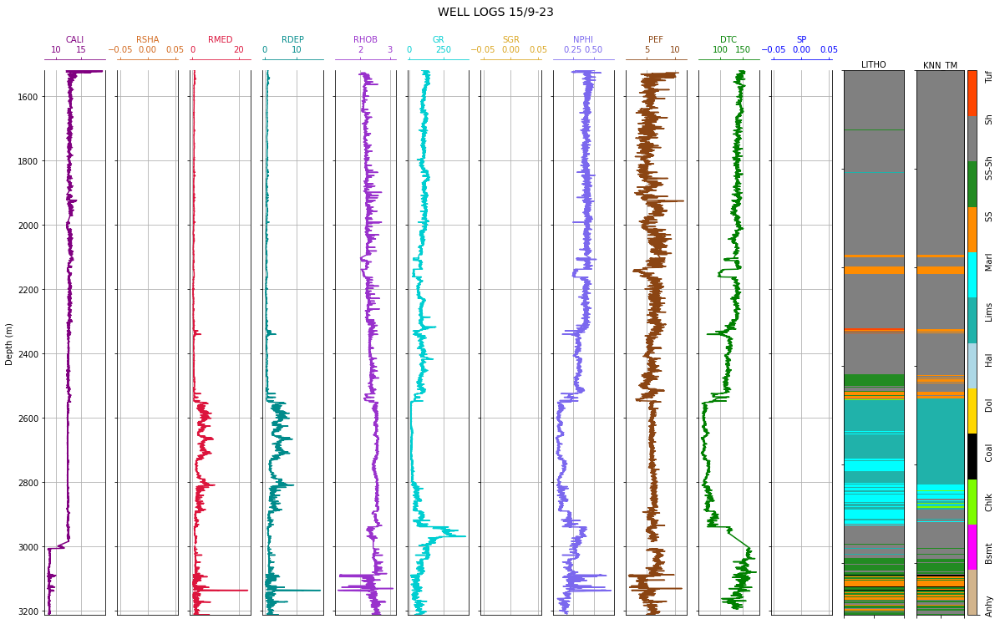

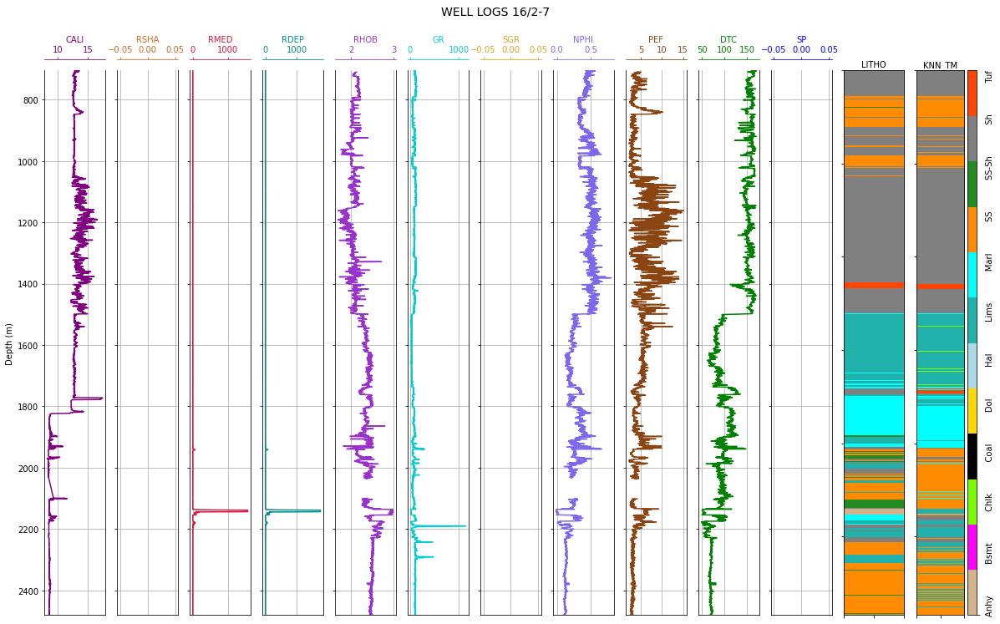

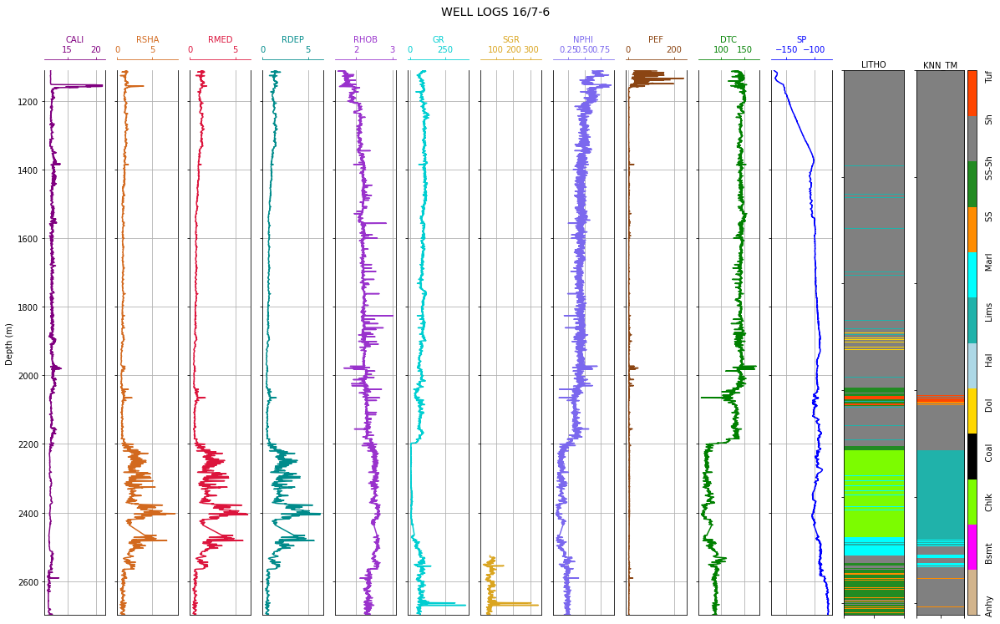

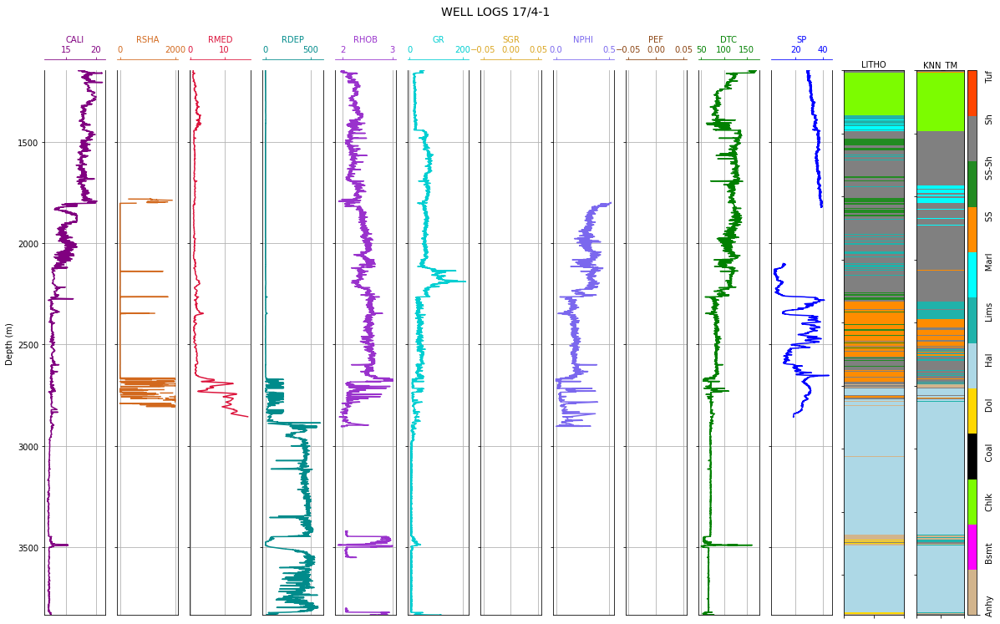

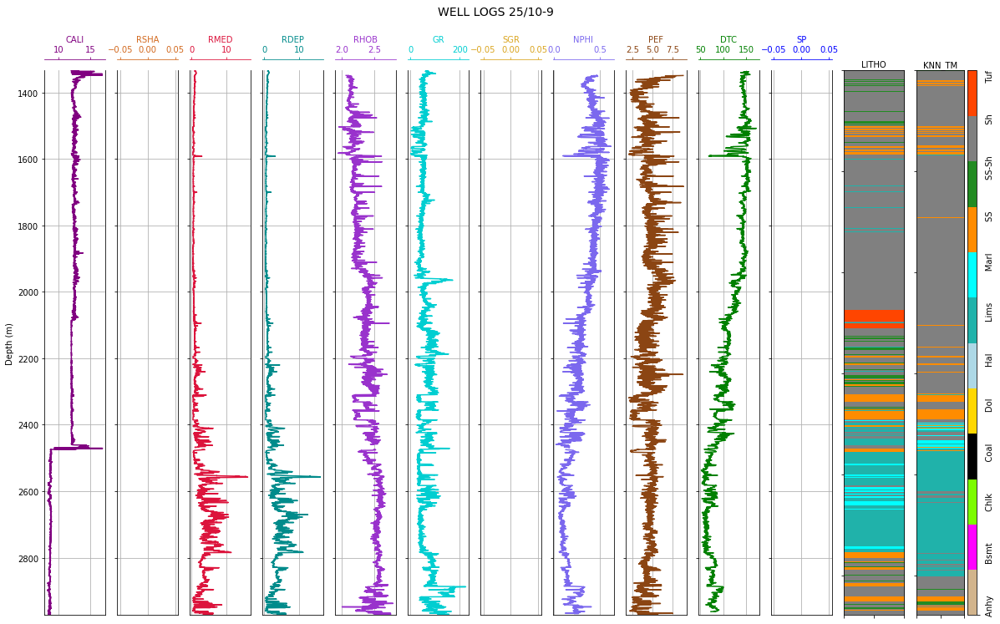

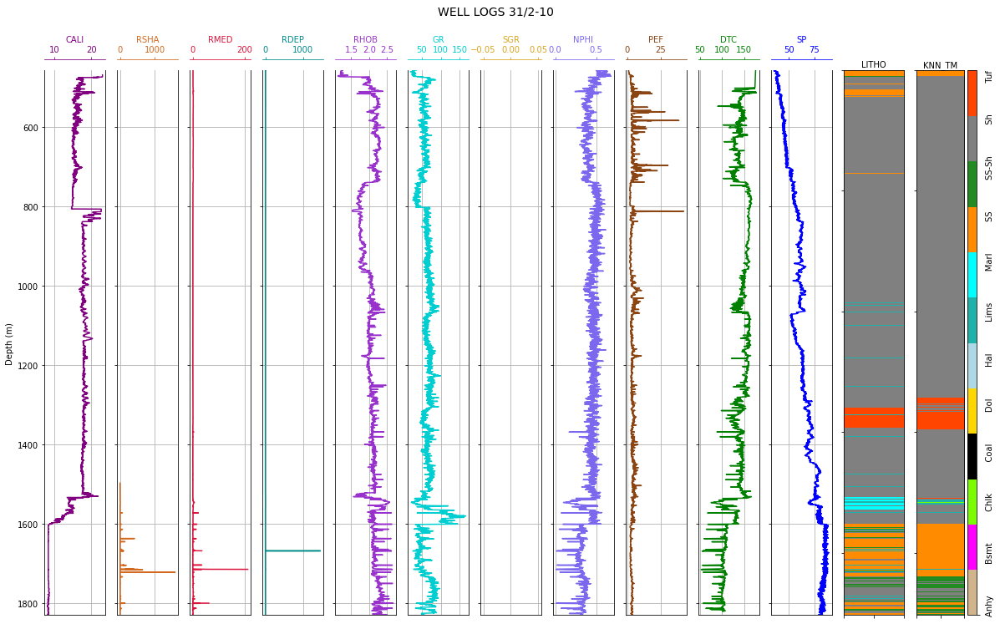

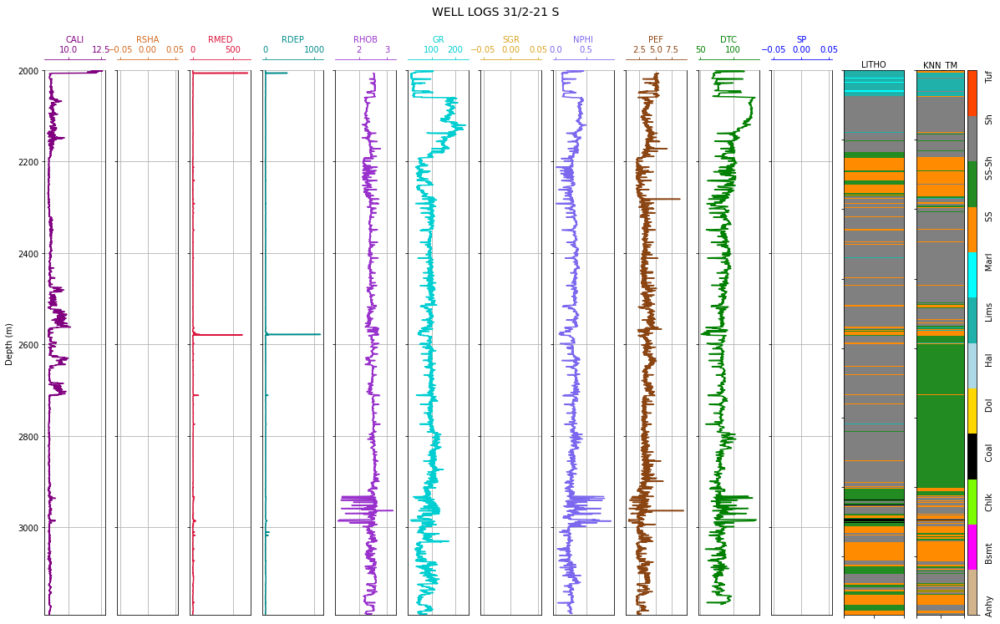

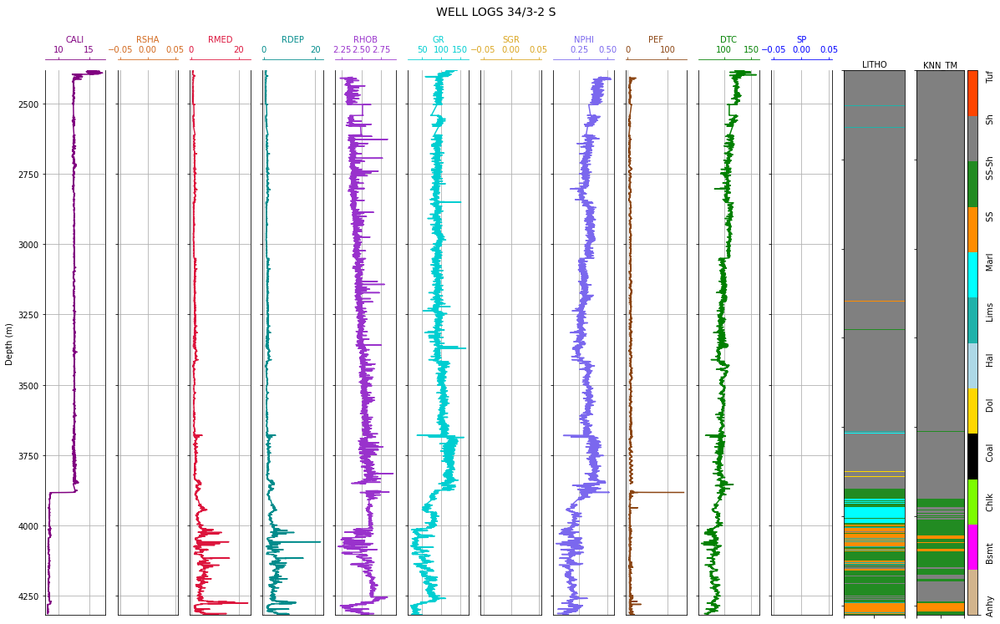

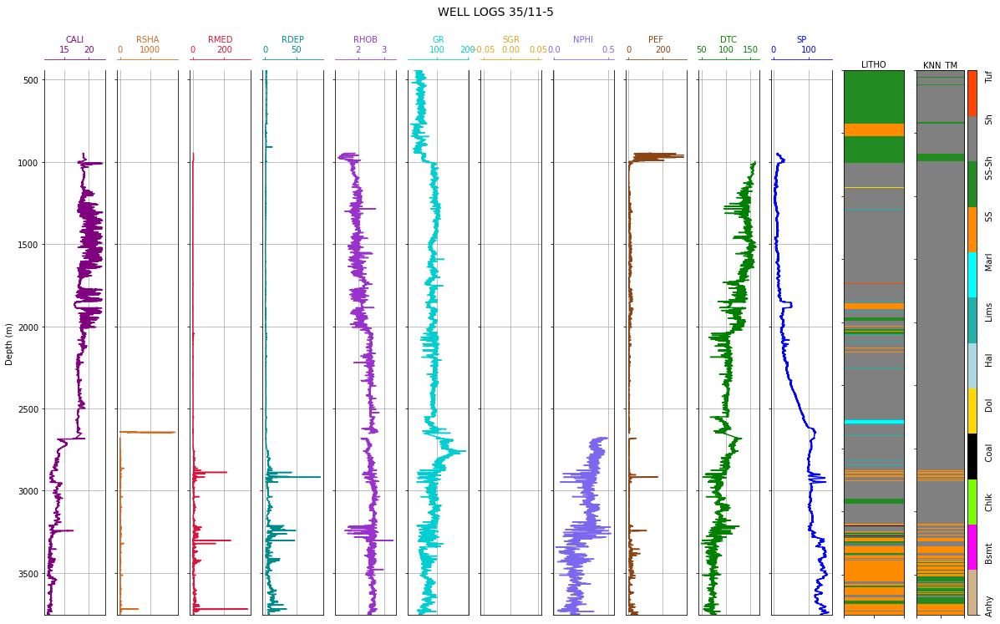

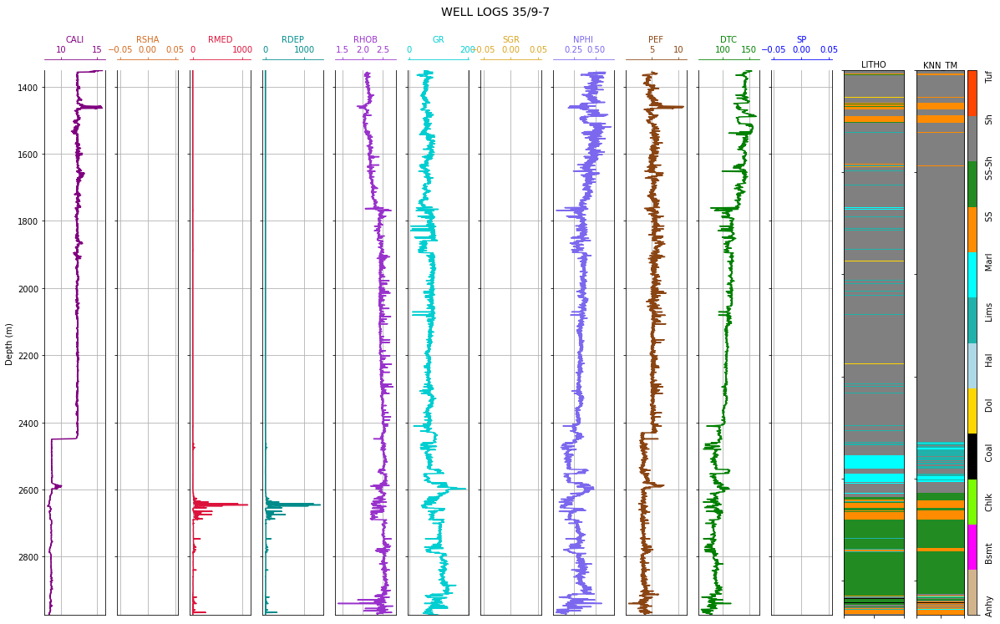

time: 33.2 s (started: 2022-11-11 11:03:27 +00:00)


In [ ]:
for i in range(0, 10):
  litho_prediction(hidden_knn_res, i, 1, le)

###  $\color{blue}{\text{3. SUPPORT VECTOR MACHINES (SVM)}}$

In [ ]:
train_pred_svm, test_pred_svm, hidden_pred_svm = run_SVM(train_scaled, test_scaled, hidden_scaled)

time: 2h 2min 59s (started: 2022-11-12 06:25:55 +00:00)


-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.6101558861736808
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: ['Dol']


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

        Anhy       0.90      0.17      0.29       597
        Chlk       0.63      0.47      0.54      2905
        Coal       0.88      0.50      0.64       244
         Dol       0.00      0.00      0.00       287
         Hal       0.99      0.99      0.99      6498
        Lims       0.58      0.64      0.61      8374
        Marl       0.16      0.27      0.20      4396
          SS       0.70      0.79      0.74     14045
       SS-Sh       0.44      0.29      0.35     12283
          Sh       0.86      0.86      0.86     71827
         Tuf       0.53      0.45      0.49       941

    accuracy                           0.75    122397
   macro avg       0.61      0.49      0.52    122397
weighted avg       0.75      0.75      0.75    122397

None


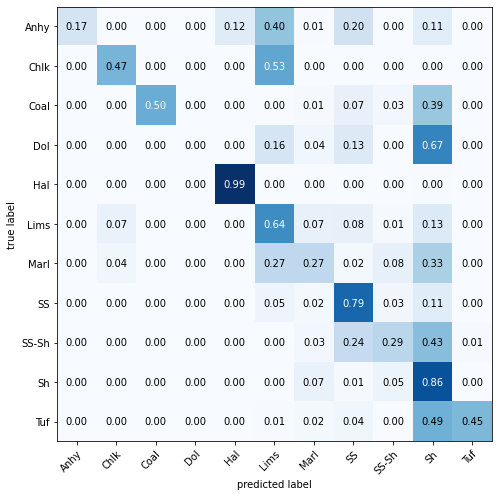

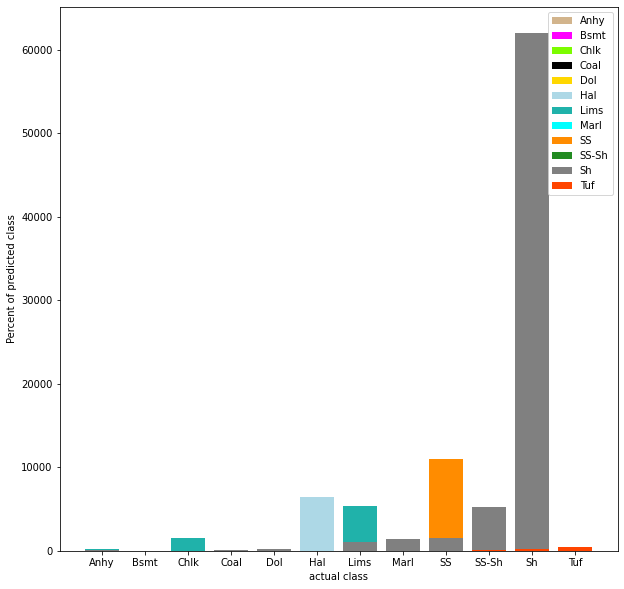

time: 2.36 s (started: 2022-11-12 08:39:47 +00:00)


In [ ]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_svm))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_svm, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_svm, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_svm, le)

In [ ]:
train_svm_res = training_form.copy()
test_svm_res = test_form.copy()
hidden_svm_res = hidden_form.copy()

train_svm_res['SVM_TM'] = train_pred_svm
test_svm_res['SVM_TM'] = test_pred_svm
hidden_svm_res['SVM_TM'] = hidden_pred_svm

time: 221 ms (started: 2022-11-12 08:39:50 +00:00)


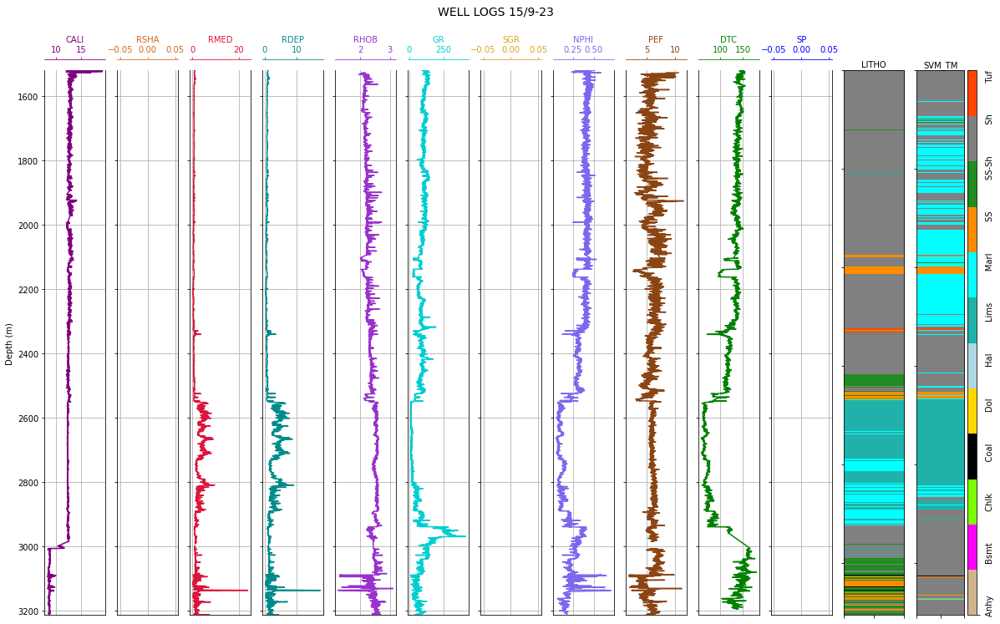

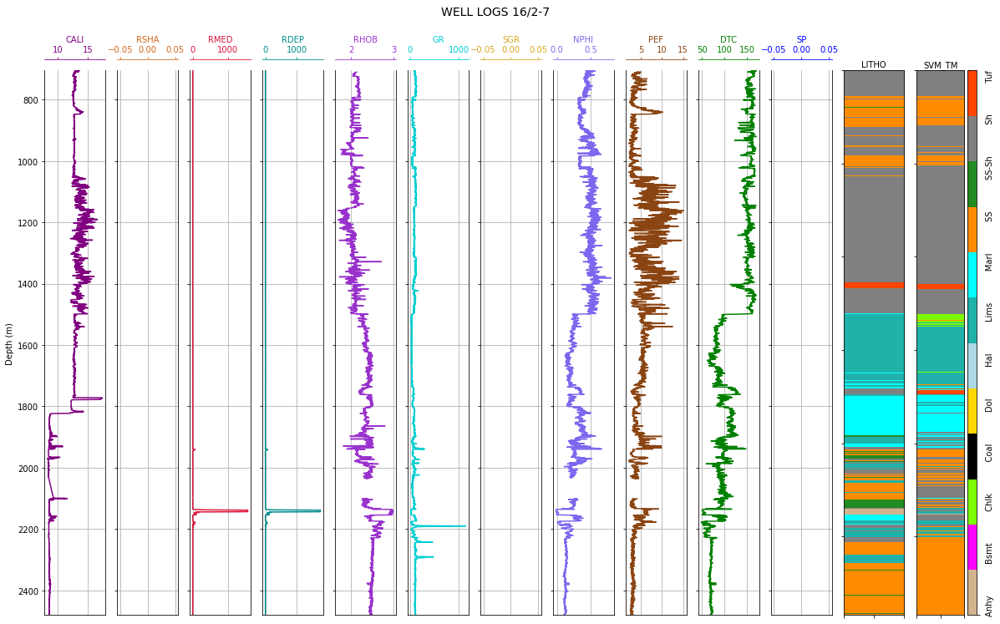

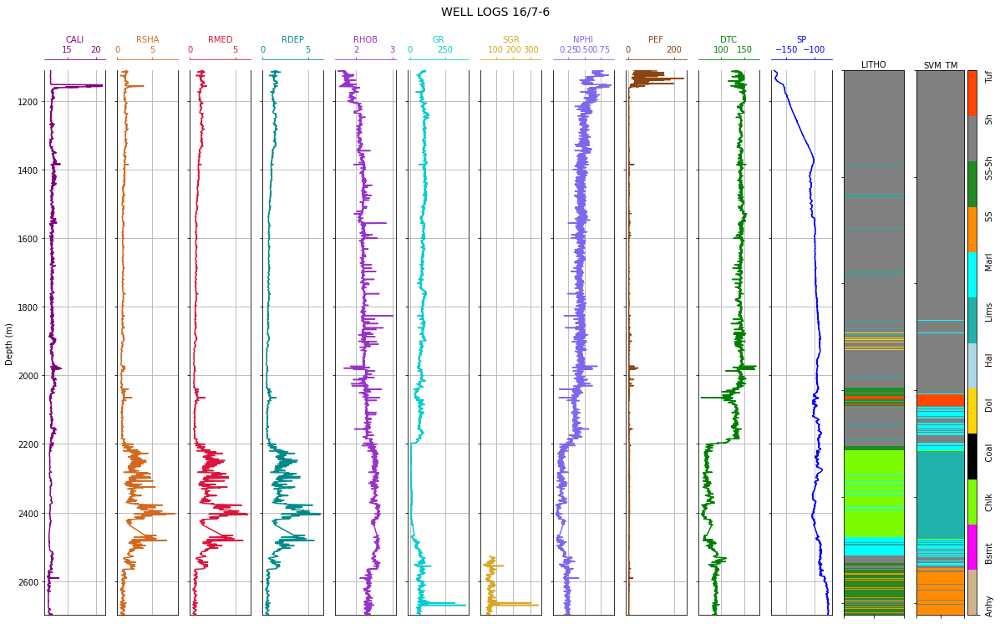

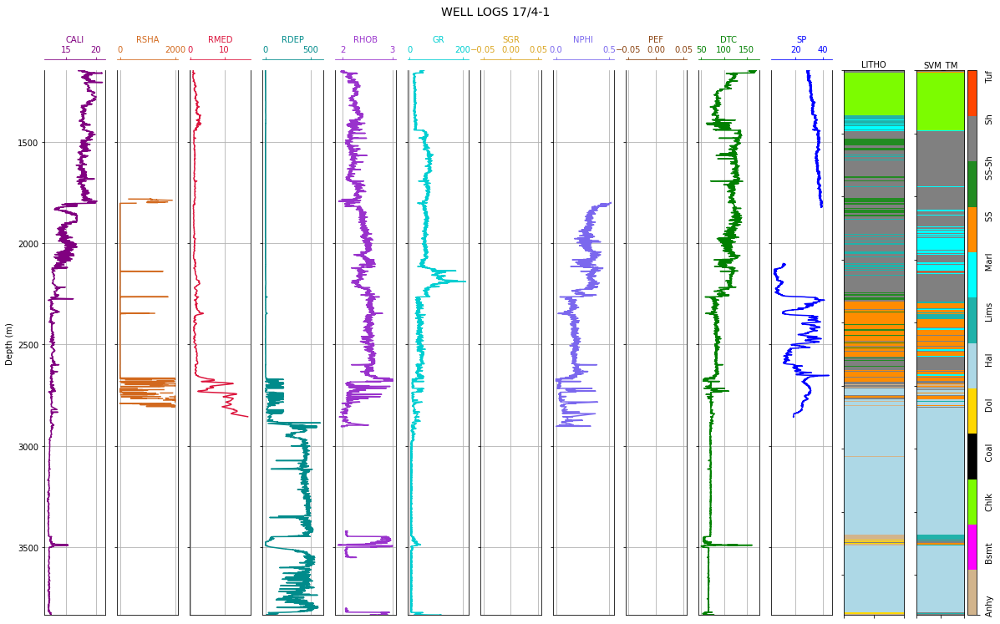

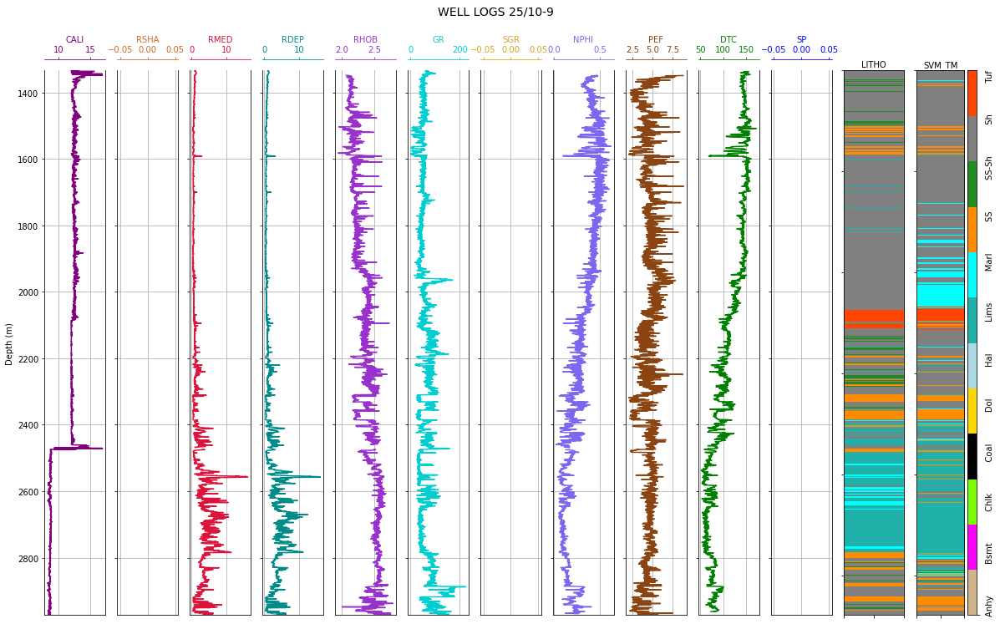

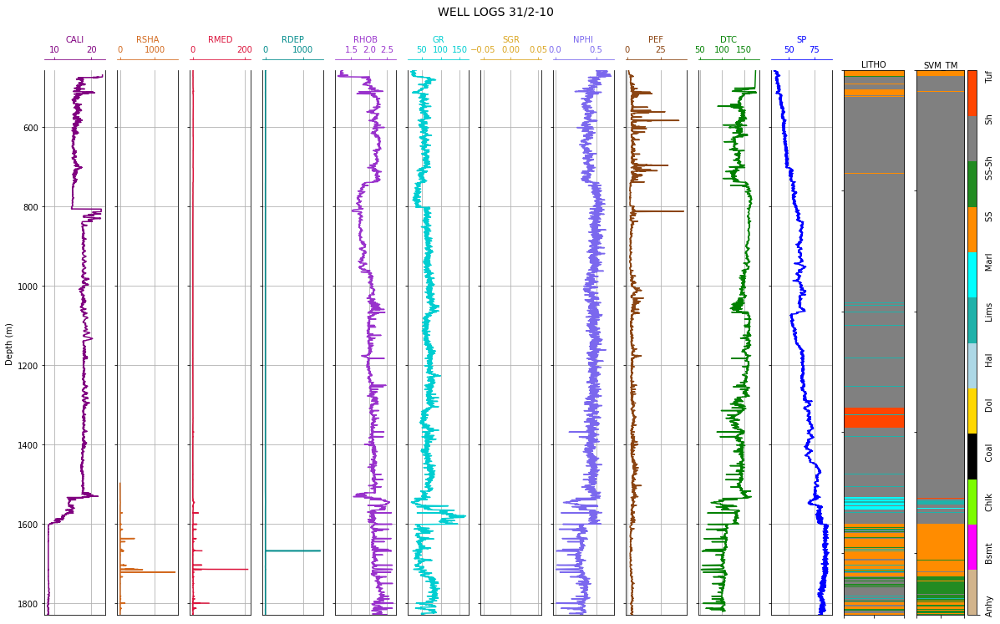

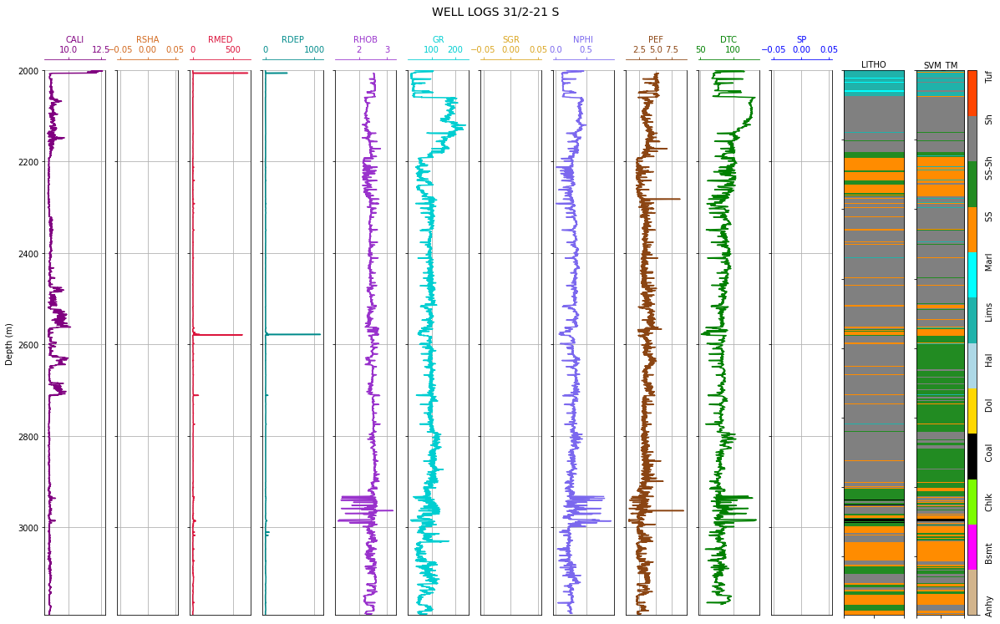

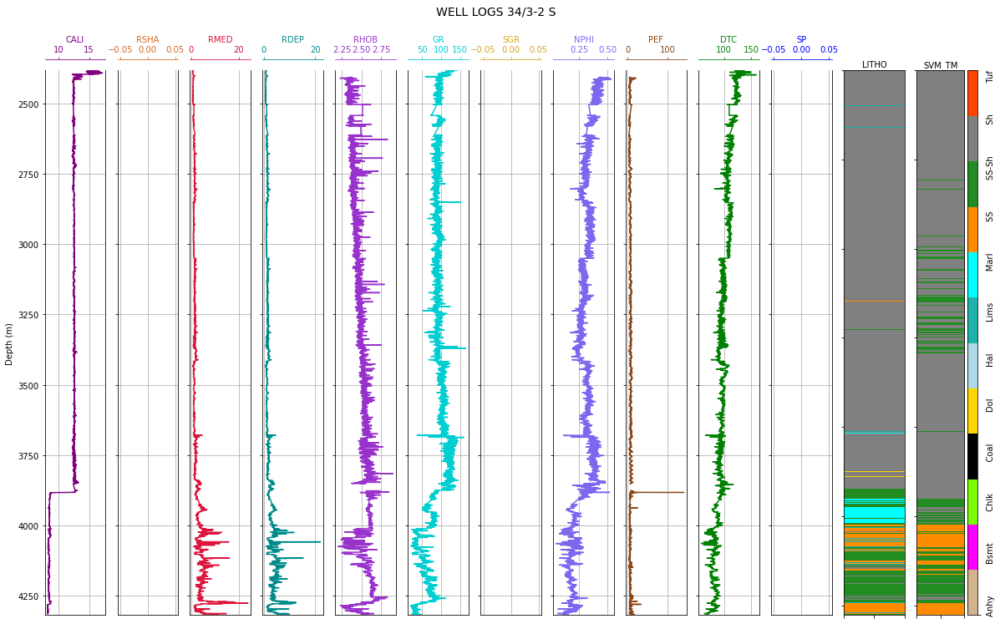

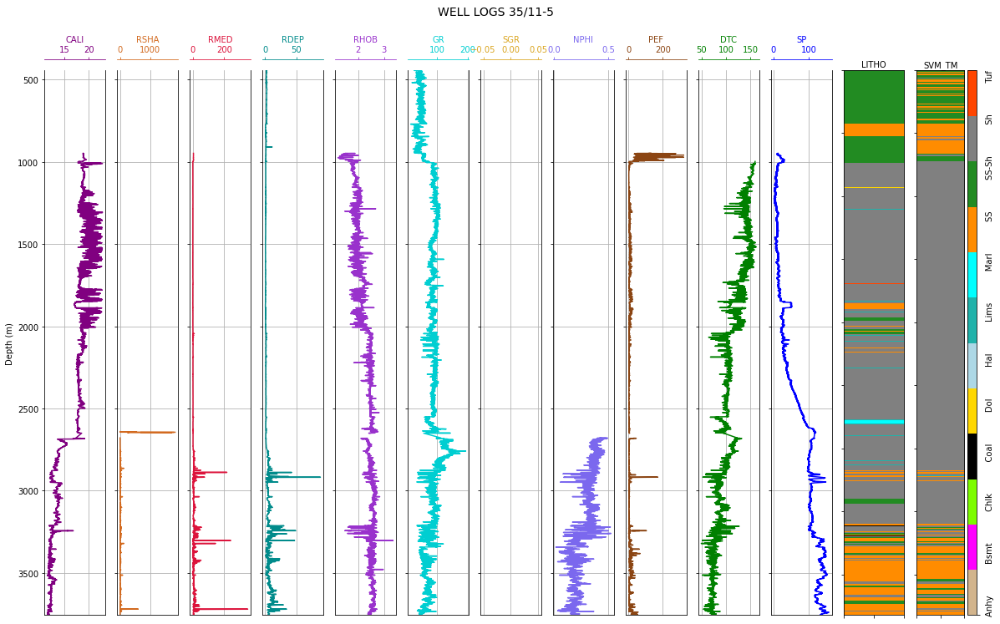

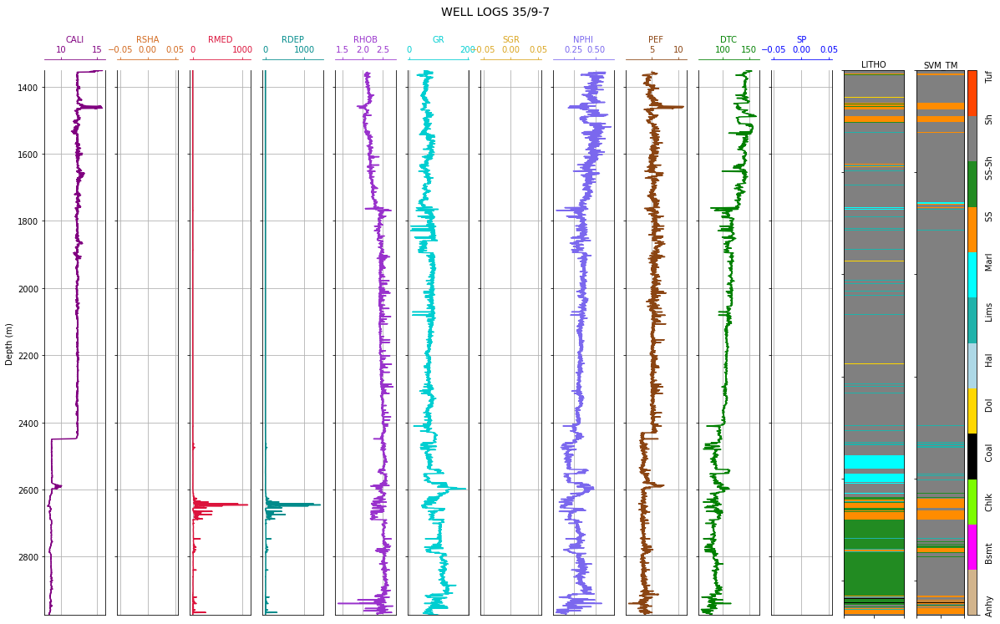

time: 1min 8s (started: 2022-11-12 08:39:50 +00:00)


In [ ]:
for i in range(0, 10):
  litho_prediction(hidden_svm_res, i, 1, le)

###  $\color{blue}{\text{4. DECISION TREES}}$

In [22]:
train_pred_dt, open_pred_dt, hidden_pred_dt = run_DT(train_scaled, test_scaled, hidden_scaled)

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.9281303871826924
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh']
Not exist in l1 or l2: ['Anhy' 'Chlk' 'Coal' 'Dol' 'Tuf']
              precision    recall  f1-score   support

        Anhy       0.00      0.00      0.00       597
        Chlk       0.00      0.00      0.00      2905
        Coal       0.00      0.00      0.00       244
         Dol       0.00      0.00      0.00       287
         Hal       0.87      1.00      0.93      6498
        Lims       0.35      0.22      0.27      8374
        Marl       0.06      0.04      0.05      4396
          SS       0.55      0.57      0.56     14045
       SS-Sh       0.14      0.13      0.13     12283
          Sh       0.75      0.84      0.79     71827
         Tuf       0.00      0.00      0.00       941

    accuracy 

d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


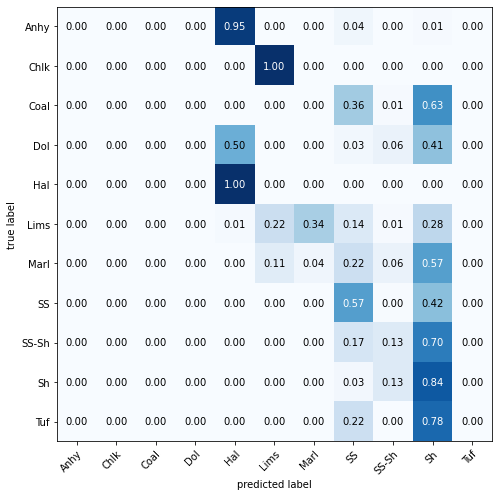

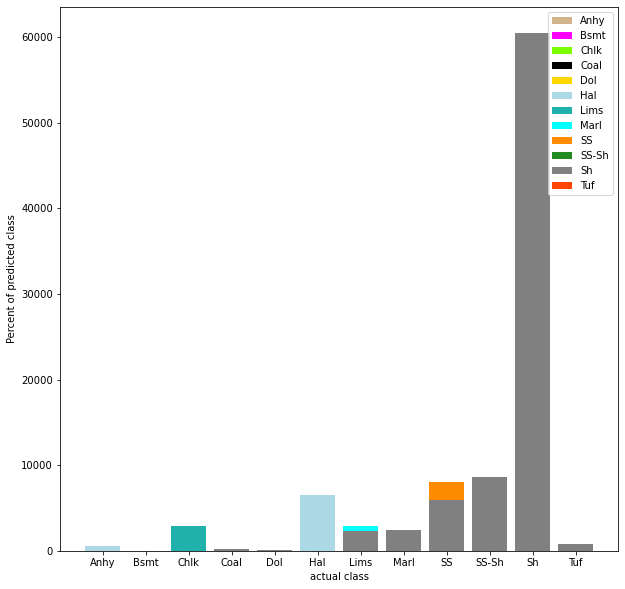

In [24]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_dt))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_dt, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_dt, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_dt, le)

In [25]:
train_dt_res = training_form.copy()
test_dt_res = test_form.copy()
hidden_dt_res = hidden_form.copy()

train_dt_res['DT_TM'] = train_pred_dt
test_dt_res['DT_TM'] = open_pred_dt
hidden_dt_res['DT_TM'] = hidden_pred_dt

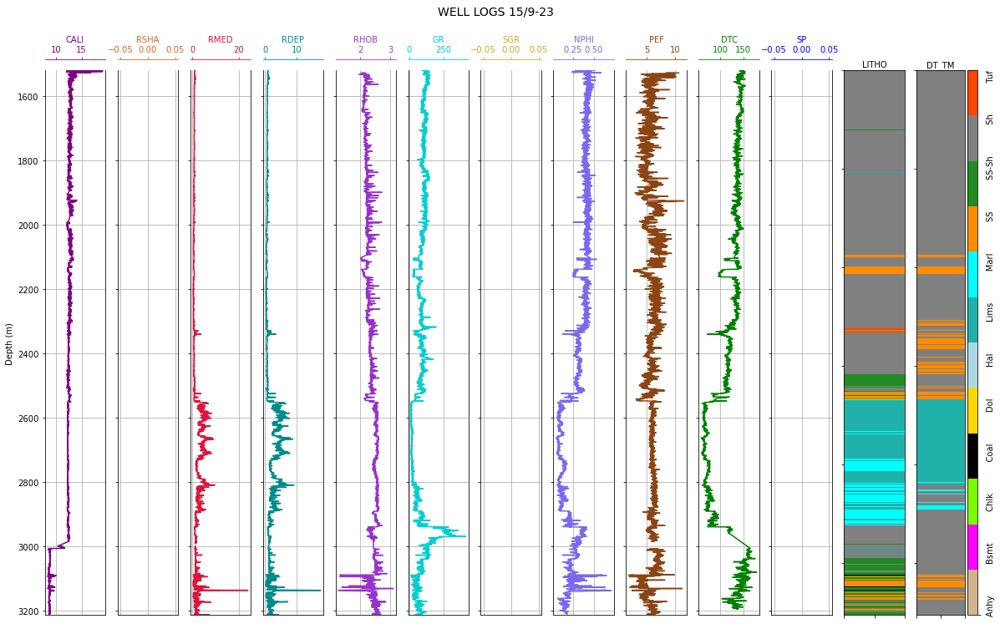

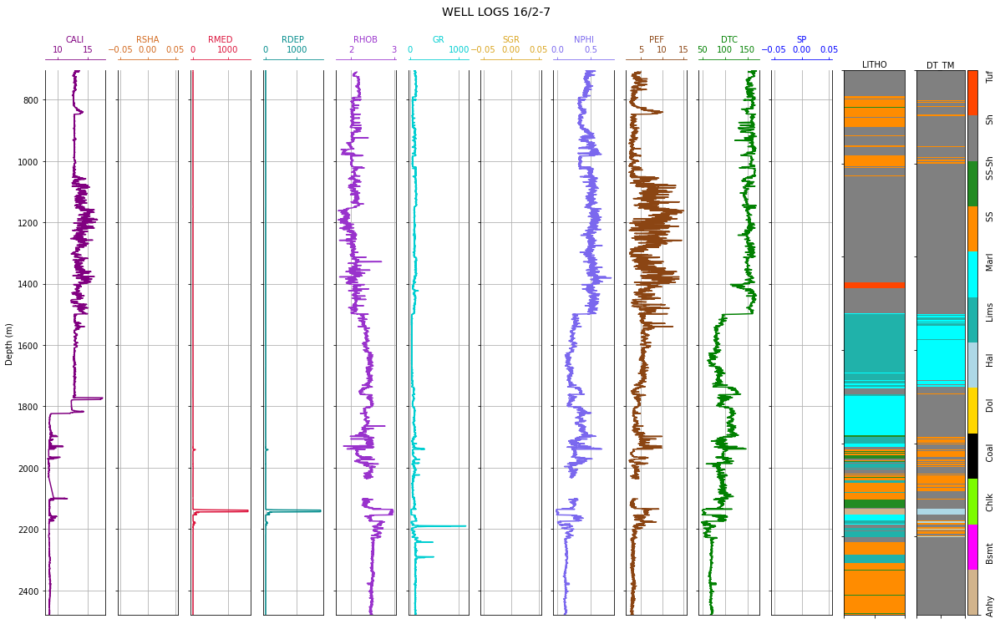

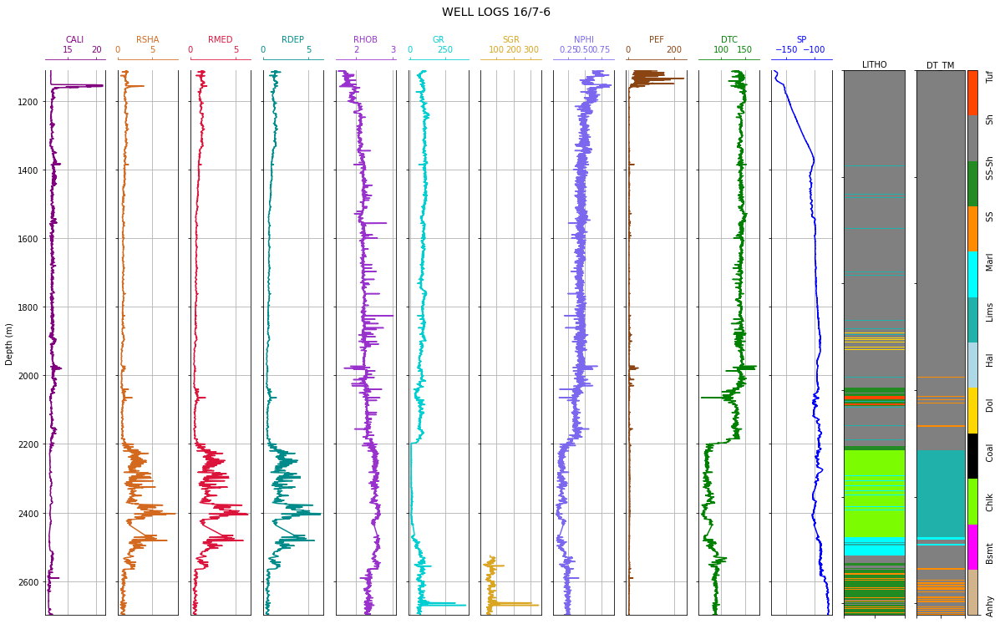

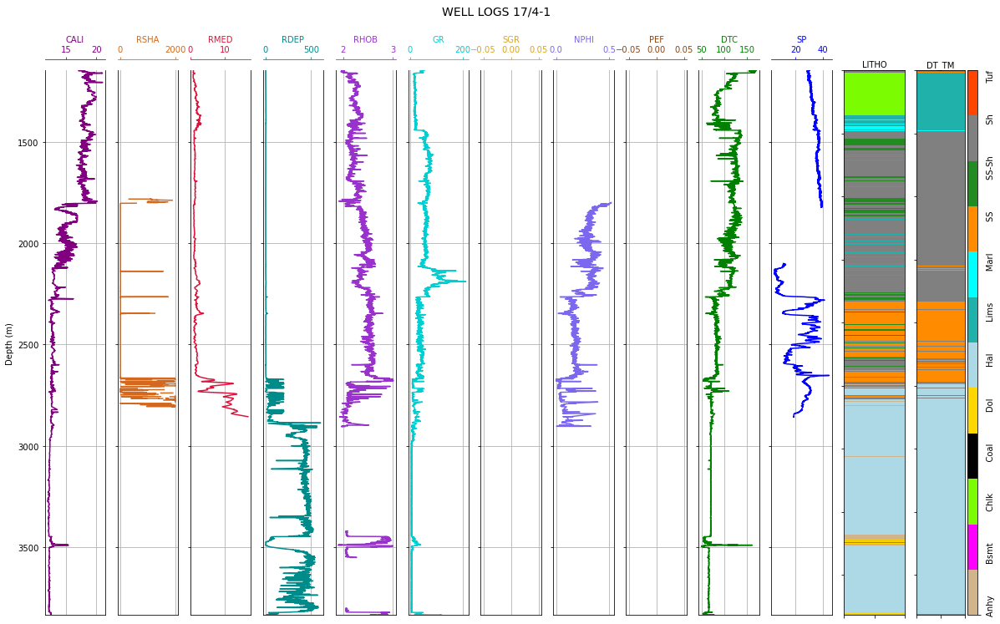

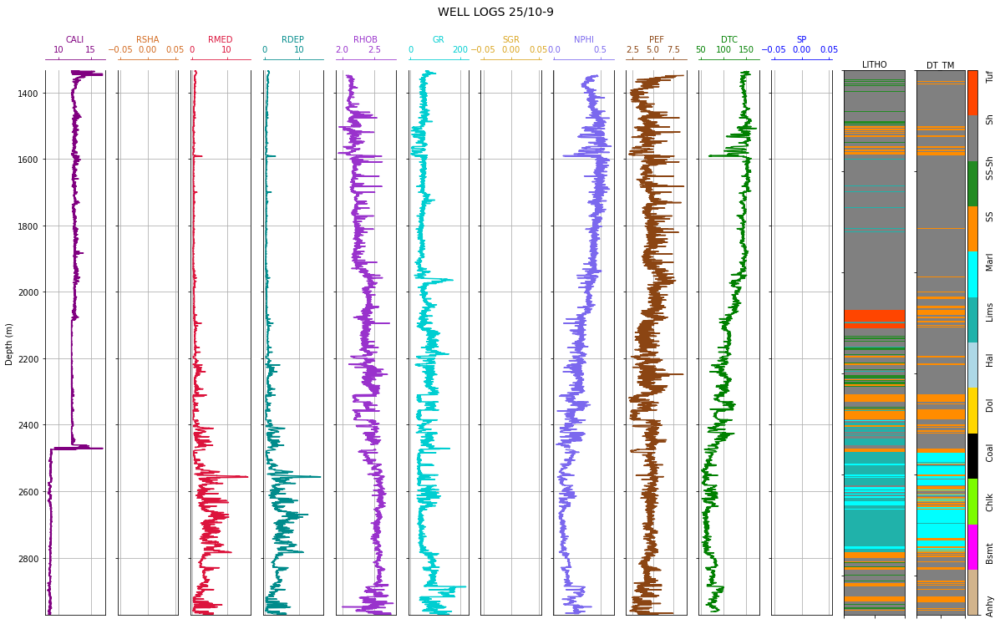

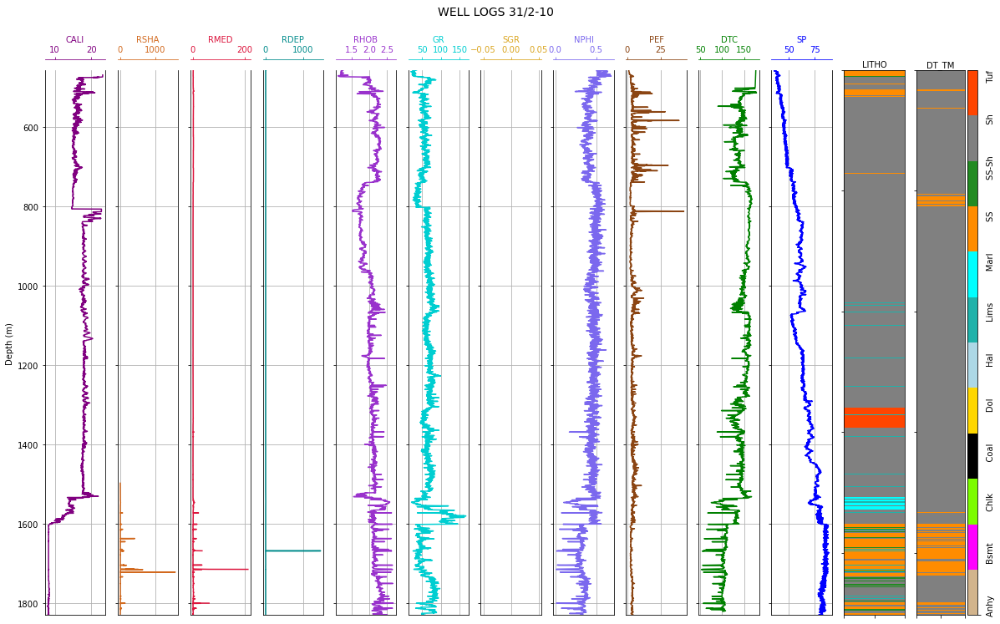

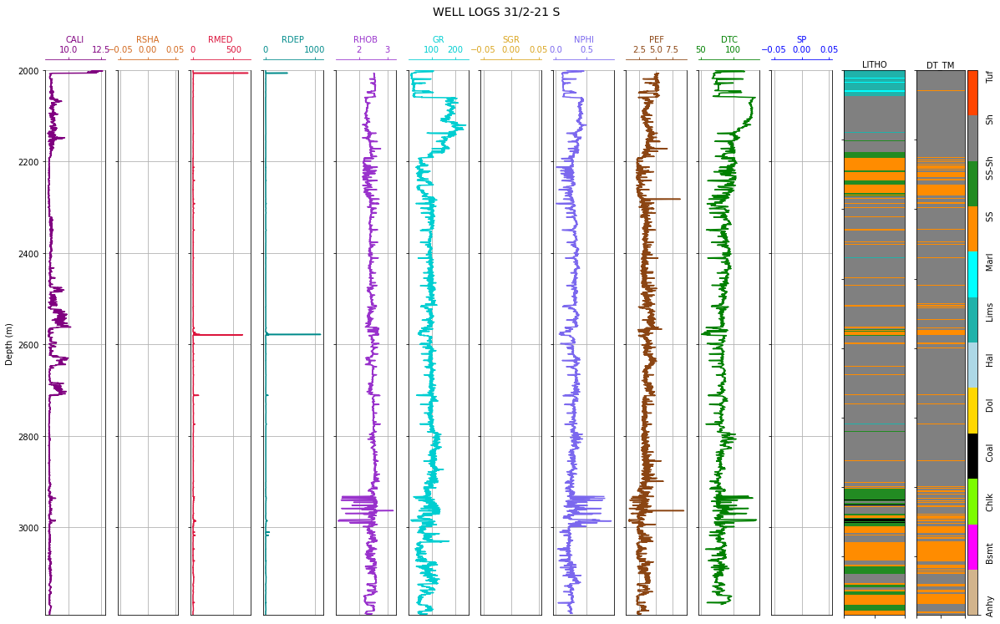

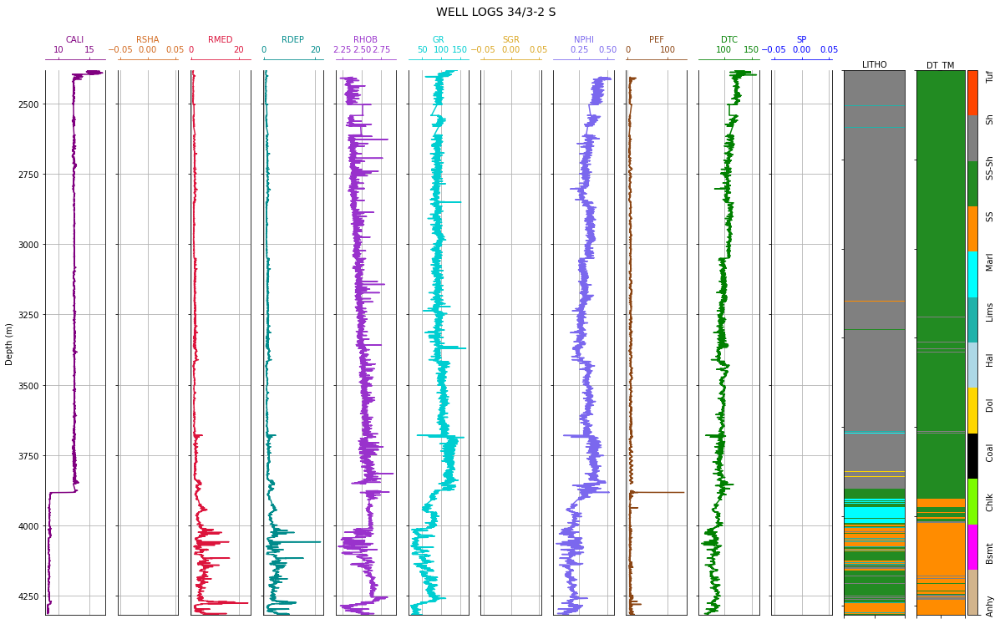

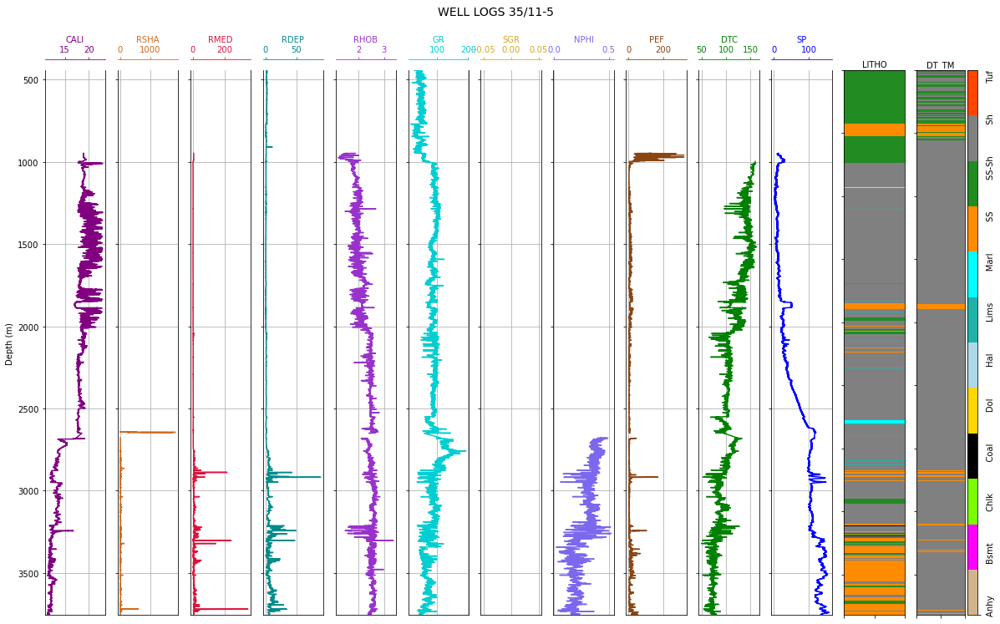

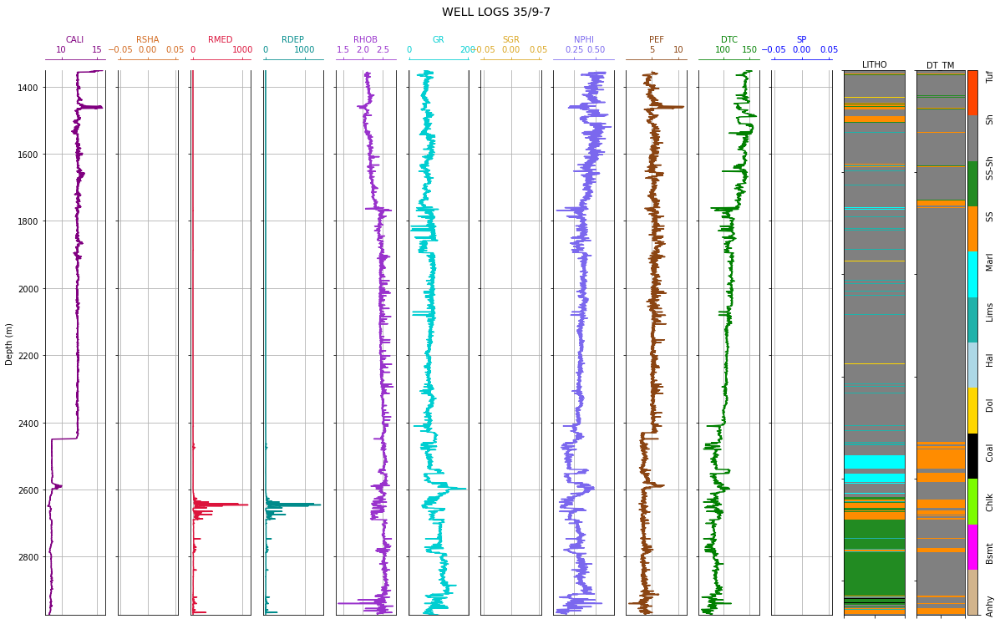

In [26]:
for i in range(0, 10):
  litho_prediction(hidden_dt_res, i, 1, le)

###  $\color{blue}{\text{5. RANDOM FOREST}}$

In [25]:
train_pred_rf, open_pred_rf, hidden_pred_rf = run_RF(train_scaled, test_scaled, hidden_scaled)

C:\Users\esfahani\AppData\Local\Temp\ipykernel_9612\262188879.py:39: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(class_names)
C:\Users\esfahani\AppData\Local\Temp\ipykernel_9612\262188879.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(labels)


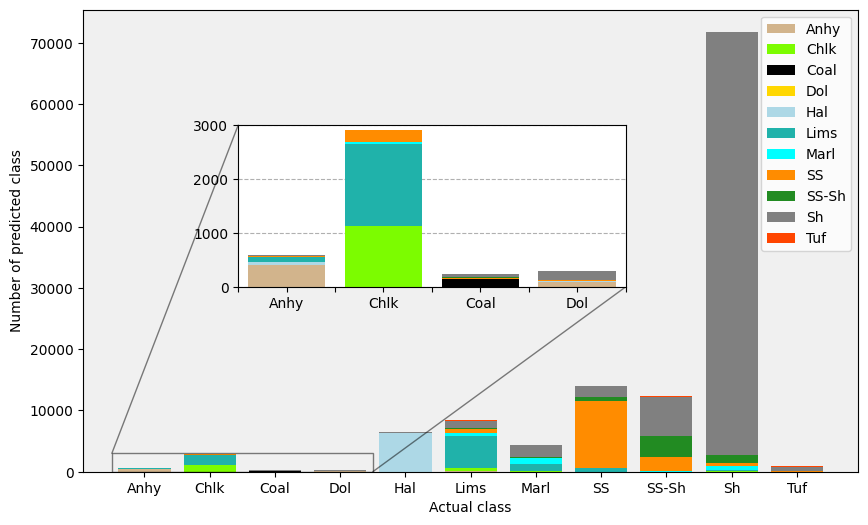

In [26]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

y_true = hidden_scaled.LITHO.values
y_pred = hidden_pred_rf

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_names = np.array(['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS',
       'SS-Sh', 'Sh', 'Tuf'], dtype=object)
colors = ['tan', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']

support = np.sum(cm, axis=1)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(len(class_names)):
    ax.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
plt.xticks(range(len(support)), [class_names[i] for i in range(len(support))])
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')

# Display
ax.set_facecolor('#f0f0f0')

ax_zoom = ax.inset_axes([0.2, 0.4, 0.5, 0.35])

for i in range(len(class_names)):
    ax_zoom.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
ax_zoom.set_xticklabels(class_names)
labels = [item.get_text() for item in ax_zoom.get_xticklabels()]
labels[0] = ''; labels[1] = 'Anhy'; labels[2] = ''; labels[3] = 'Chlk'; labels[4] = ''; labels[5] = 'Coal'
labels[6] = ''; labels[7] = 'Dol'
ax_zoom.set_xticklabels(labels)

ax_zoom.set_xlim(-0.5, 3.5)
ax_zoom.set_ylim(0, 3000)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")


ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')
ax.legend(fontsize="10", loc ="upper right")

plt.savefig('randomforest.pdf')
plt.show()


-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.5155927024355172
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.77      0.70      0.73       597
        Chlk       0.58      0.39      0.46      2905
        Coal       0.88      0.62      0.73       244
         Dol       0.73      0.08      0.15       287
         Hal       0.99      0.98      0.99      6498
        Lims       0.59      0.62      0.61      8374
        Marl       0.39      0.24      0.29      4396
          SS       0.77      0.78      0.77     14045
       SS-Sh       0.55      0.24      0.33     12283
          Sh       0.84      0.95      0.89     71827
         Tuf       0.67      0.26      0.38       941

    acc

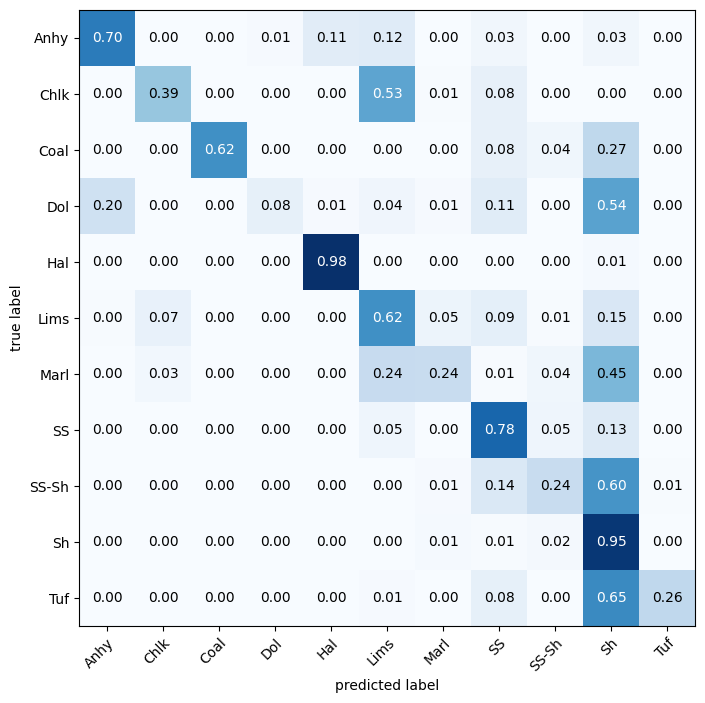

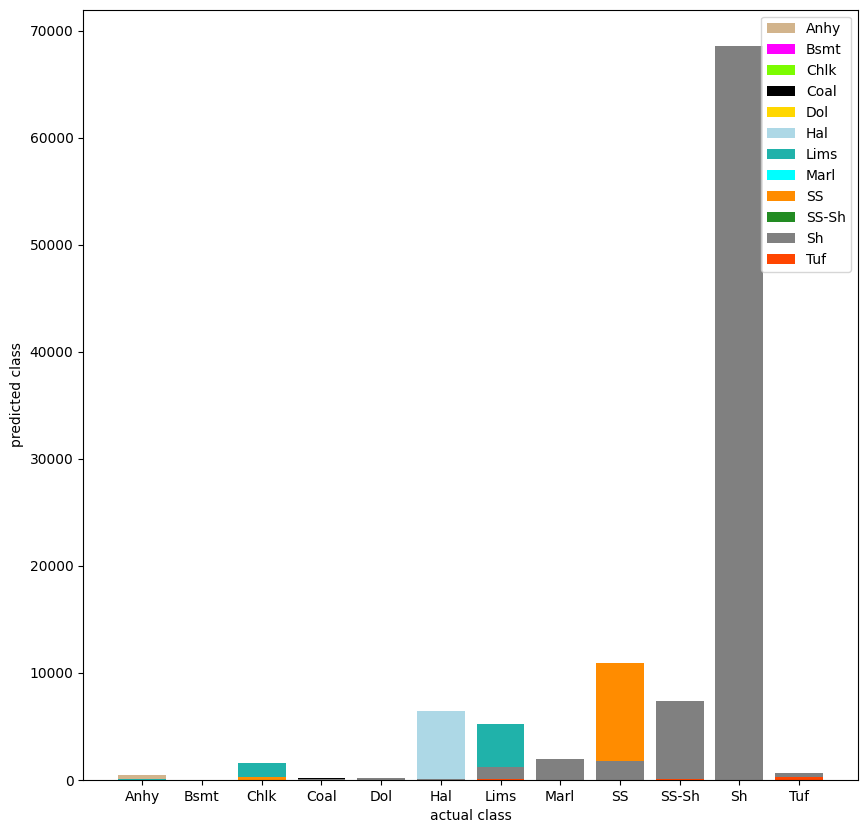

In [30]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_rf))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_rf, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_rf, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_rf, le)

In [27]:
train_rf_res = training_form.copy()
test_rf_res = test_form.copy()
hidden_rf_res = hidden_form.copy()

train_rf_res['RF_TM'] = train_pred_rf
test_rf_res['RF_TM'] = open_pred_rf
hidden_rf_res['RF_TM'] = hidden_pred_rf

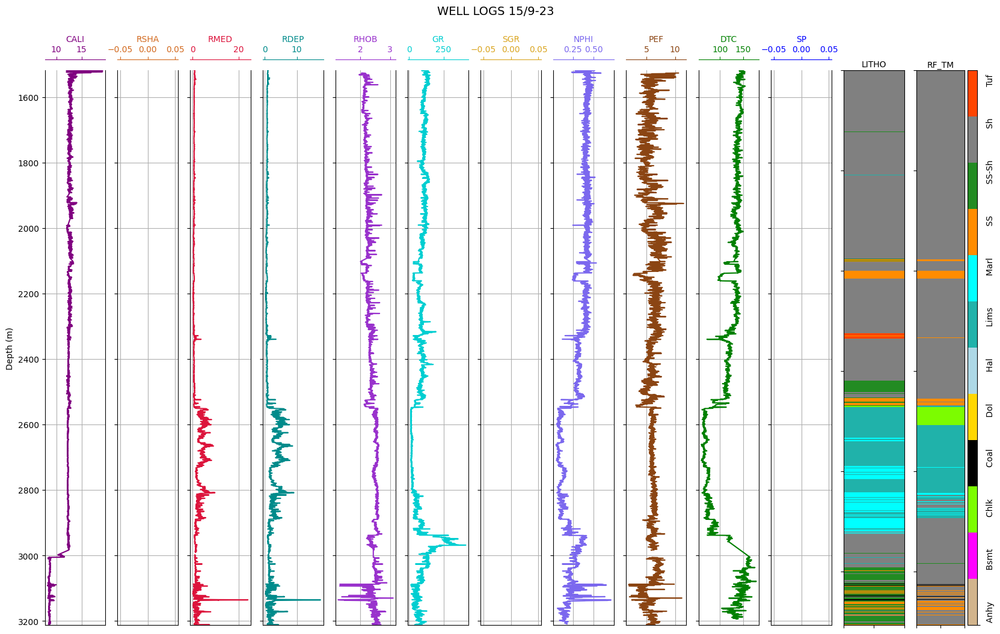

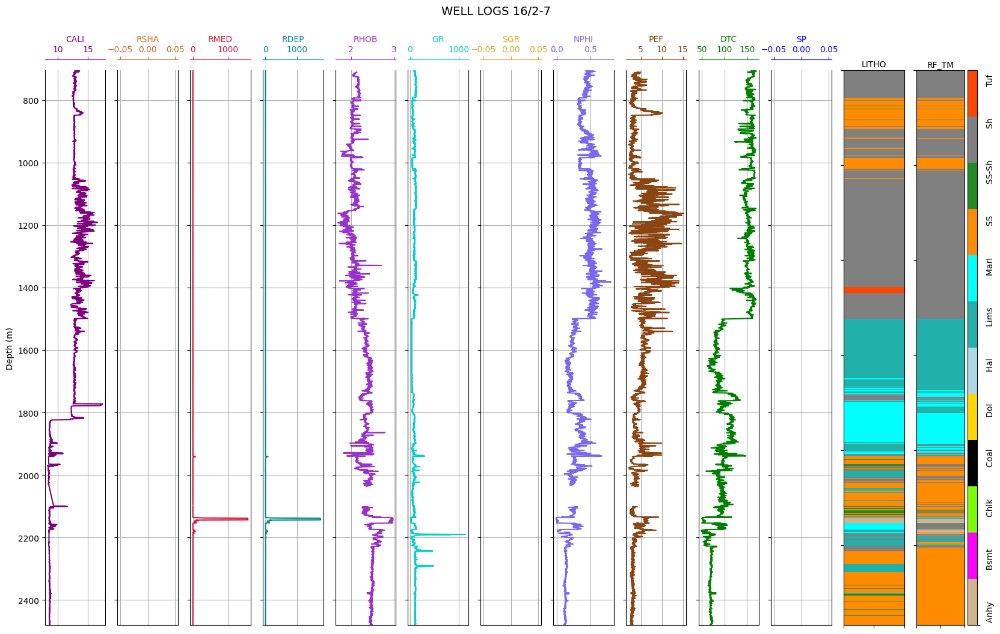

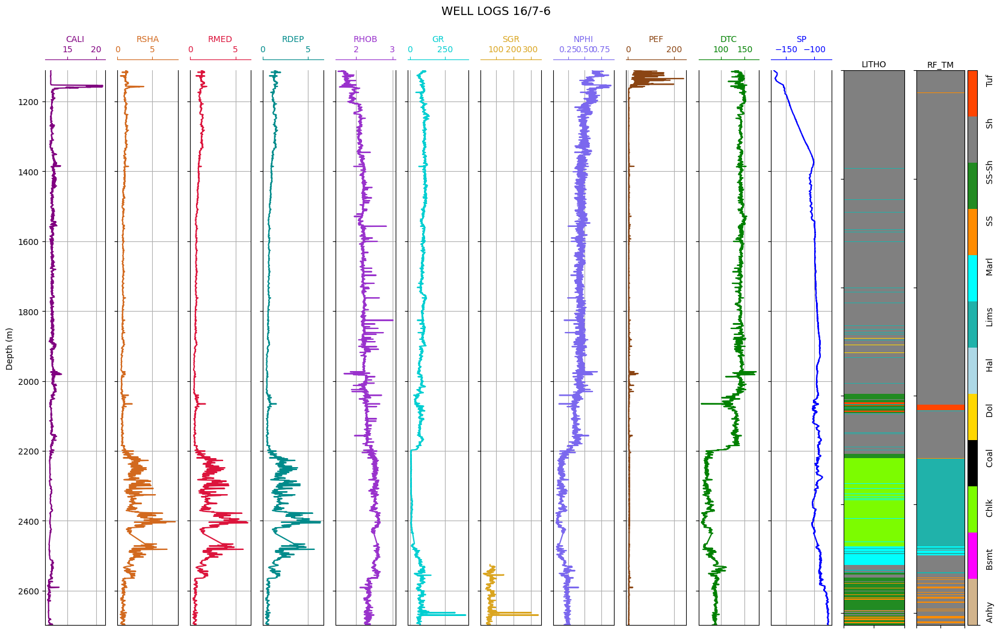

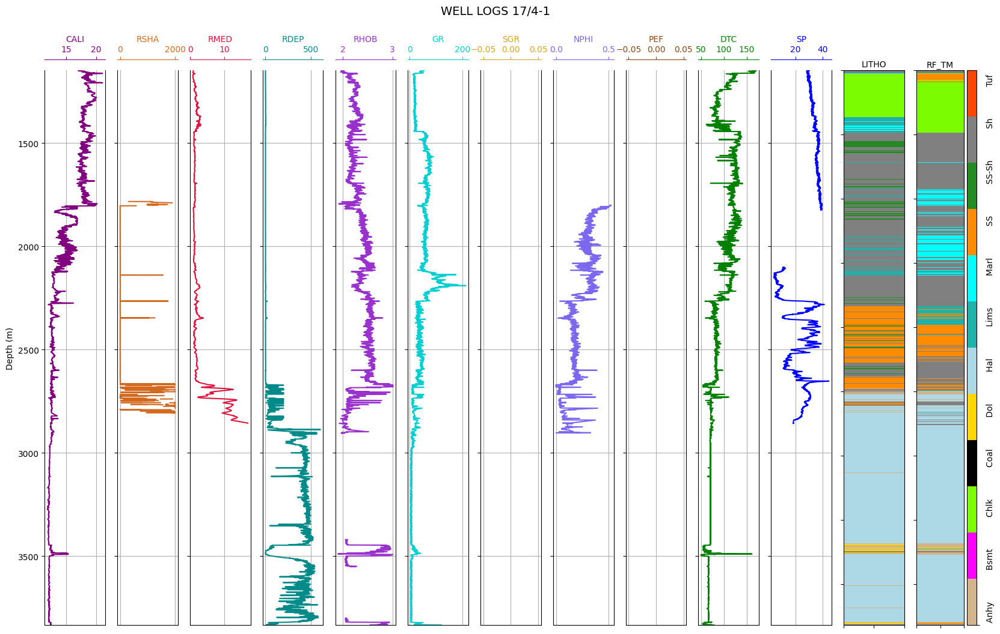

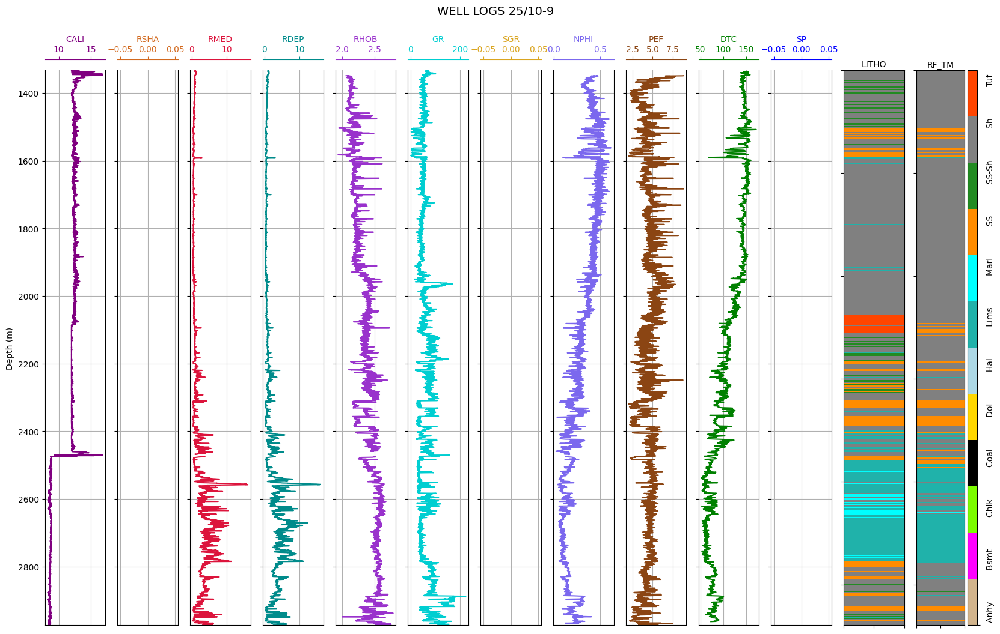

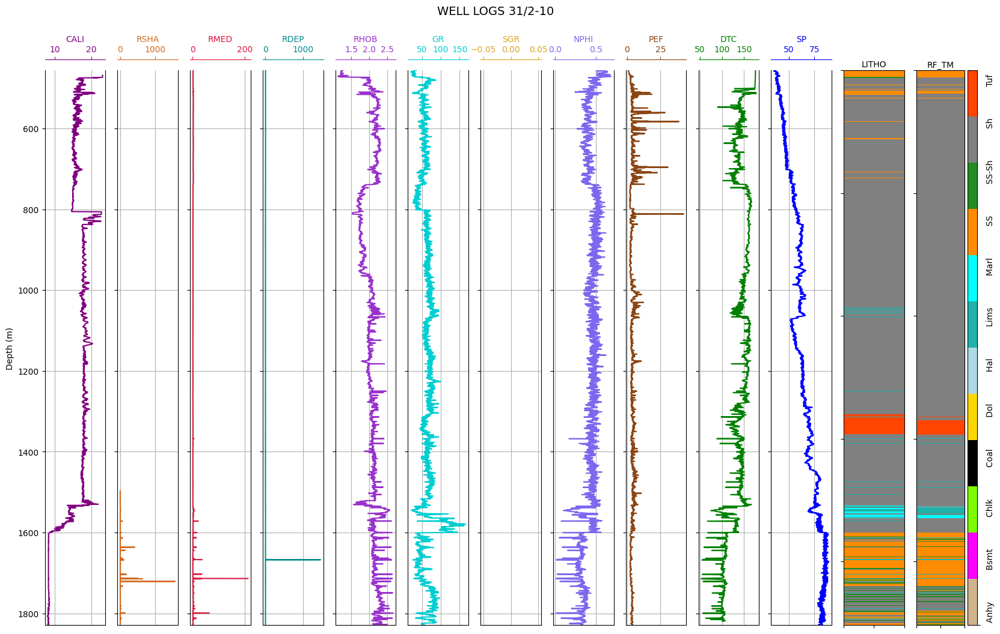

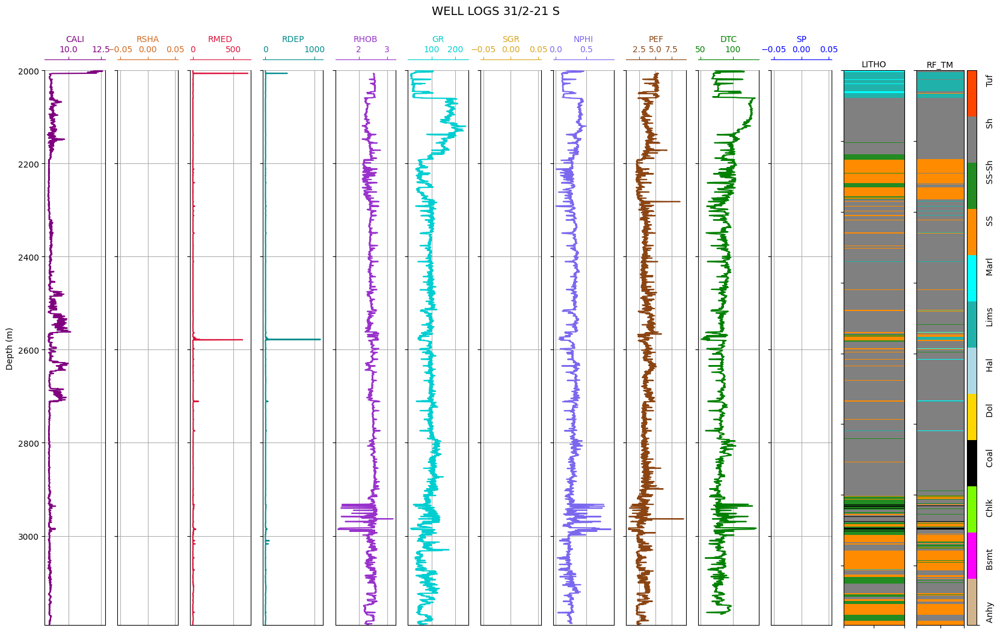

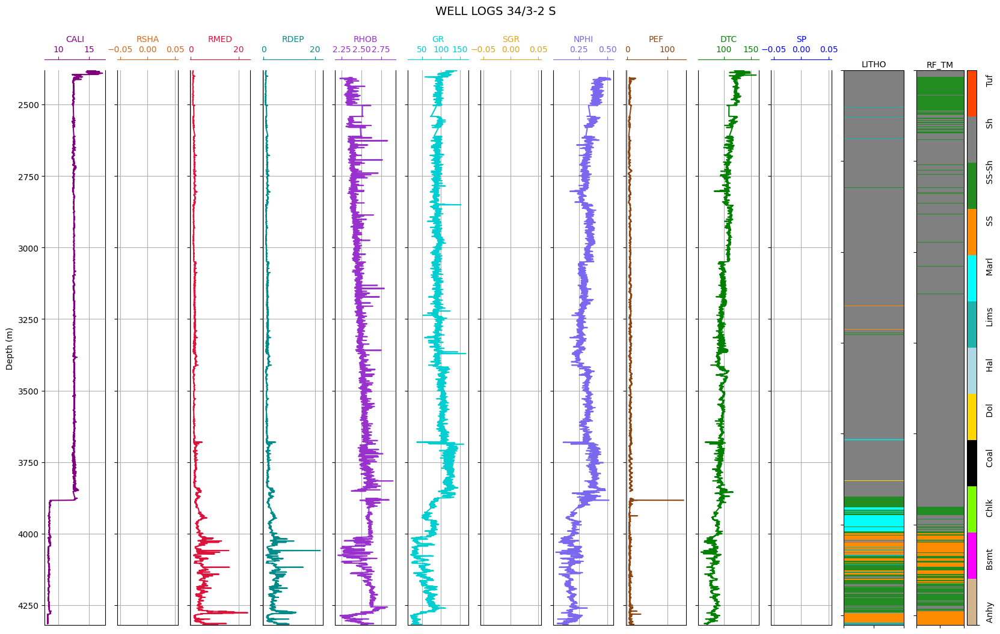

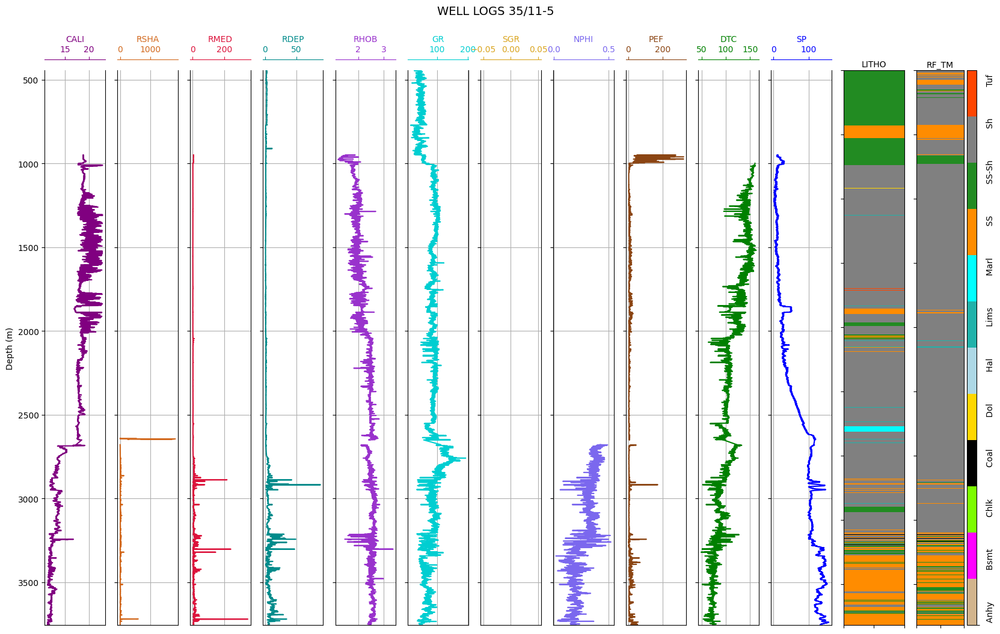

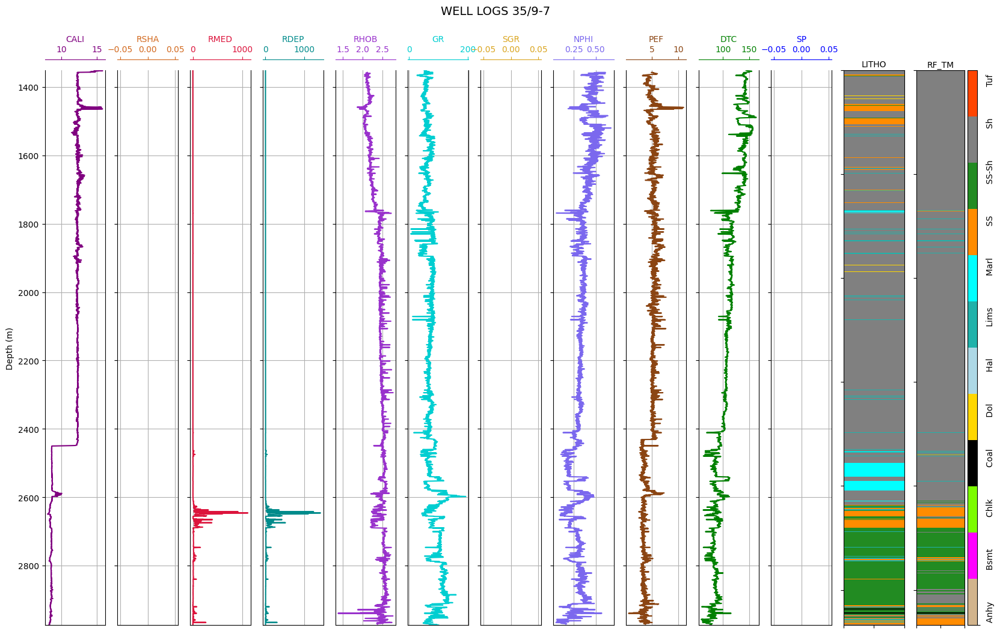

In [28]:
for i in range(0, 10):
  litho_prediction(hidden_rf_res, i, 1, le)

###  $\color{blue}{\text{6. CATEGORICAL GRADIENT BOOSTING MODEL (CATBOOST)}}$

In [23]:
train_pred_cat, test_pred_cat, hidden_pred_cat = run_CatBoost(train_scaled, test_scaled, hidden_scaled)

0:	learn: 1.9698121	test: 1.9691122	best: 1.9691122 (0)	total: 509ms	remaining: 8m 28s
100:	learn: 0.5235278	test: 0.5239203	best: 0.5239203 (100)	total: 10.3s	remaining: 1m 31s
200:	learn: 0.4482410	test: 0.4490066	best: 0.4490066 (200)	total: 20s	remaining: 1m 19s
300:	learn: 0.4116236	test: 0.4127281	best: 0.4127281 (300)	total: 29.6s	remaining: 1m 8s
400:	learn: 0.3879582	test: 0.3892596	best: 0.3892596 (400)	total: 39.4s	remaining: 58.8s
500:	learn: 0.3704786	test: 0.3721079	best: 0.3721079 (500)	total: 49.2s	remaining: 49s
600:	learn: 0.3581892	test: 0.3600792	best: 0.3600792 (600)	total: 58.9s	remaining: 39.1s
700:	learn: 0.3475071	test: 0.3495734	best: 0.3495734 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3386391	test: 0.3408931	best: 0.3408931 (800)	total: 1m 18s	remaining: 19.5s
900:	learn: 0.3312312	test: 0.3337481	best: 0.3337481 (900)	total: 1m 27s	remaining: 9.66s
999:	learn: 0.3245882	test: 0.3273200	best: 0.3273200 (999)	total: 1m 37s	remaining: 0us
bestTest = 0.3

0:	learn: 1.9693856	test: 1.9697999	best: 1.9697999 (0)	total: 165ms	remaining: 2m 44s
100:	learn: 0.5212203	test: 0.5219893	best: 0.5219893 (100)	total: 10s	remaining: 1m 29s
200:	learn: 0.4473087	test: 0.4482041	best: 0.4482041 (200)	total: 19.7s	remaining: 1m 18s
300:	learn: 0.4119557	test: 0.4130033	best: 0.4130033 (300)	total: 29.4s	remaining: 1m 8s
400:	learn: 0.3885626	test: 0.3898712	best: 0.3898712 (400)	total: 39.1s	remaining: 58.4s
500:	learn: 0.3724966	test: 0.3739283	best: 0.3739283 (500)	total: 48.8s	remaining: 48.6s
600:	learn: 0.3586222	test: 0.3602090	best: 0.3602090 (600)	total: 58.5s	remaining: 38.8s
700:	learn: 0.3476733	test: 0.3494068	best: 0.3494068 (700)	total: 1m 8s	remaining: 29.1s
800:	learn: 0.3382051	test: 0.3400592	best: 0.3400592 (800)	total: 1m 17s	remaining: 19.4s
900:	learn: 0.3305640	test: 0.3326174	best: 0.3326174 (900)	total: 1m 27s	remaining: 9.63s
999:	learn: 0.3238241	test: 0.3261281	best: 0.3261281 (999)	total: 1m 37s	remaining: 0us
bestTest = 0

0:	learn: 1.9733590	test: 1.9747256	best: 1.9747256 (0)	total: 281ms	remaining: 4m 40s
100:	learn: 0.5217607	test: 0.5257917	best: 0.5257917 (100)	total: 10.1s	remaining: 1m 29s
200:	learn: 0.4496048	test: 0.4544745	best: 0.4544745 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4121589	test: 0.4175965	best: 0.4175965 (300)	total: 29.5s	remaining: 1m 8s
400:	learn: 0.3887764	test: 0.3945587	best: 0.3945587 (400)	total: 39.3s	remaining: 58.7s
500:	learn: 0.3723524	test: 0.3781942	best: 0.3781942 (500)	total: 49.1s	remaining: 48.9s
600:	learn: 0.3594408	test: 0.3654386	best: 0.3654386 (600)	total: 58.8s	remaining: 39s
700:	learn: 0.3480295	test: 0.3542118	best: 0.3542118 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3389855	test: 0.3453023	best: 0.3453023 (800)	total: 1m 18s	remaining: 19.4s
900:	learn: 0.3306484	test: 0.3371590	best: 0.3371590 (900)	total: 1m 27s	remaining: 9.67s
999:	learn: 0.3238171	test: 0.3305684	best: 0.3305684 (999)	total: 1m 37s	remaining: 0us
bestTest = 0

0:	learn: 1.9693972	test: 1.9699688	best: 1.9699688 (0)	total: 270ms	remaining: 4m 30s
100:	learn: 0.5202463	test: 0.5222443	best: 0.5222443 (100)	total: 10.1s	remaining: 1m 29s
200:	learn: 0.4481609	test: 0.4505614	best: 0.4505614 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4111581	test: 0.4136015	best: 0.4136015 (300)	total: 29.5s	remaining: 1m 8s
400:	learn: 0.3873619	test: 0.3900699	best: 0.3900699 (400)	total: 39.3s	remaining: 58.7s
500:	learn: 0.3709476	test: 0.3738859	best: 0.3738859 (500)	total: 49s	remaining: 48.8s
600:	learn: 0.3579957	test: 0.3609316	best: 0.3609316 (600)	total: 58.8s	remaining: 39s
700:	learn: 0.3473688	test: 0.3504598	best: 0.3504598 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3381855	test: 0.3412653	best: 0.3412653 (800)	total: 1m 18s	remaining: 19.4s
900:	learn: 0.3302179	test: 0.3333393	best: 0.3333393 (900)	total: 1m 27s	remaining: 9.66s
999:	learn: 0.3238567	test: 0.3271052	best: 0.3271052 (999)	total: 1m 37s	remaining: 0us
bestTest = 0.3

0:	learn: 1.9724331	test: 1.9720976	best: 1.9720976 (0)	total: 173ms	remaining: 2m 52s
100:	learn: 0.5219172	test: 0.5213345	best: 0.5213345 (100)	total: 10s	remaining: 1m 29s
200:	learn: 0.4490366	test: 0.4486430	best: 0.4486430 (200)	total: 19.7s	remaining: 1m 18s
300:	learn: 0.4115919	test: 0.4113717	best: 0.4113717 (300)	total: 29.5s	remaining: 1m 8s
400:	learn: 0.3900648	test: 0.3899988	best: 0.3899988 (400)	total: 39.2s	remaining: 58.6s
500:	learn: 0.3720849	test: 0.3723181	best: 0.3723181 (500)	total: 49s	remaining: 48.9s
600:	learn: 0.3589040	test: 0.3593970	best: 0.3593970 (600)	total: 58.8s	remaining: 39s
700:	learn: 0.3484352	test: 0.3491776	best: 0.3491776 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3396993	test: 0.3407016	best: 0.3407016 (800)	total: 1m 18s	remaining: 19.4s
900:	learn: 0.3314687	test: 0.3326577	best: 0.3326577 (900)	total: 1m 27s	remaining: 9.66s
999:	learn: 0.3248378	test: 0.3262295	best: 0.3262295 (999)	total: 1m 37s	remaining: 0us
bestTest = 0.326

0:	learn: 1.9736446	test: 1.9731938	best: 1.9731938 (0)	total: 289ms	remaining: 4m 48s
100:	learn: 0.5241183	test: 0.5238708	best: 0.5238708 (100)	total: 10s	remaining: 1m 29s
200:	learn: 0.4480189	test: 0.4484365	best: 0.4484365 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4129052	test: 0.4136546	best: 0.4136546 (300)	total: 29.5s	remaining: 1m 8s
400:	learn: 0.3887270	test: 0.3897783	best: 0.3897783 (400)	total: 39.3s	remaining: 58.7s
500:	learn: 0.3718565	test: 0.3730543	best: 0.3730543 (500)	total: 49.1s	remaining: 48.9s
600:	learn: 0.3585831	test: 0.3600919	best: 0.3600919 (600)	total: 58.8s	remaining: 39s
700:	learn: 0.3481030	test: 0.3497020	best: 0.3497020 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3389503	test: 0.3406787	best: 0.3406787 (800)	total: 1m 18s	remaining: 19.4s
900:	learn: 0.3308831	test: 0.3328022	best: 0.3328022 (900)	total: 1m 28s	remaining: 9.67s
999:	learn: 0.3239912	test: 0.3260762	best: 0.3260762 (999)	total: 1m 37s	remaining: 0us
bestTest = 0.3

0:	learn: 1.9738730	test: 1.9733002	best: 1.9733002 (0)	total: 263ms	remaining: 4m 22s
100:	learn: 0.5207313	test: 0.5202500	best: 0.5202500 (100)	total: 10.1s	remaining: 1m 29s
200:	learn: 0.4476606	test: 0.4476028	best: 0.4476028 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4115142	test: 0.4117196	best: 0.4117196 (300)	total: 29.6s	remaining: 1m 8s
400:	learn: 0.3878917	test: 0.3885470	best: 0.3885470 (400)	total: 39.4s	remaining: 58.8s
500:	learn: 0.3717139	test: 0.3726110	best: 0.3726110 (500)	total: 49.1s	remaining: 48.9s
600:	learn: 0.3585870	test: 0.3598570	best: 0.3598570 (600)	total: 58.9s	remaining: 39.1s
700:	learn: 0.3481182	test: 0.3495478	best: 0.3495478 (700)	total: 1m 8s	remaining: 29.3s
800:	learn: 0.3396463	test: 0.3413838	best: 0.3413838 (800)	total: 1m 18s	remaining: 19.5s
900:	learn: 0.3322552	test: 0.3341447	best: 0.3341447 (900)	total: 1m 28s	remaining: 9.68s
999:	learn: 0.3258643	test: 0.3279501	best: 0.3279501 (999)	total: 1m 37s	remaining: 0us
bestTest =

0:	learn: 1.9695226	test: 1.9694026	best: 1.9694026 (0)	total: 264ms	remaining: 4m 23s
100:	learn: 0.5208923	test: 0.5212806	best: 0.5212806 (100)	total: 10.1s	remaining: 1m 29s
200:	learn: 0.4483732	test: 0.4495893	best: 0.4495893 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4122021	test: 0.4139044	best: 0.4139044 (300)	total: 29.4s	remaining: 1m 8s
400:	learn: 0.3885271	test: 0.3905142	best: 0.3905142 (400)	total: 39.2s	remaining: 58.6s
500:	learn: 0.3709714	test: 0.3734925	best: 0.3734925 (500)	total: 49s	remaining: 48.8s
600:	learn: 0.3577198	test: 0.3605819	best: 0.3605819 (600)	total: 58.8s	remaining: 39s
700:	learn: 0.3468984	test: 0.3501161	best: 0.3501161 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3377656	test: 0.3412246	best: 0.3412246 (800)	total: 1m 18s	remaining: 19.5s
900:	learn: 0.3292821	test: 0.3329688	best: 0.3329688 (900)	total: 1m 28s	remaining: 9.68s
999:	learn: 0.3223223	test: 0.3263151	best: 0.3263151 (999)	total: 1m 37s	remaining: 0us
bestTest = 0.3

0:	learn: 1.9728739	test: 1.9724918	best: 1.9724918 (0)	total: 263ms	remaining: 4m 23s
100:	learn: 0.5208623	test: 0.5221757	best: 0.5221757 (100)	total: 10s	remaining: 1m 29s
200:	learn: 0.4484144	test: 0.4502070	best: 0.4502070 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4107753	test: 0.4130947	best: 0.4130947 (300)	total: 29.5s	remaining: 1m 8s
400:	learn: 0.3871952	test: 0.3901660	best: 0.3901660 (400)	total: 39.3s	remaining: 58.7s
500:	learn: 0.3707162	test: 0.3741948	best: 0.3741948 (500)	total: 49s	remaining: 48.8s
600:	learn: 0.3586928	test: 0.3626324	best: 0.3626324 (600)	total: 58.7s	remaining: 39s
700:	learn: 0.3479153	test: 0.3521444	best: 0.3521444 (700)	total: 1m 8s	remaining: 29.2s
800:	learn: 0.3386847	test: 0.3432489	best: 0.3432489 (800)	total: 1m 18s	remaining: 19.4s
900:	learn: 0.3307399	test: 0.3355736	best: 0.3355736 (900)	total: 1m 27s	remaining: 9.65s
999:	learn: 0.3245216	test: 0.3296267	best: 0.3296267 (999)	total: 1m 37s	remaining: 0us
bestTest = 0.329

0:	learn: 1.9727676	test: 1.9727066	best: 1.9727066 (0)	total: 275ms	remaining: 4m 34s
100:	learn: 0.5240580	test: 0.5232749	best: 0.5232749 (100)	total: 10.1s	remaining: 1m 29s
200:	learn: 0.4507754	test: 0.4502264	best: 0.4502264 (200)	total: 19.8s	remaining: 1m 18s
300:	learn: 0.4128082	test: 0.4124248	best: 0.4124248 (300)	total: 29.6s	remaining: 1m 8s
400:	learn: 0.3887535	test: 0.3883407	best: 0.3883407 (400)	total: 39.3s	remaining: 58.8s
500:	learn: 0.3712369	test: 0.3711057	best: 0.3711057 (500)	total: 49.2s	remaining: 49s
600:	learn: 0.3575405	test: 0.3576632	best: 0.3576632 (600)	total: 58.9s	remaining: 39.1s
700:	learn: 0.3472653	test: 0.3477175	best: 0.3477175 (700)	total: 1m 8s	remaining: 29.3s
800:	learn: 0.3388630	test: 0.3396472	best: 0.3396472 (800)	total: 1m 18s	remaining: 19.5s
900:	learn: 0.3314943	test: 0.3324792	best: 0.3324792 (900)	total: 1m 28s	remaining: 9.67s
999:	learn: 0.3250420	test: 0.3263546	best: 0.3263546 (999)	total: 1m 37s	remaining: 0us
bestTest = 0

C:\Users\esfahani\AppData\Local\Temp\ipykernel_9612\2849005454.py:39: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(class_names)
C:\Users\esfahani\AppData\Local\Temp\ipykernel_9612\2849005454.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(labels)


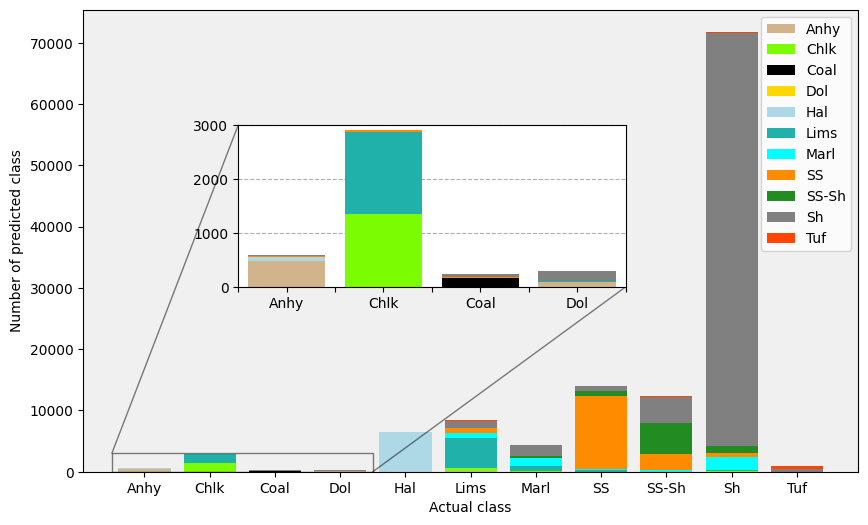

In [24]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

y_true = hidden_scaled.LITHO.values
y_pred = hidden_pred_cat

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_names = np.array(['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS',
       'SS-Sh', 'Sh', 'Tuf'], dtype=object)
colors = ['tan', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']

support = np.sum(cm, axis=1)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(len(class_names)):
    ax.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
plt.xticks(range(len(support)), [class_names[i] for i in range(len(support))])
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')

# Display
ax.set_facecolor('#f0f0f0')

ax_zoom = ax.inset_axes([0.2, 0.4, 0.5, 0.35])

for i in range(len(class_names)):
    ax_zoom.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
ax_zoom.set_xticklabels(class_names)
labels = [item.get_text() for item in ax_zoom.get_xticklabels()]
labels[0] = ''; labels[1] = 'Anhy'; labels[2] = ''; labels[3] = 'Chlk'; labels[4] = ''; labels[5] = 'Coal'
labels[6] = ''; labels[7] = 'Dol'
ax_zoom.set_xticklabels(labels)

ax_zoom.set_xlim(-0.5, 3.5)
ax_zoom.set_ylim(0, 3000)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")


ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')
ax.legend(fontsize="10", loc ="upper right")

plt.savefig('catboost.pdf')
plt.show()


-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.4507279590186034
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: ['Dol']


G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

        Anhy       0.76      0.81      0.78       597
        Chlk       0.65      0.46      0.54      2905
        Coal       0.83      0.66      0.74       244
         Dol       0.00      0.00      0.00       287
         Hal       0.99      0.99      0.99      6498
        Lims       0.64      0.58      0.61      8374
        Marl       0.27      0.30      0.29      4396
          SS       0.75      0.84      0.79     14045
       SS-Sh       0.67      0.40      0.50     12283
          Sh       0.88      0.94      0.91     71827
         Tuf       0.57      0.51      0.54       941

    accuracy                           0.81    122397
   macro avg       0.64      0.59      0.61    122397
weighted avg       0.80      0.81      0.80    122397

None


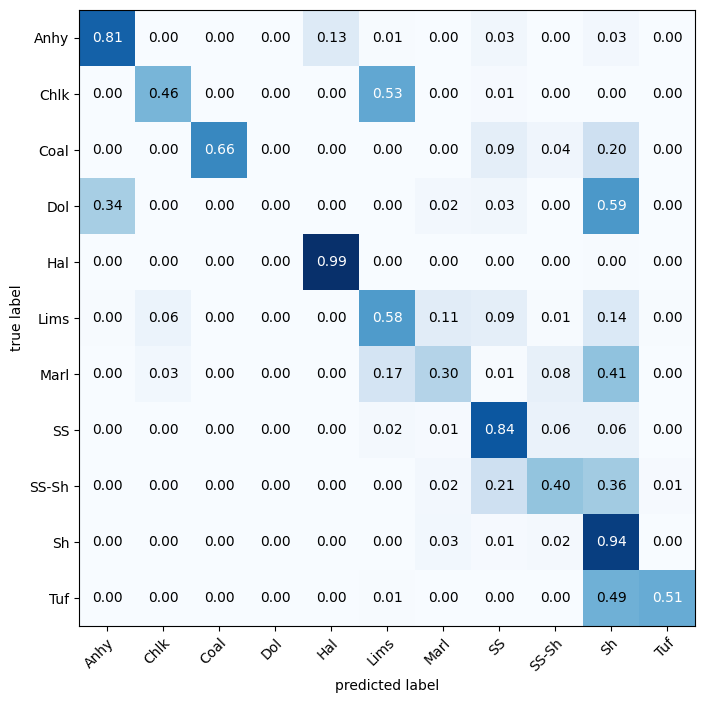

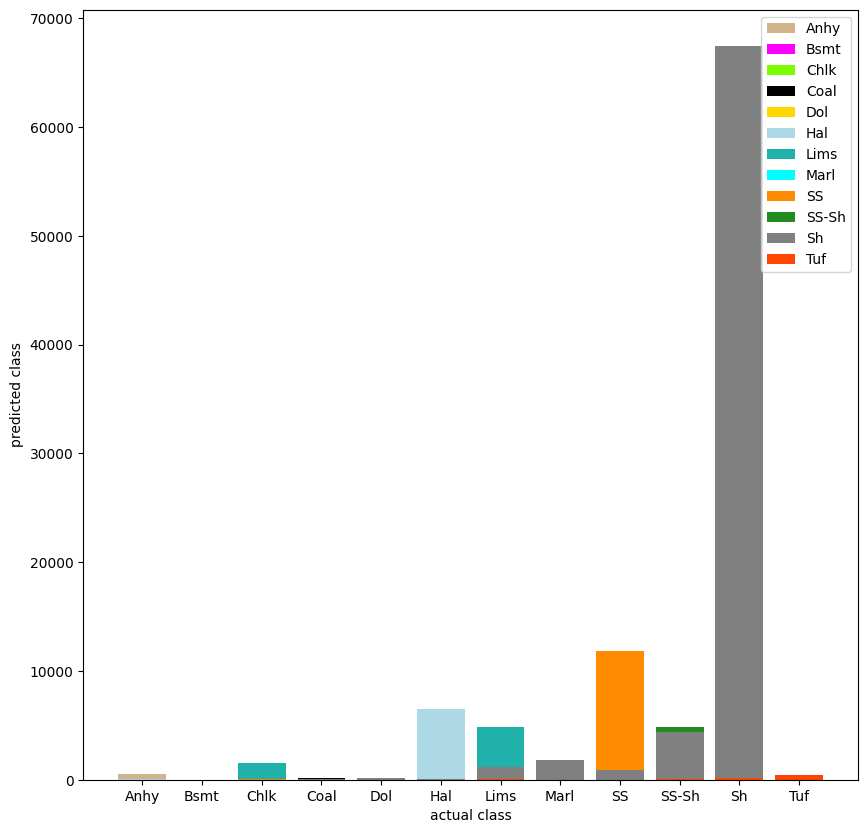

In [32]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_cat))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_cat, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_cat, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_cat, le)

In [39]:
train_cat_res = training_form.copy()
test_cat_res = test_form.copy()
hidden_cat_res = hidden_form.copy()

train_cat_res['CAT_TM'] = train_pred_cat
test_cat_res['CAT_TM'] = test_pred_cat
hidden_cat_res['CAT_TM'] = hidden_pred_cat

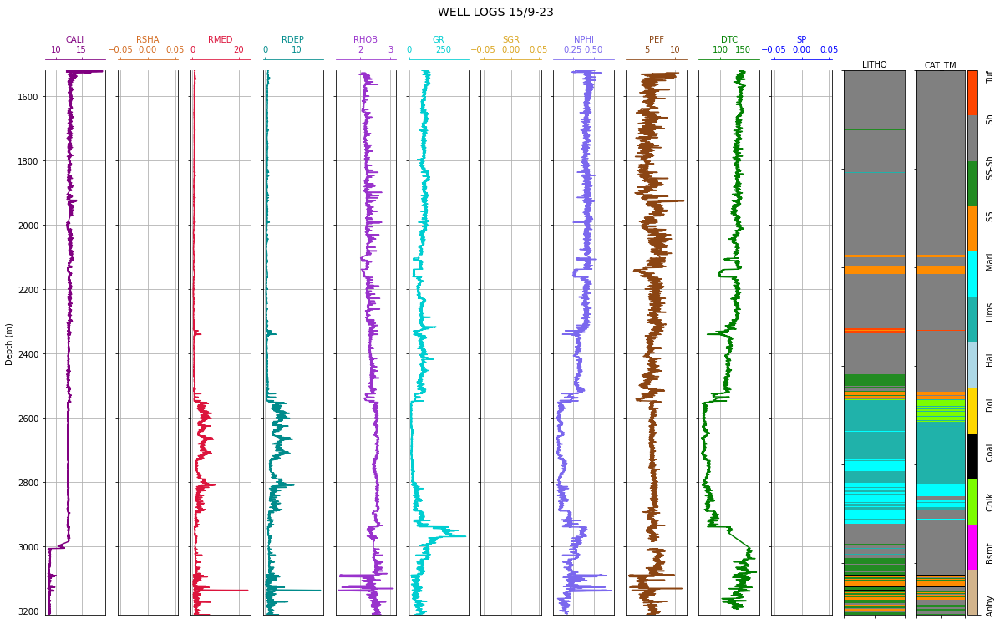

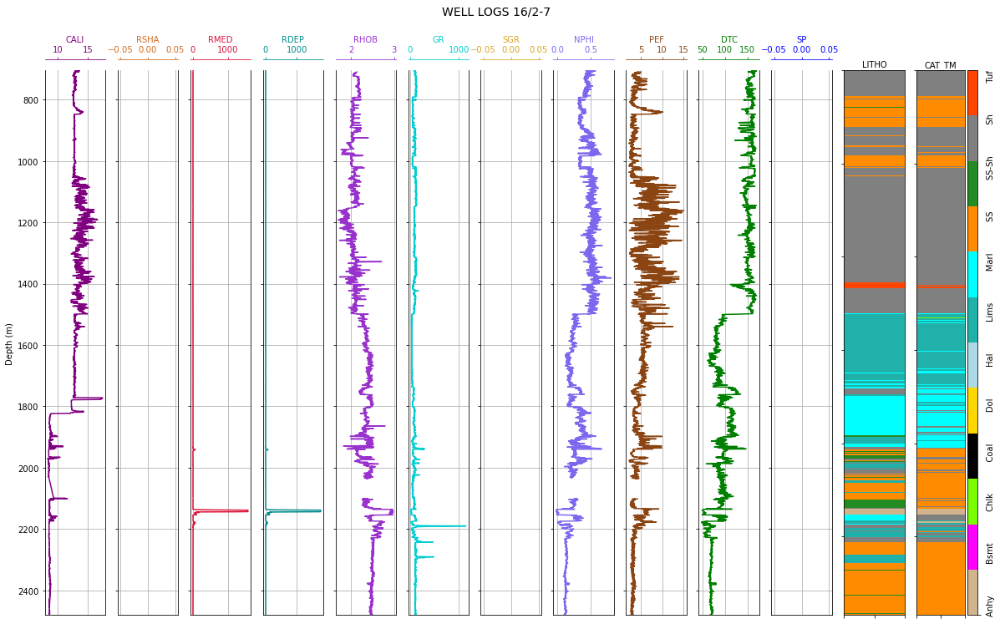

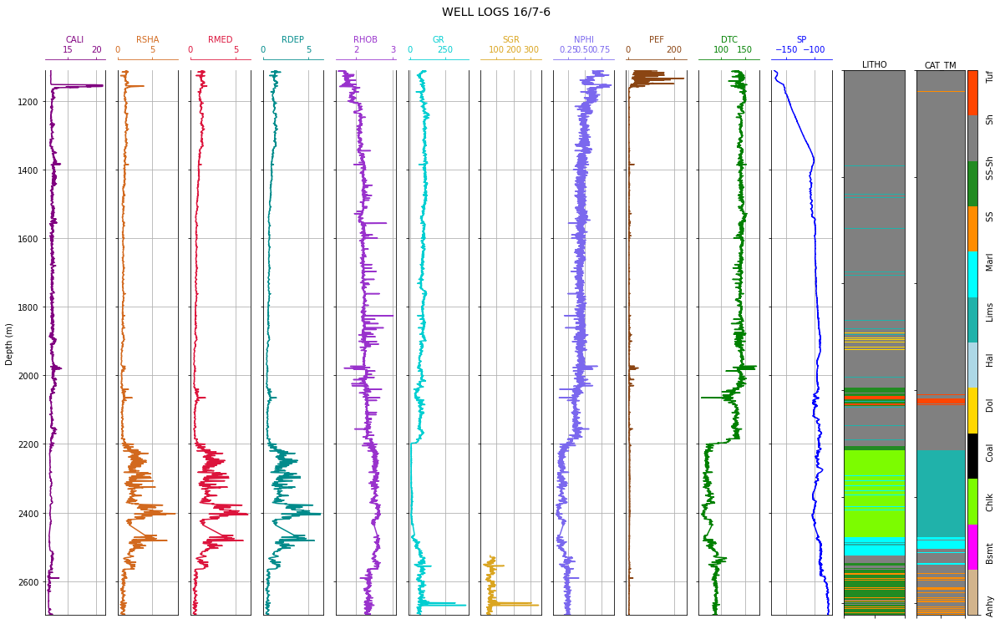

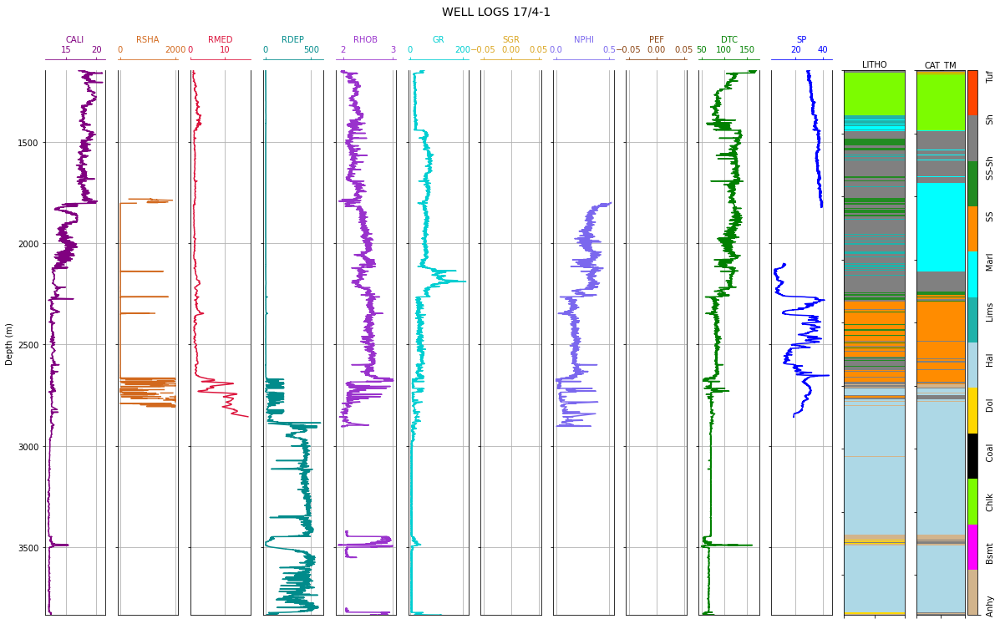

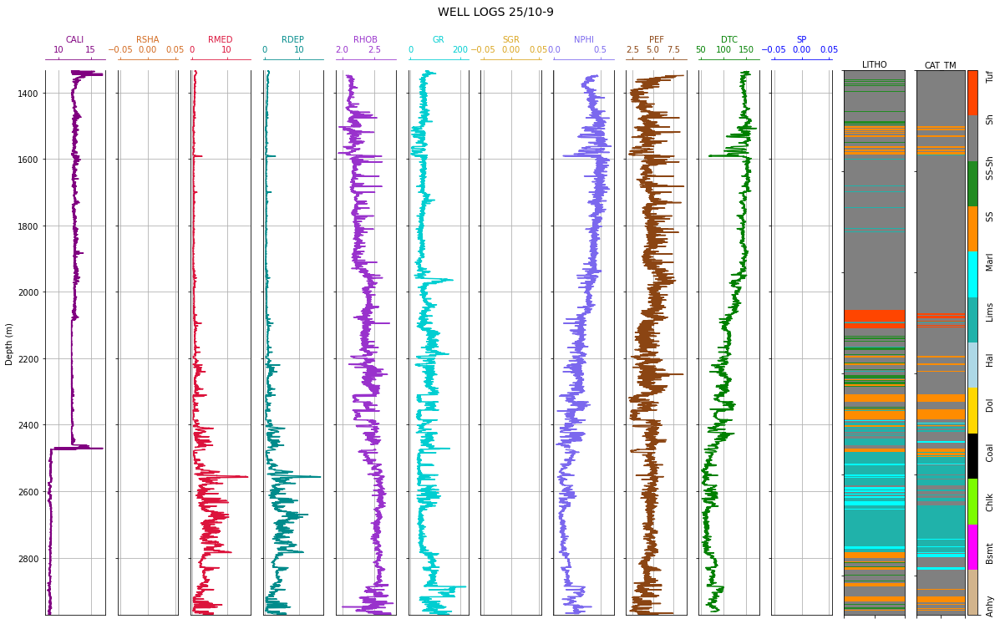

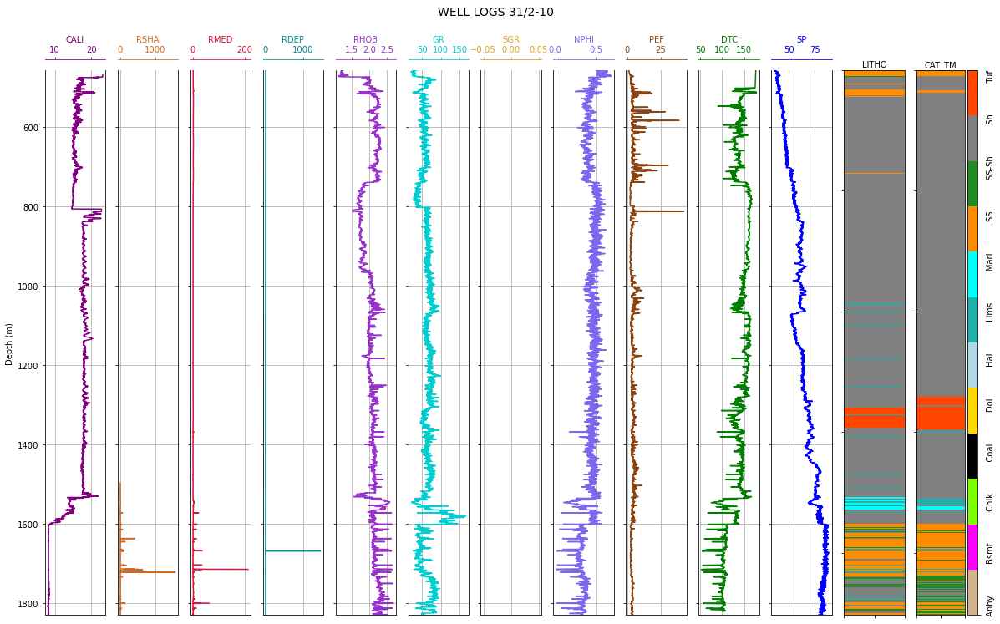

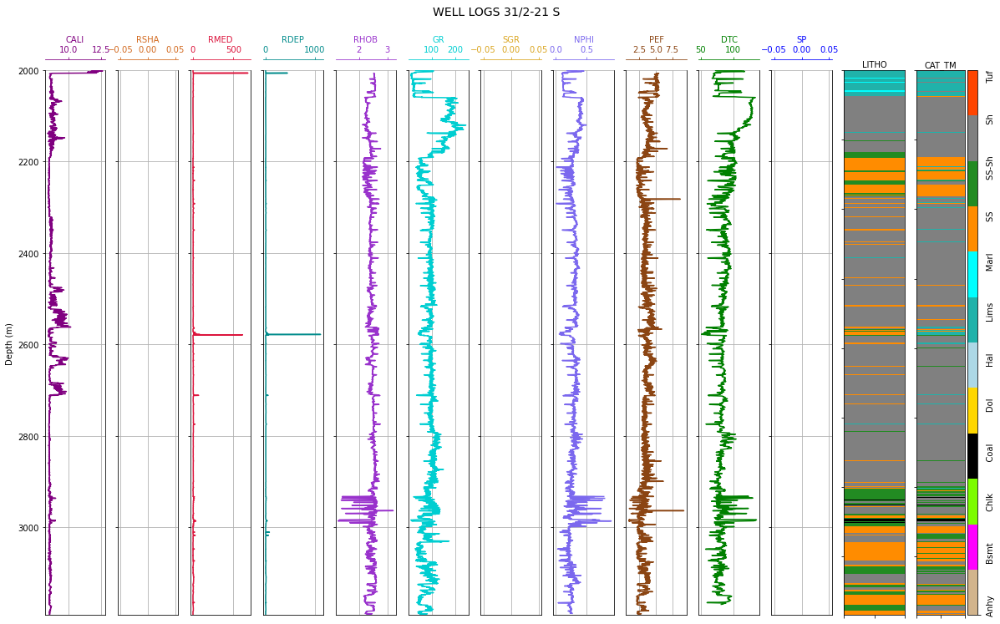

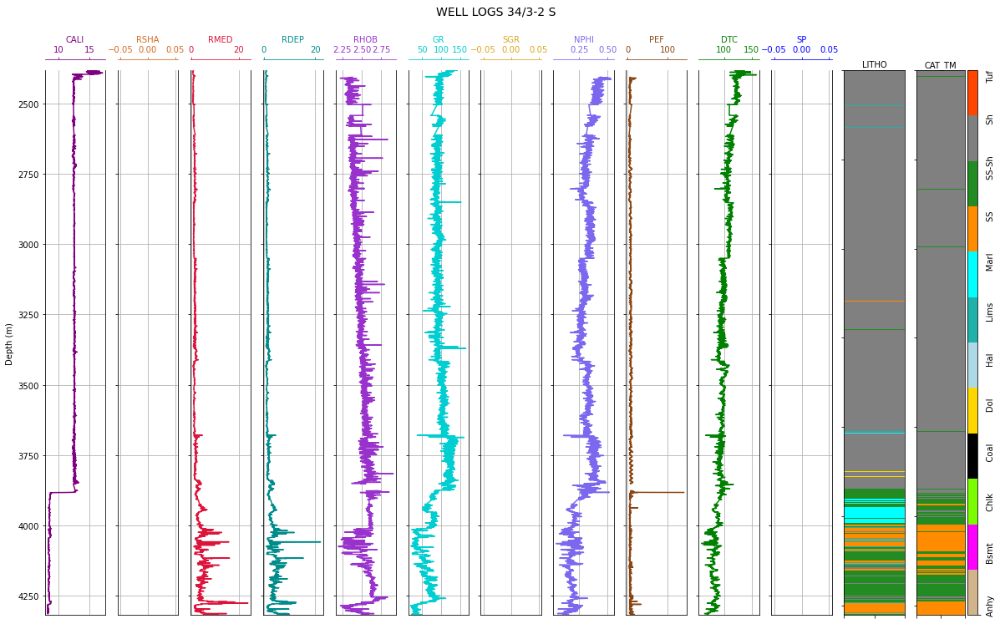

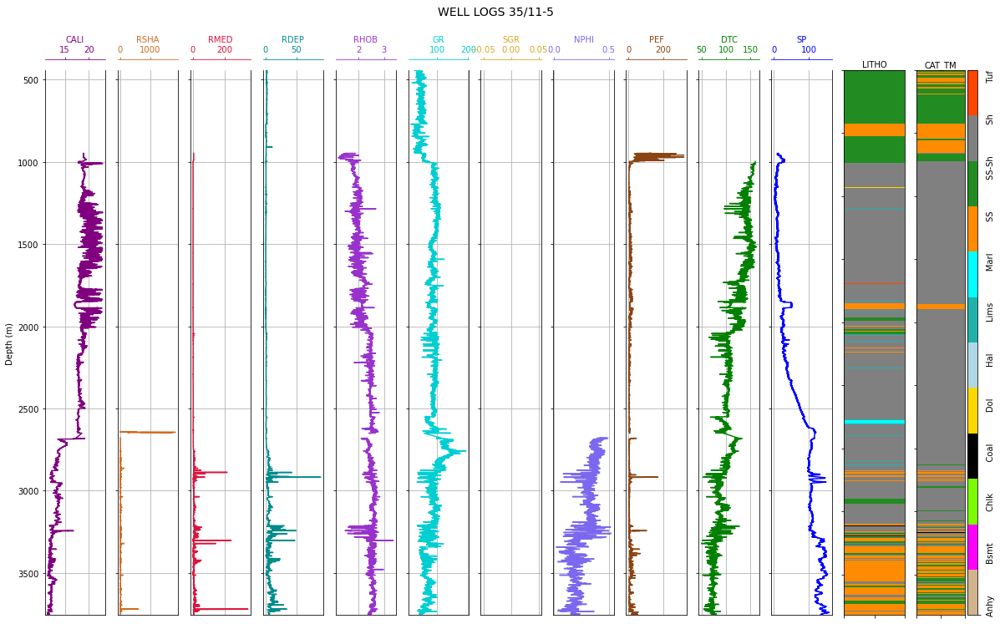

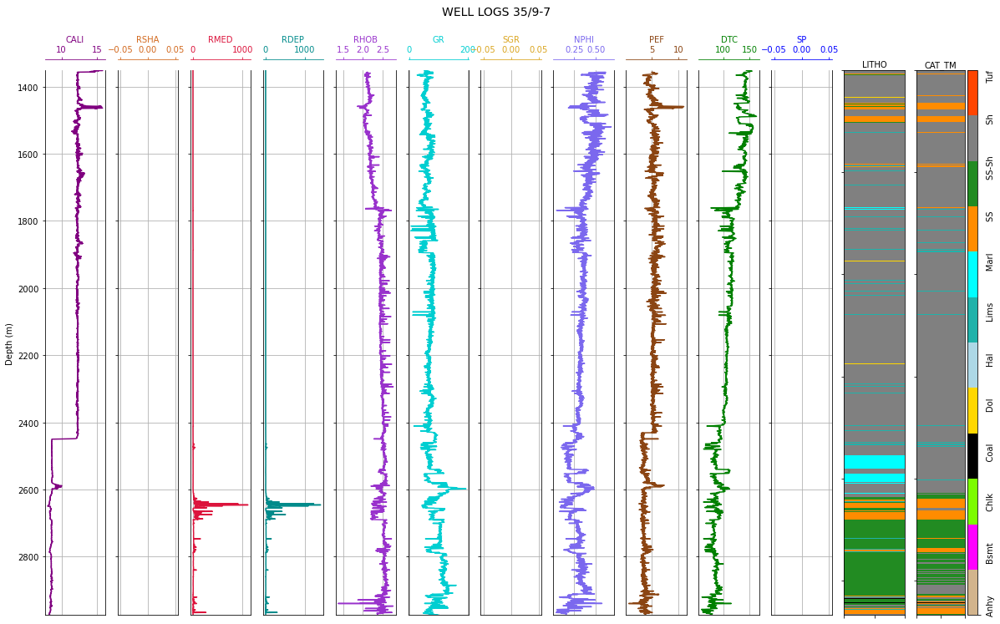

In [40]:
for i in range(0, 10):
  litho_prediction(hidden_cat_res, i, 1, le)

###  $\color{blue}{\text{7. EXTREME GRADIENT BOOSTING MODEL (XGB)}}$

In [21]:
train_pred_xgb, test_pred_xgb, hidden_pred_xgb = run_XGB(train_scaled, test_scaled, hidden_scaled)

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[09:49:11] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[09:49:12] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25076
[100]	validation_0-mlogloss:0.52450
[200]	validation_0-mlogloss:0.44836
[300]	validation_0-mlogloss:0.41334
[400]	validation_0-mlogloss:0.39022
[500]	validation_0-mlogloss:0.37369
[600]	validation_0-mlogloss:0.36087
[700]	validation_0-mlogloss:0.34964
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:12:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:12:06] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25103
[100]	validation_0-mlogloss:0.52912
[200]	validation_0-mlogloss:0.45314
[300]	validation_0-mlogloss:0.41757
[400]	validation_0-mlogloss:0.39413
[500]	validation_0-mlogloss:0.37788
[600]	validation_0-mlogloss:0.36408
[700]	validation_0-mlogloss:0.35283
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:35:01] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:35:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25092
[100]	validation_0-mlogloss:0.52257
[200]	validation_0-mlogloss:0.44652
[300]	validation_0-mlogloss:0.41114
[400]	validation_0-mlogloss:0.38860
[500]	validation_0-mlogloss:0.37170
[600]	validation_0-mlogloss:0.35899
[700]	validation_0-mlogloss:0.34755
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[10:58:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[10:58:07] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25069
[100]	validation_0-mlogloss:0.52510
[200]	validation_0-mlogloss:0.44914
[300]	validation_0-mlogloss:0.41388
[400]	validation_0-mlogloss:0.39089
[500]	validation_0-mlogloss:0.37469
[600]	validation_0-mlogloss:0.36122
[700]	validation_0-mlogloss:0.35009
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[11:21:23] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:21:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25090
[100]	validation_0-mlogloss:0.52508
[200]	validation_0-mlogloss:0.44871
[300]	validation_0-mlogloss:0.41393
[400]	validation_0-mlogloss:0.39167
[500]	validation_0-mlogloss:0.37502
[600]	validation_0-mlogloss:0.36129
[700]	validation_0-mlogloss:0.34975
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[11:44:34] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[11:44:36] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25086
[100]	validation_0-mlogloss:0.52715
[200]	validation_0-mlogloss:0.45071
[300]	validation_0-mlogloss:0.41490
[400]	validation_0-mlogloss:0.39248
[500]	validation_0-mlogloss:0.37548
[600]	validation_0-mlogloss:0.36161
[700]	validation_0-mlogloss:0.35080
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[12:07:27] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[12:07:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25076
[100]	validation_0-mlogloss:0.52455
[200]	validation_0-mlogloss:0.44763
[300]	validation_0-mlogloss:0.41351
[400]	validation_0-mlogloss:0.39101
[500]	validation_0-mlogloss:0.37473
[600]	validation_0-mlogloss:0.36102
[700]	validation_0-mlogloss:0.34956
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[12:30:43] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[12:30:44] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25099
[100]	validation_0-mlogloss:0.52799
[200]	validation_0-mlogloss:0.45098
[300]	validation_0-mlogloss:0.41561
[400]	validation_0-mlogloss:0.39272
[500]	validation_0-mlogloss:0.37542
[600]	validation_0-mlogloss:0.36223
[700]	validation_0-mlogloss:0.35133
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[12:53:38] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[12:53:40] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25057
[100]	validation_0-mlogloss:0.52346
[200]	validation_0-mlogloss:0.44756
[300]	validation_0-mlogloss:0.41280
[400]	validation_0-mlogloss:0.39023
[500]	validation_0-mlogloss:0.37344
[600]	validation_0-mlogloss:0.35939
[700]	validation_0-mlogloss:0.34837
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:16:52] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[13:16:53] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25051
[100]	validation_0-mlogloss:0.52673
[200]	validation_0-mlogloss:0.44940
[300]	validation_0-mlogloss:0.41387
[400]	validation_0-mlogloss:0.39081
[500]	validation_0-mlogloss:0.37420
[600]	validation_0-mlogloss:0.35996
[700]	validation_0-mlogloss:0.34890
[800]	validation

In [ ]:
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold
import numpy as np
import pandas as pd
from sklearn.metrics import accuracy_score, f1_score
from Lithofacies_Classification.Functions.additional_functions import matrix_score

# selected features to be used while training
selected_fetures_xgb = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']
x_train = train_scaled[selected_fetures_xgb]
y_train = train_scaled['LITHO']
x_test = test_scaled[selected_fetures_xgb]
y_test = test_scaled['LITHO']
x_hidden = hidden_scaled[selected_fetures_xgb]
y_hidden = hidden_scaled['LITHO']
"""The model is trained on 10 stratified k-folds, also uses the open set as 
validation set to avoid overfitting and a 100-round early stopping callback.
The model uses a multi-soft_probability objective function which returns the
probabilities predicted for each class. This probabilities are computed and
stacked by using each k-fold to give the final prediction.
"""
split = 10
kf = StratifiedKFold(n_splits=split, shuffle=True)
train_prob_xgb1 = np.zeros((len(x_train), 12))
open_prob_xgb1 = np.zeros((len(x_test), 12))
hidden_prob_xgb1 = np.zeros((len(x_hidden), 12))
xgbmodel_noarg = XGBClassifier(n_estimators=1000, max_depth=4,
                               booster='gbtree', objective='multi:softprob',
                               learning_rate=0.075, random_state=42,
                               subsample=1, colsample_bytree=1,
                               tree_method='gpu_hist', predictor='gpu_predictor',
                               verbose=2020, reg_lambda=1500
                               )
i = 1
import joblib

for (train_index, test_index) in kf.split(x_train, y_train):
  X_train, X_test = x_train.iloc[train_index], x_train.iloc[test_index]
  Y_train, Y_test = y_train.iloc[train_index], y_train.iloc[test_index]
  xgbmodel_noarg.fit(X_train,
                     Y_train.values.ravel(),
                     early_stopping_rounds=100,
                     eval_set=[(X_test, Y_test)],
                     verbose=100
                     )

  filename = f"XGBoost_model_Fold{i}.json"
  xgbmodel_noarg.save_model(filename)
  prediction = xgbmodel_noarg.predict(X_test)
  print(f'Default score:', matrix_score(Y_test.values, prediction))
  print('Fold accuracy:', accuracy_score(Y_test, prediction))
  print(f'F1 is:', f1_score(prediction, Y_test, average="weighted"))
  print(f'-----------------------FOLD {i}---------------------')
  
  # stacking probabilities
  train_prob_xgb1 += xgbmodel_noarg.predict_proba(x_train)
  open_prob_xgb1 += xgbmodel_noarg.predict_proba(x_test)
  hidden_prob_xgb1 += xgbmodel_noarg.predict_proba(x_hidden)
  i += 1
# final lithology class prediction
train_prob_xgb1 = pd.DataFrame(train_prob_xgb1/split)
train_pred_xgb1 = np.array(pd.DataFrame(train_prob_xgb1).idxmax(axis=1))
open_prob_xgb1 = pd.DataFrame(open_prob_xgb1/split)
open_pred_xgb1 = np.array(pd.DataFrame(open_prob_xgb1).idxmax(axis=1))
hidden_prob_xgb1 = pd.DataFrame(hidden_prob_xgb1/split)
hidden_pred_xgb1 = np.array(pd.DataFrame(hidden_prob_xgb1).idxmax(axis=1))


G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[23:24:03] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[23:24:05] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25072
[100]	validation_0-mlogloss:0.52765
[200]	validation_0-mlogloss:0.45039
[300]	validation_0-mlogloss:0.41578
[400]	validation_0-mlogloss:0.39304
[500]	validation_0-mlogloss:0.37657
[600]	validation_0-mlogloss:0.36279
[700]	validation_0-mlogloss:0.35163
[800]	validation

G:\Pc\litho-venv\lib\site-packages\xgboost\sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[00:03:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[00:03:58] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25081
[100]	validation_0-mlogloss:0.52382
[200]	validation_0-mlogloss:0.44645
[300]	validation_0-mlogloss:0.41190
[400]	validation_0-mlogloss:0.38905
[500]	validation_0-mlogloss:0.37228
[600]	validation_0-mlogloss:0.35886
[700]	validation_0-mlogloss:0.34833
[800]	validation

C:\Users\esfahani\AppData\Local\Temp\ipykernel_9612\4045722391.py:39: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(class_names)
C:\Users\esfahani\AppData\Local\Temp\ipykernel_9612\4045722391.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(labels)


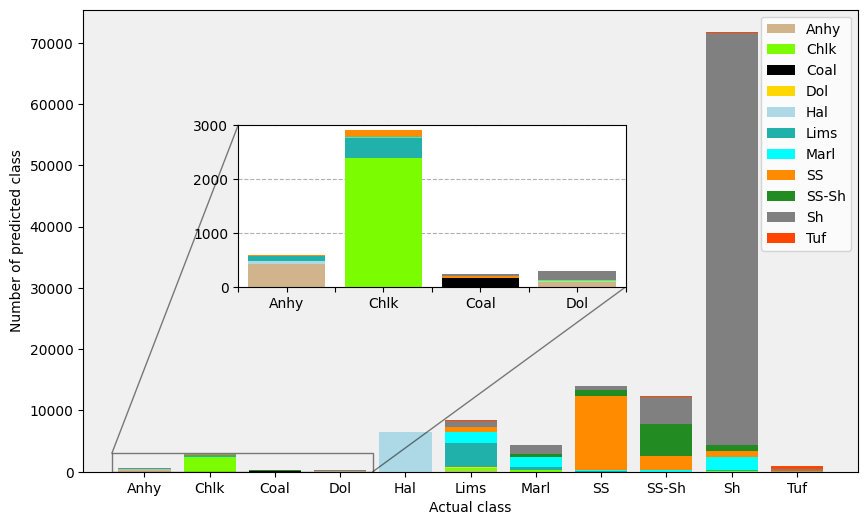

In [22]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

y_true = hidden_scaled.LITHO.values
y_pred = hidden_pred_xgb

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_names = np.array(['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS',
       'SS-Sh', 'Sh', 'Tuf'], dtype=object)
colors = ['tan', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']

support = np.sum(cm, axis=1)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(len(class_names)):
    ax.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
plt.xticks(range(len(support)), [class_names[i] for i in range(len(support))])
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')

# Display
ax.set_facecolor('#f0f0f0')

ax_zoom = ax.inset_axes([0.2, 0.4, 0.5, 0.35])

for i in range(len(class_names)):
    ax_zoom.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
ax_zoom.set_xticklabels(class_names)
labels = [item.get_text() for item in ax_zoom.get_xticklabels()]
labels[0] = ''; labels[1] = 'Anhy'; labels[2] = ''; labels[3] = 'Chlk'; labels[4] = ''; labels[5] = 'Coal'
labels[6] = ''; labels[7] = 'Dol'
ax_zoom.set_xticklabels(labels)

ax_zoom.set_xlim(-0.5, 3.5)
ax_zoom.set_ylim(0, 3000)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")


ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')
ax.legend(fontsize="10", loc ="upper right")

plt.savefig('xgboost.pdf')
plt.show()


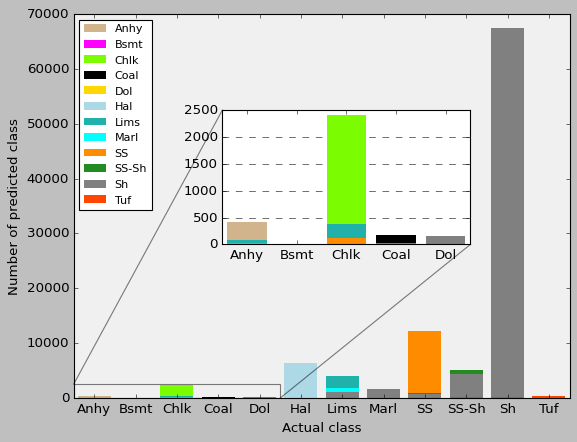

In [156]:
y_true = hidden_scaled.LITHO.values
y_pred = hidden_pred_xgb
#le
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from matplotlib.pyplot import figure
from sklearn.metrics import confusion_matrix
d = le.classes_
l1 = le.inverse_transform(np.unique(y_true, return_counts=True)[0].astype(int))
l2 = le.inverse_transform(np.unique(y_pred, return_counts=True)[0].astype(int))
l3 = np.array([value for value in list(l2) if not value in list(l1)] + [value for value in list(l1) if not value in list(l2)], dtype='O')
class_names = np.unique(np.concatenate([l1, l2, l3]))
e = np.array([value for value in list(d) if not value in list(class_names)] + [value for value in list(class_names) if not value in list(d)], dtype='O')
e_num = le.transform(e)

for dd in e_num:
  class_num = confusion_matrix(y_true, y_pred).T
  class_num = np.insert(class_num, dd, np.array([0 for i in range(11)]), axis=1)
  class_num = np.insert(class_num, dd, np.array([0 for i in range(12)]), axis=0)

import matplotlib.style
import matplotlib as mpl
mpl.style.use('classic')

c_index = le.transform(d)
colors = ['tan', 'magenta', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']
fig, ax = plt.subplots()
for i in range(12):
  ax.bar(d, class_num[i], color=colors[i], label=d[i], linewidth=0)
# Define labels
ax_zoom = ax.inset_axes([0.3, 0.4, 0.5, 0.35])

for i in range(12):
    ax_zoom.bar(d, class_num[i], color=colors[i], label=d[i], linewidth=0)
ax_zoom.set_xlim(-0.5, 4.5)
ax_zoom.set_ylim(0, 2500)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")

ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')

# Set labels and title for the main plot
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')
ax.set_xlim(-0.5, 11.5)
#plt.yticks(np.arange(0, 61, 5))
# Add legend

ax.legend(fontsize="10", loc ="upper left")

# Display
ax.set_facecolor('#f0f0f0')

plt.savefig('xgboost.pdf')
plt.show()

-----------------------TRAIN SET REPORT---------------------
Train set penalty matrix score: -0.2861635858185015
Accuracy score: 0.8914653514576113
Real Facies (l1): ['Anhy', 'Bsmt', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Bsmt', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.93      0.91      0.92      1085
        Bsmt       0.99      0.83      0.91       103
        Chlk       0.92      0.93      0.93     10513
        Coal       0.82      0.69      0.75      3820
         Dol       0.68      0.21      0.32      1688
         Hal       0.99      0.99      0.99      8213
        Lims       0.86      0.69      0.77     56320
        Marl       0.85      0.78      0.81     33329
          SS       0.87      0.85      0.86    168937
       SS-Sh       0.80      0.67      0.73    150455
          Sh 

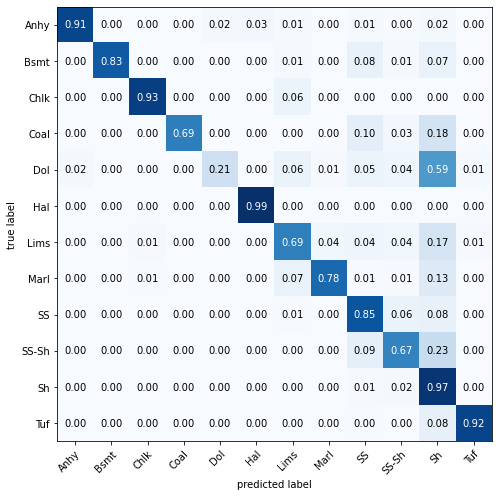

In [23]:
from sklearn.metrics import accuracy_score
from matplotlib import pyplot as plt
print('-----------------------TRAIN SET REPORT---------------------')
print('Train set penalty matrix score:', matrix_score(train_scaled.LITHO.values, train_pred_xgb))
print('Accuracy score:', accuracy_score(train_scaled.LITHO.values, train_pred_xgb))
print(clf_rep(train_scaled.LITHO.values, train_pred_xgb, le))
cm_plot(train_scaled.LITHO.values, train_pred_xgb, le)

-----------------------TEST SET REPORT---------------------
Test set penalty matrix score: -0.5205046569093328
Accuracy score: 0.7986562952348925
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Coal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: ['Chlk' 'Dol']


d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

        Anhy       0.95      0.17      0.29       125
        Chlk       0.00      0.00      0.00       625
        Coal       0.77      0.60      0.67       690
         Dol       0.00      0.00      0.00       416
        Lims       0.51      0.51      0.51      4798
        Marl       0.67      0.14      0.23      3306
          SS       0.83      0.82      0.82     24048
       SS-Sh       0.58      0.31      0.40     17558
          Sh       0.83      0.95      0.89     83975
         Tuf       0.78      0.58      0.66      1245

    accuracy                           0.80    136786
   macro avg       0.59      0.41      0.45    136786
weighted avg       0.77      0.80      0.77    136786

None


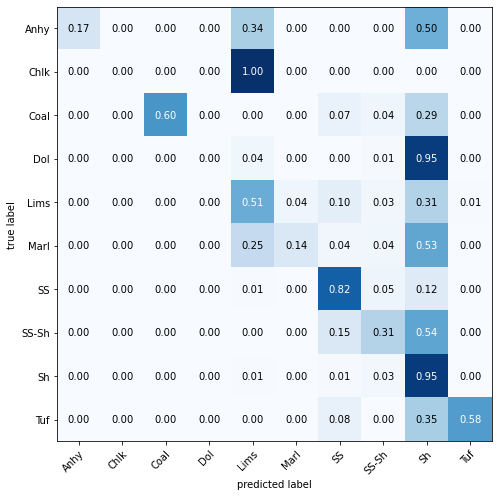

In [24]:
from sklearn.metrics import accuracy_score
print('-----------------------TEST SET REPORT---------------------')
print('Test set penalty matrix score:', matrix_score(test_scaled.LITHO.values, test_pred_xgb))
print('Accuracy score:', accuracy_score(test_scaled.LITHO.values, test_pred_xgb))
print(clf_rep(test_scaled.LITHO.values, test_pred_xgb, le))
cm_plot(test_scaled.LITHO.values, test_pred_xgb, le)

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.4432921150028187
Accuracy score: 0.8186965366798206
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.71      0.71      0.71       597
        Chlk       0.75      0.83      0.79      2905
        Coal       0.78      0.71      0.74       244
         Dol       0.06      0.05      0.05       287
         Hal       0.99      0.99      0.99      6498
        Lims       0.77      0.48      0.60      8374
        Marl       0.26      0.36      0.30      4396
          SS       0.75      0.87      0.80     14045
       SS-Sh       0.69      0.43      0.53     12283
          Sh       0.89      0.94      0.91     71827
         Tuf       0.56    

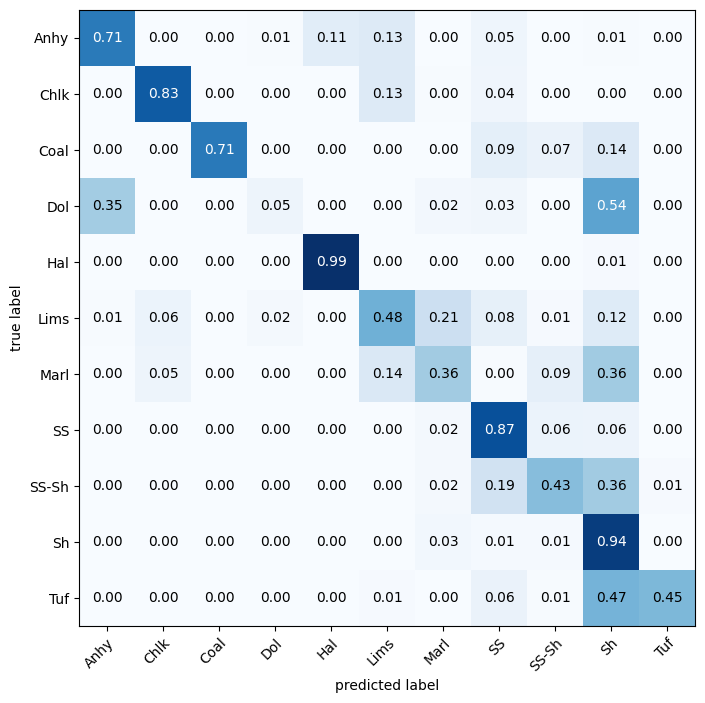

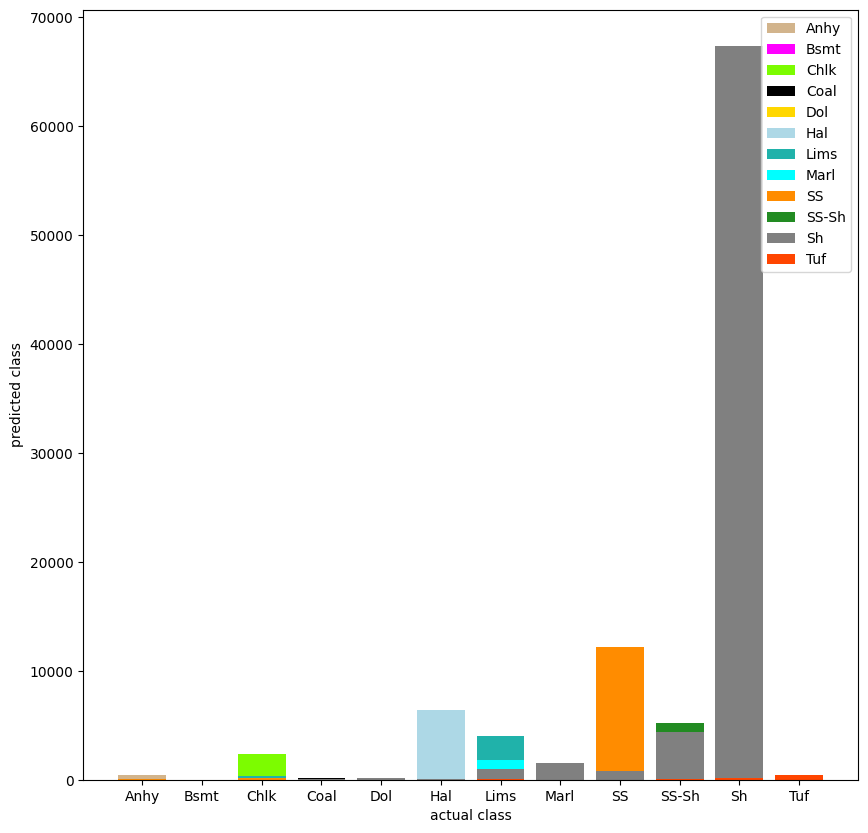

In [34]:
""""Plotting the classification report for the hidden test set
and the matrix penalty score.
"""
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_xgb))
print('Accuracy score:', accuracy_score(hidden_scaled.LITHO.values, hidden_pred_xgb))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_xgb, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_xgb, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_xgb, le)

In [24]:
"""Storing XGB predctions into a copy of the formated datasets.
"""
train_xgb_res = training_form.copy()
test_xgb_res = test_form.copy()
hidden_xgb_res = hidden_form.copy()

train_xgb_res['XGB_TM'] = train_pred_xgb
test_xgb_res['XGB_TM'] = test_pred_xgb
hidden_xgb_res['XGB_TM'] = hidden_pred_xgb

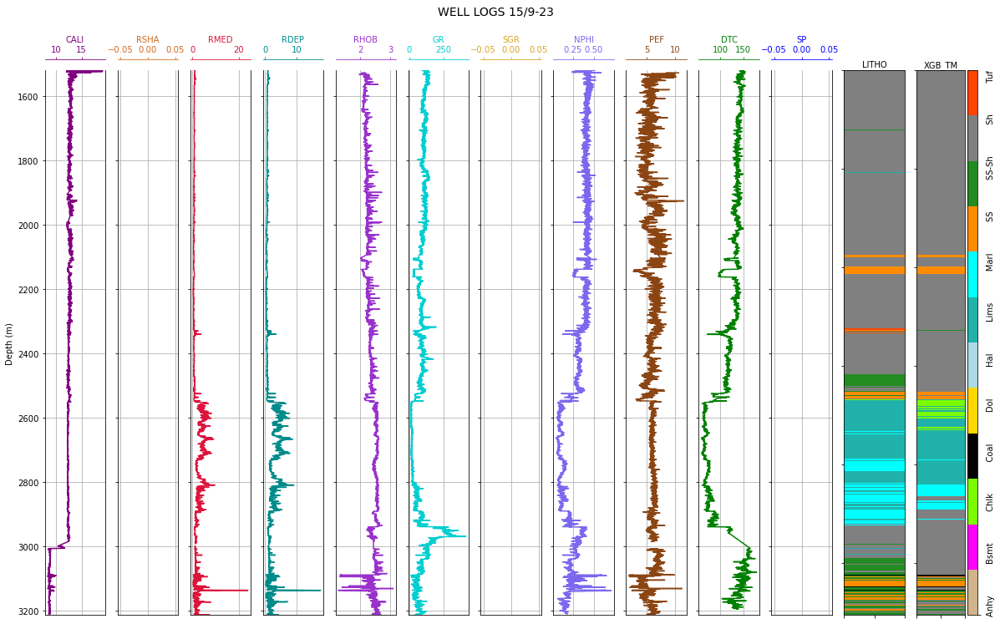

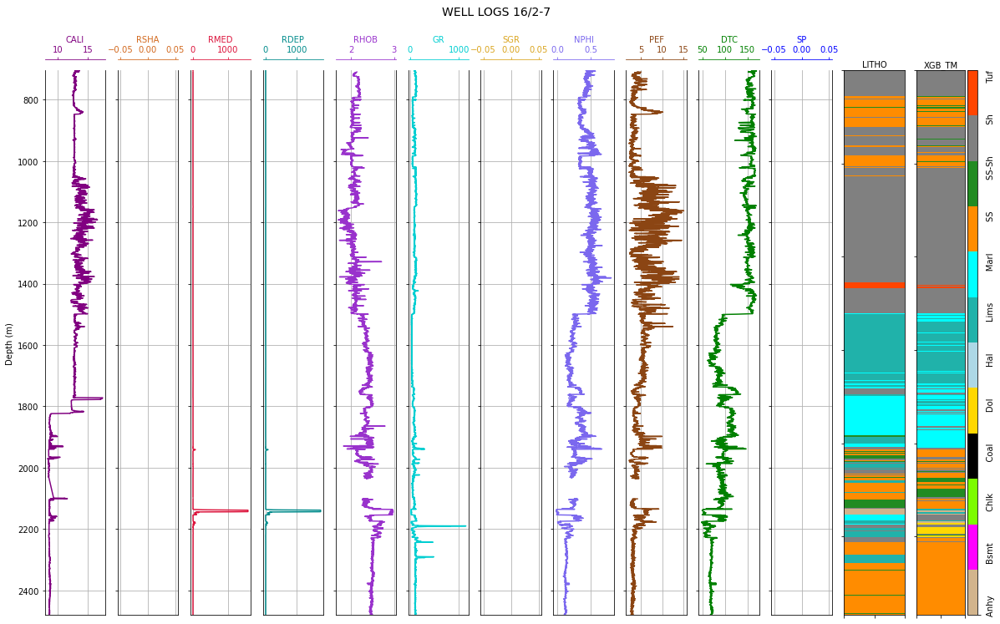

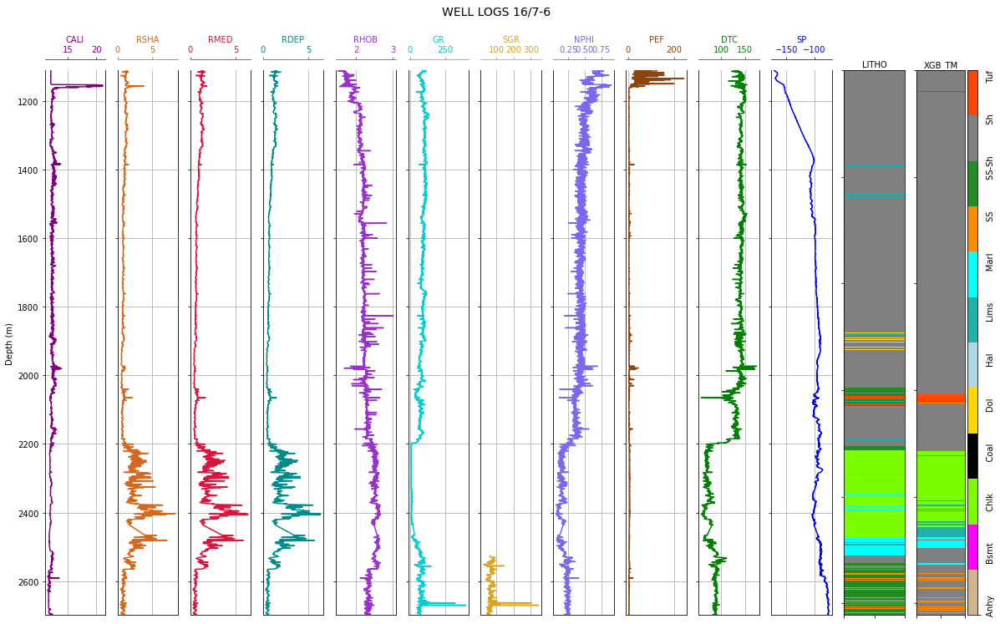

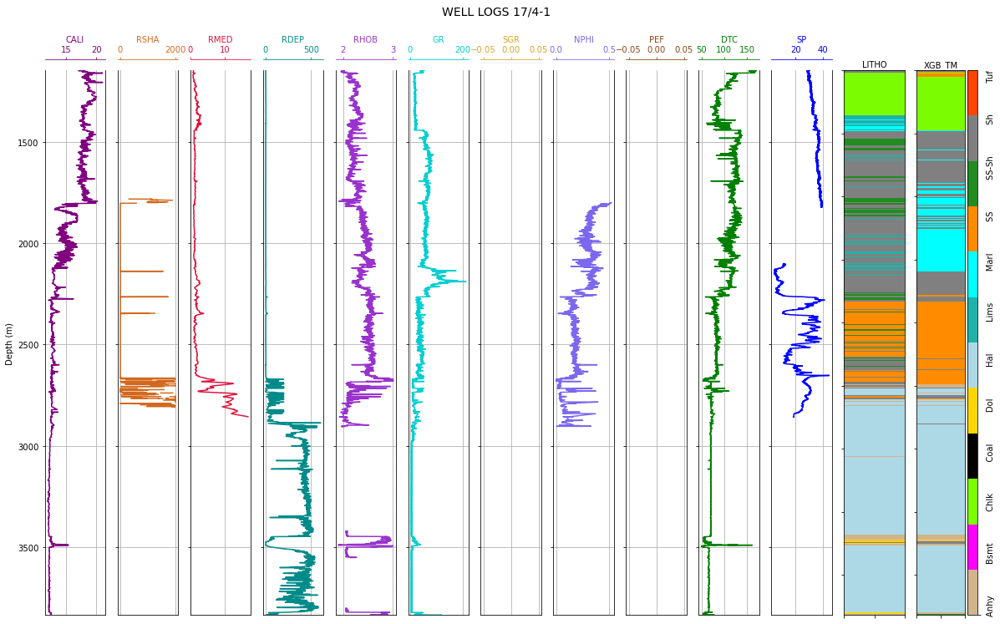

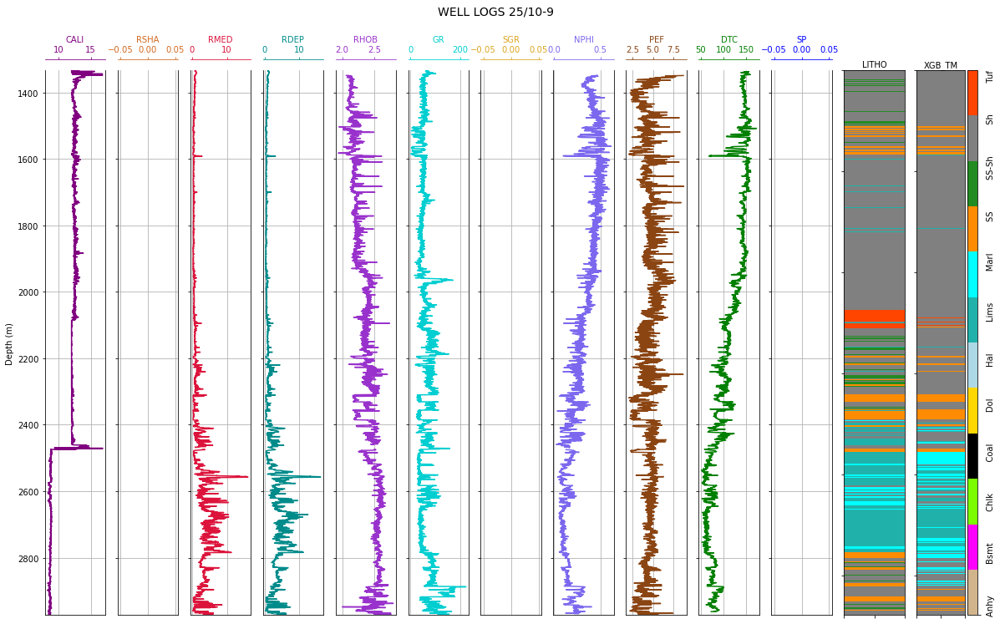

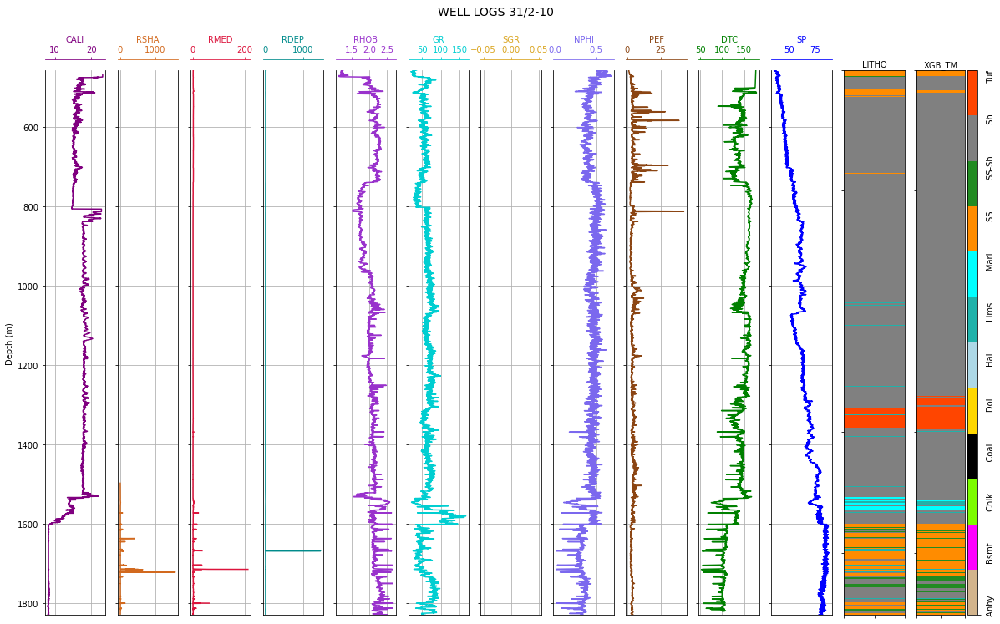

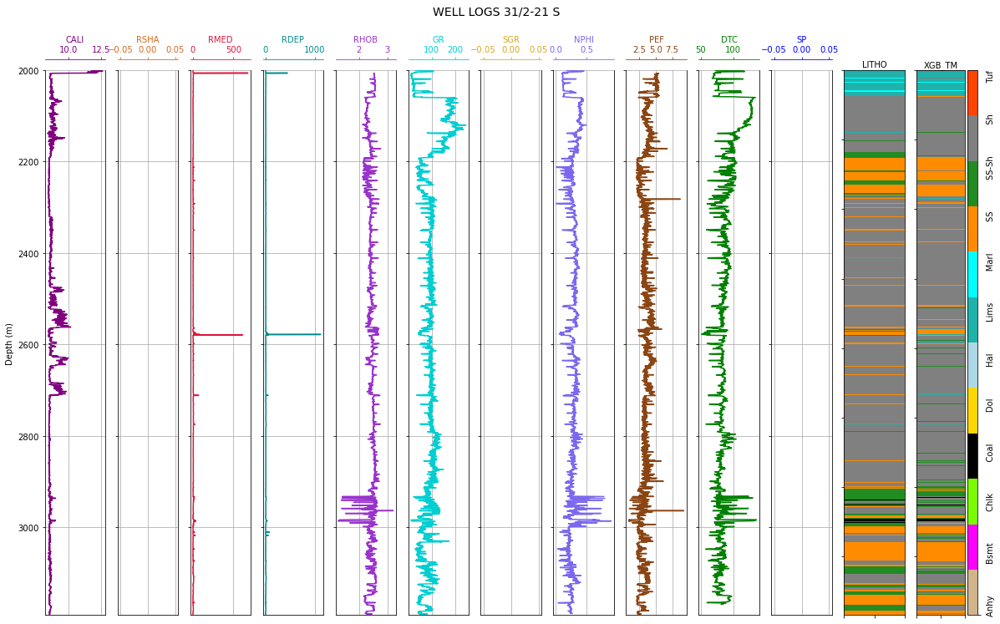

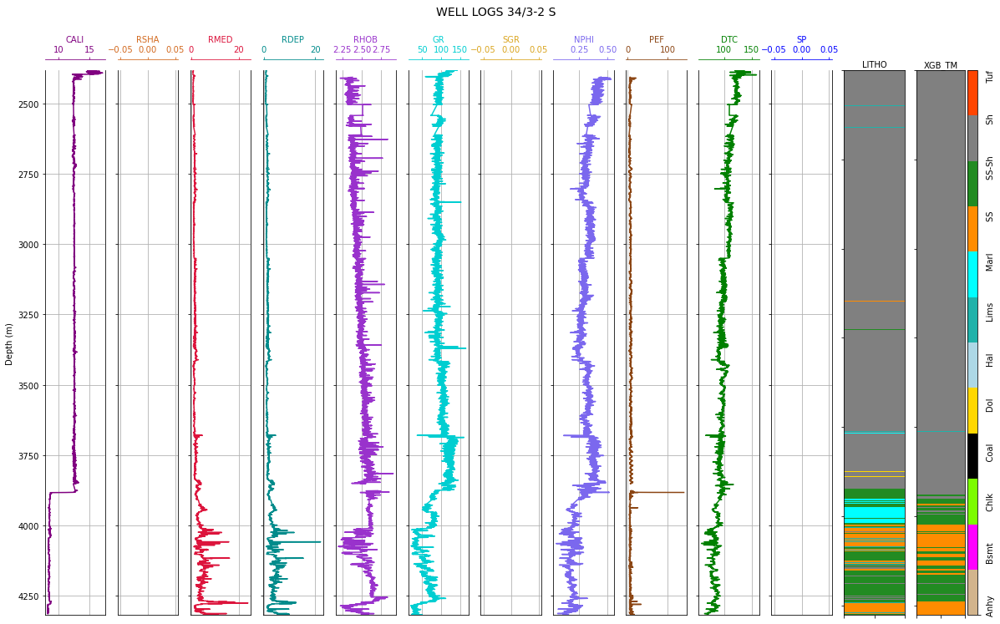

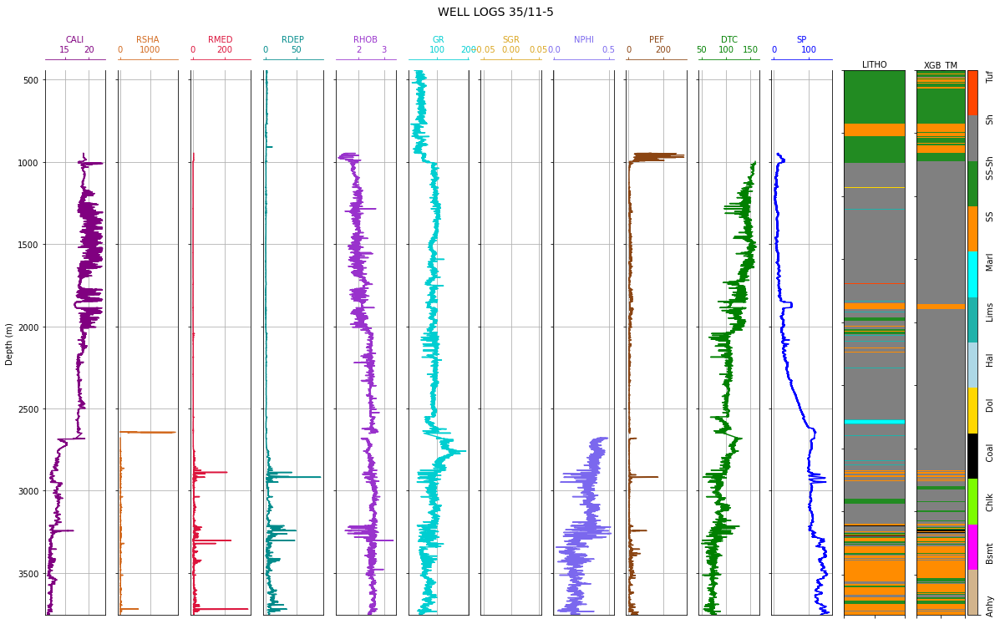

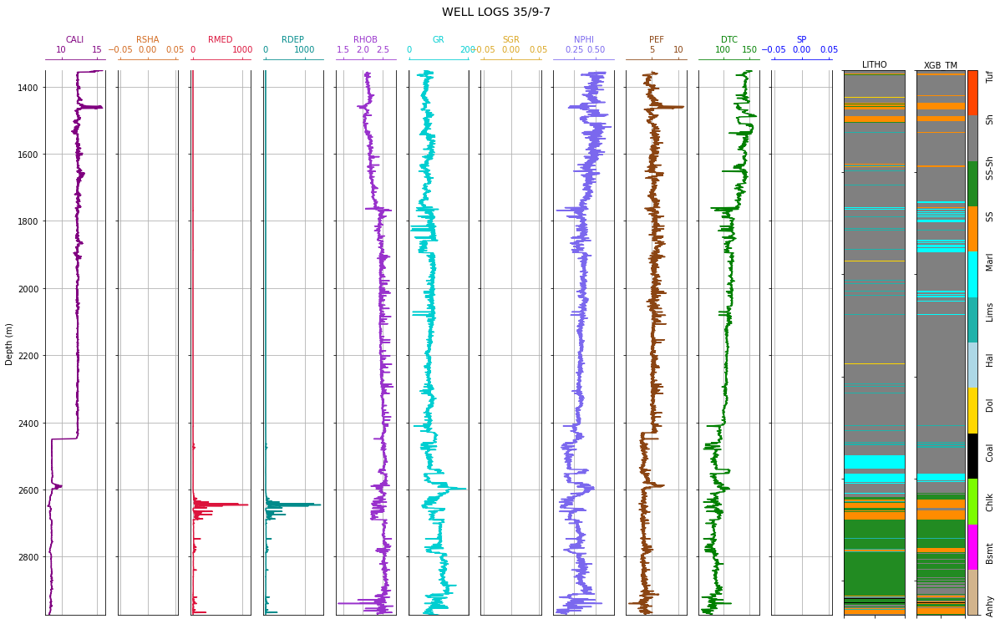

In [25]:
""" Plotting hidden test set well logs, actual and predicted litholofacies by calling 
litho_prediction customized function. Only the fist well is displayed.

For plotting additionall wells change the range(0, 1).

See litho_prediction.py for further details about the function.
"""

for i in range(0, 10):
  litho_prediction(hidden_xgb_res, i, 1, le)

###  $\color{blue}{\text{8. NEURAL NETWORK MODEL (NN)}}$

In [28]:
train_pred_nn, test_pred_nn, hidden_pred_nn = run_NN(train_scaled, test_scaled, hidden_scaled)

Epoch 1/100
4573/4573 [==============================] - 35s 7ms/step - loss: 1.0468 - accuracy: 0.6571 - val_loss: 0.9534 - val_accuracy: 0.6908
Epoch 2/100
4573/4573 [==============================] - 33s 7ms/step - loss: 0.9292 - accuracy: 0.6907 - val_loss: 0.9221 - val_accuracy: 0.6948
Epoch 3/100
4573/4573 [==============================] - 36s 8ms/step - loss: 0.8913 - accuracy: 0.7005 - val_loss: 0.9180 - val_accuracy: 0.7039
Epoch 4/100
4573/4573 [==============================] - 33s 7ms/step - loss: 0.8654 - accuracy: 0.7077 - val_loss: 0.8994 - val_accuracy: 0.7175
Epoch 5/100
4573/4573 [==============================] - 34s 7ms/step - loss: 0.8441 - accuracy: 0.7128 - val_loss: 0.8747 - val_accuracy: 0.7138
Epoch 6/100
4573/4573 [==============================] - 34s 7ms/step - loss: 0.8286 - accuracy: 0.7164 - val_loss: 0.8492 - val_accuracy: 0.7237
Epoch 7/100
4573/4573 [==============================] - 39s 9ms/step - loss: 0.8144 - accuracy: 0.7199 - val_loss: 0.8386 -

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.5751489007083507
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: ['Dol']
              precision    recall  f1-score   support

        Anhy       0.99      0.25      0.40       597
        Chlk       0.60      0.48      0.53      2905
        Coal       0.83      0.52      0.64       244
         Dol       0.00      0.00      0.00       287
         Hal       0.98      1.00      0.99      6498
        Lims       0.49      0.61      0.54      8374
        Marl       0.33      0.18      0.23      4396
          SS       0.76      0.69      0.73     14045
       SS-Sh       0.54      0.17      0.26     12283
          Sh       0.83      0.96      0.89     71827
         Tuf       0.43      0.24      0.31       941

    accur

d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


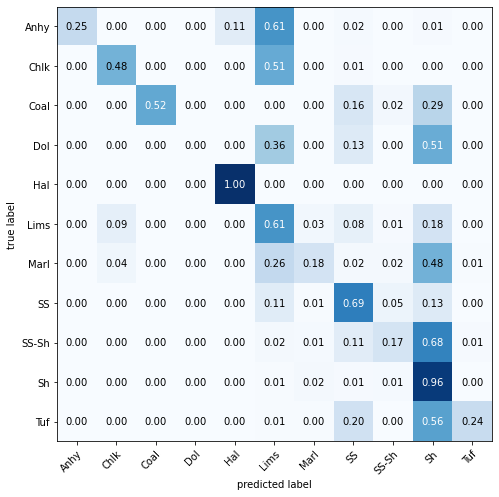

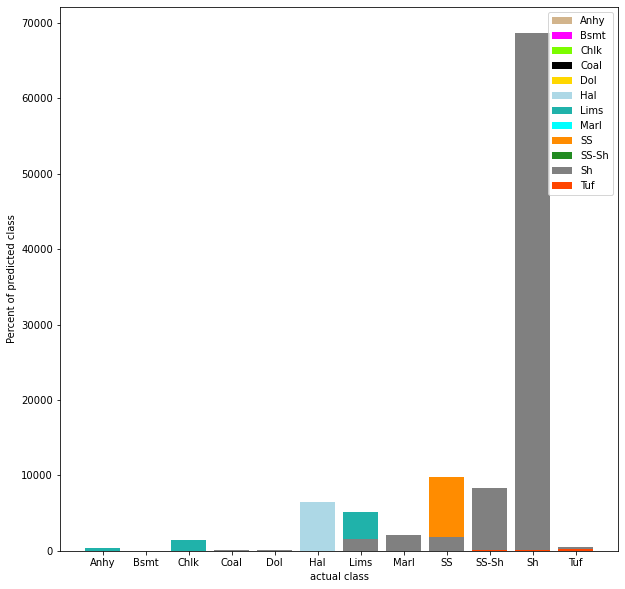

In [31]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_nn))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_nn, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_nn, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_nn, le)

In [ ]:
train_nn_res = training_form.copy()
test_nn_res = test_form.copy()
hidden_nn_res = hidden_form.copy()

train_nn_res['NN_TM'] = train_pred_nn
test_nn_res['NN_TM'] = test_pred_nn
hidden_nn_res['NN_TM'] = hidden_pred_nn

time: 79.9 ms (started: 2022-11-11 21:18:43 +00:00)


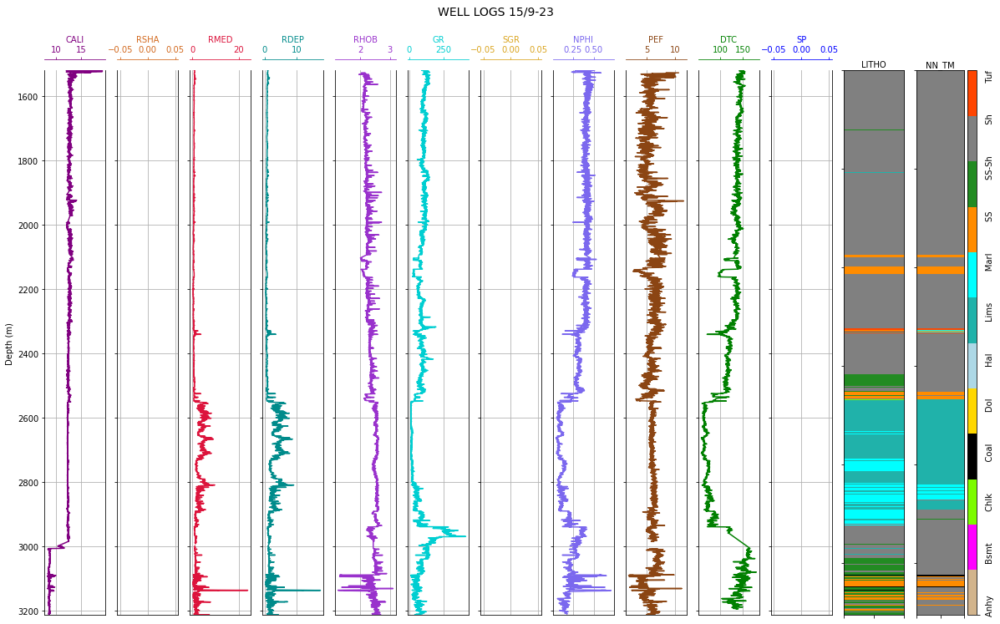

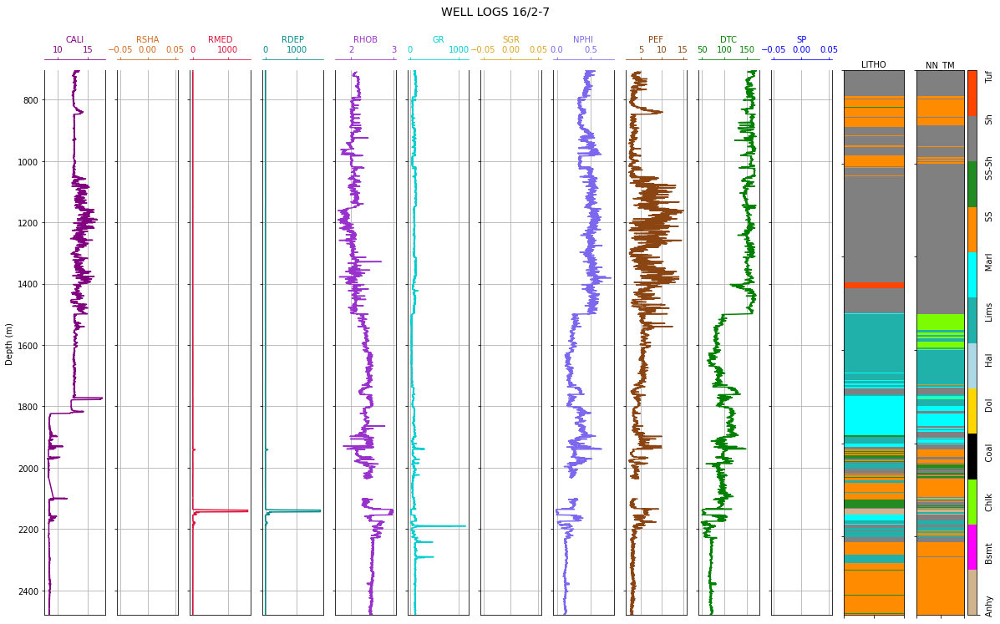

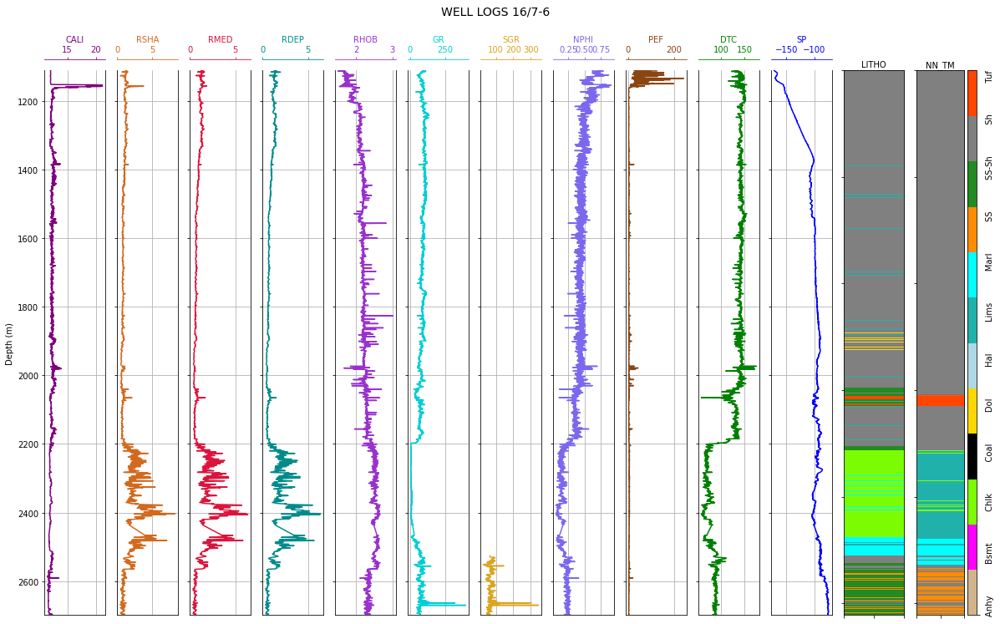

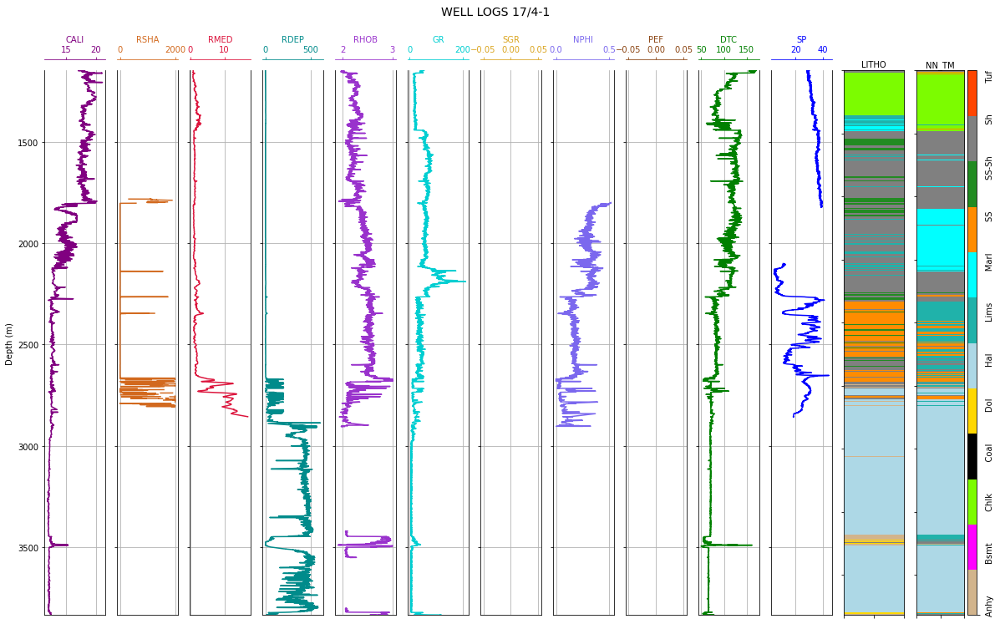

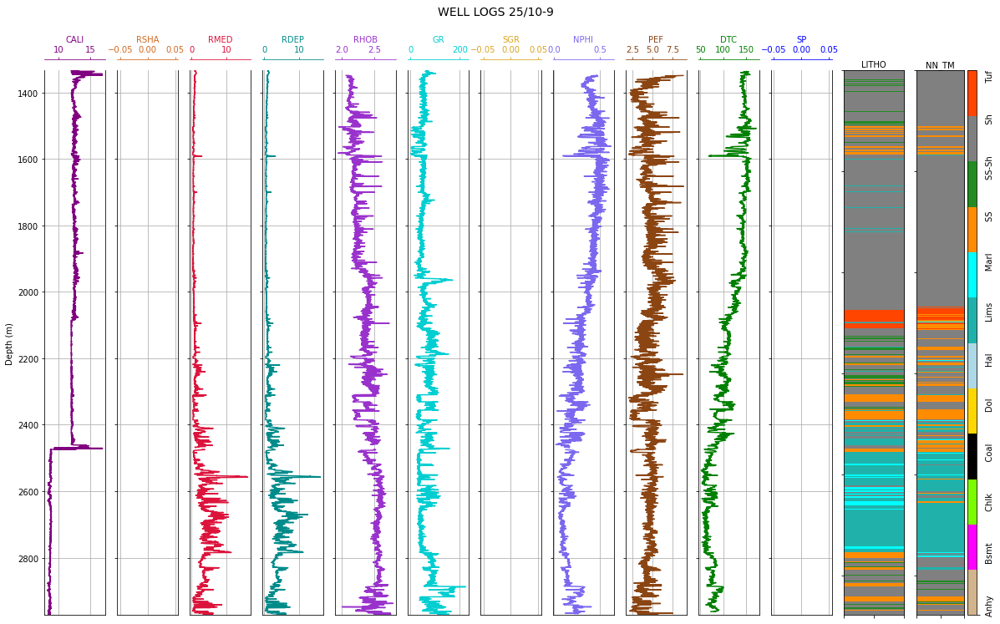

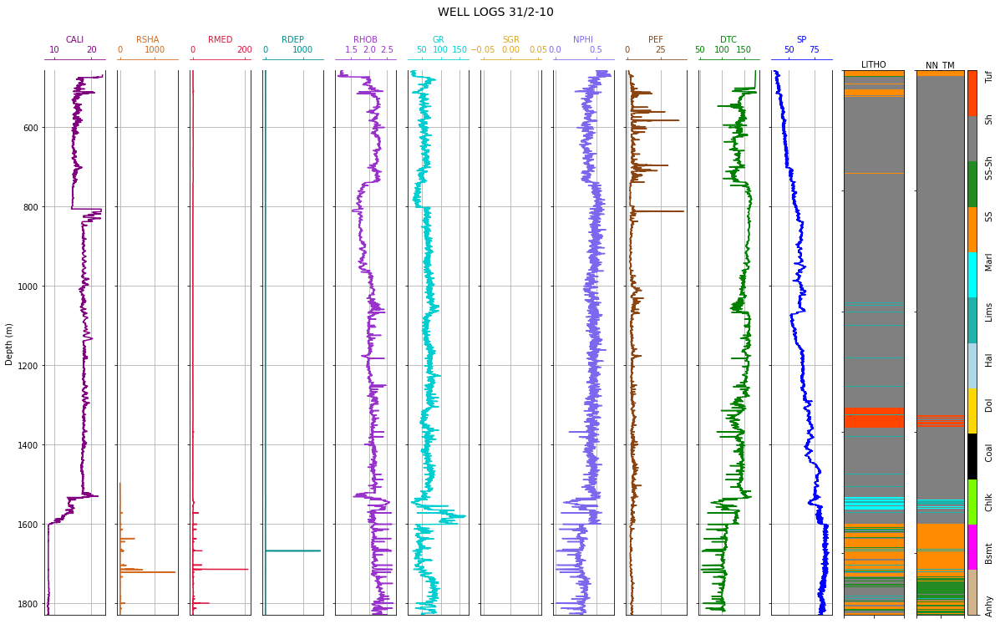

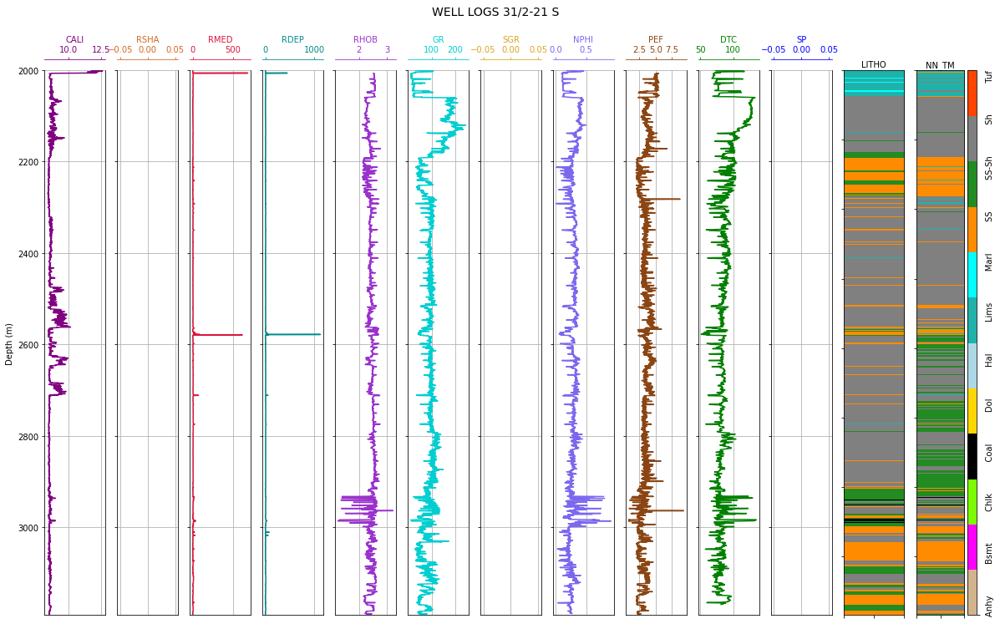

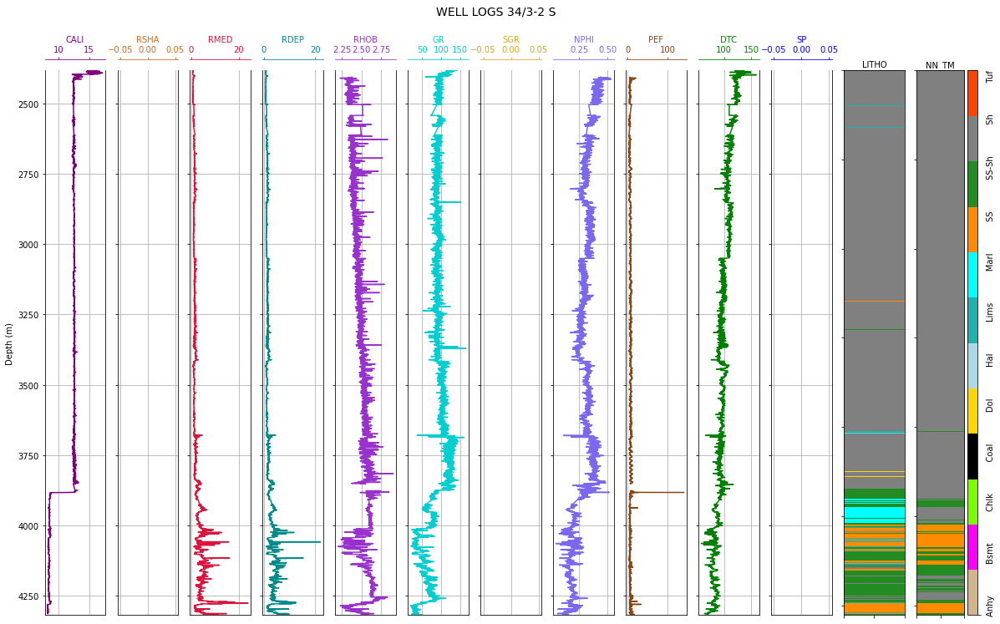

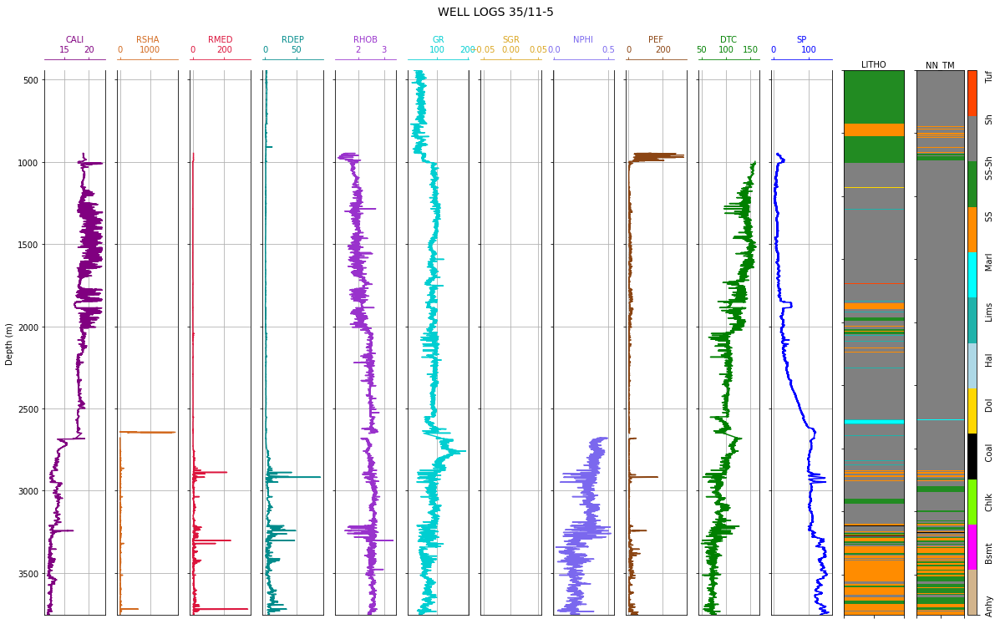

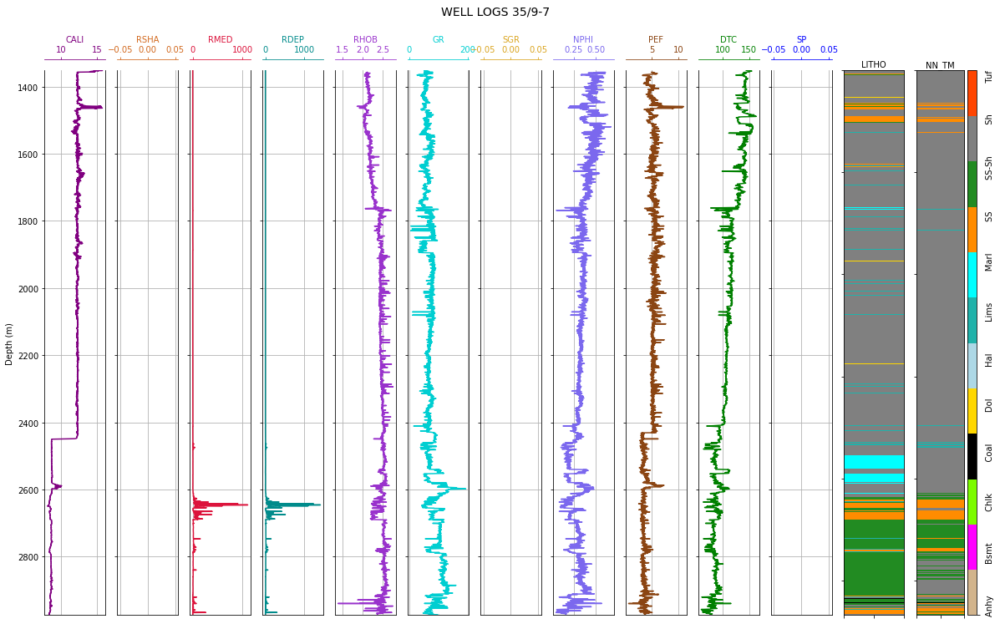

time: 40.9 s (started: 2022-11-11 21:18:43 +00:00)


In [ ]:
for i in range(0, 10):
  litho_prediction(hidden_nn_res, i, 1, le)

###  $\color{blue}{\text{9. Deep insight - v1}}$

In [ ]:
%cd /usr/local/lib/python3.7/dist-packages
!pip install tab2img
%cd /content

/usr/local/lib/python3.7/dist-packages
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
/content
time: 3.8 s (started: 2022-11-11 21:24:49 +00:00)


In [22]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import tensorflow as tf
from keras import backend as K
from tab2img.converter import Tab2Img

In [23]:
selectedfeature = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 
                        'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster']
x_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
x_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
x_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [24]:
model = Tab2Img()

In [25]:
image_train= model.fit_transform(x_train, y_train)

In [26]:
image_test= model.transform(x_test)
image_hidden= model.transform(x_hidden)

In [27]:
image_and_label_train = list(zip(image_train, y_train))

In [28]:
len(image_and_label_train)

1170511

In [29]:
image_train = image_train / 255.
image_test  = image_test  / 255.
image_hidden  = image_hidden  / 255.

In [30]:
image_train.shape

(1170511, 4, 4)

In [31]:
image_train = np.expand_dims(image_train, axis=3)
image_test = np.expand_dims(image_test, axis=3)
image_hidden = np.expand_dims(image_hidden, axis=3)

print(image_train.shape)
print(image_test.shape)
print(image_hidden.shape)

(1170511, 4, 4, 1)
(136786, 4, 4, 1)
(122397, 4, 4, 1)


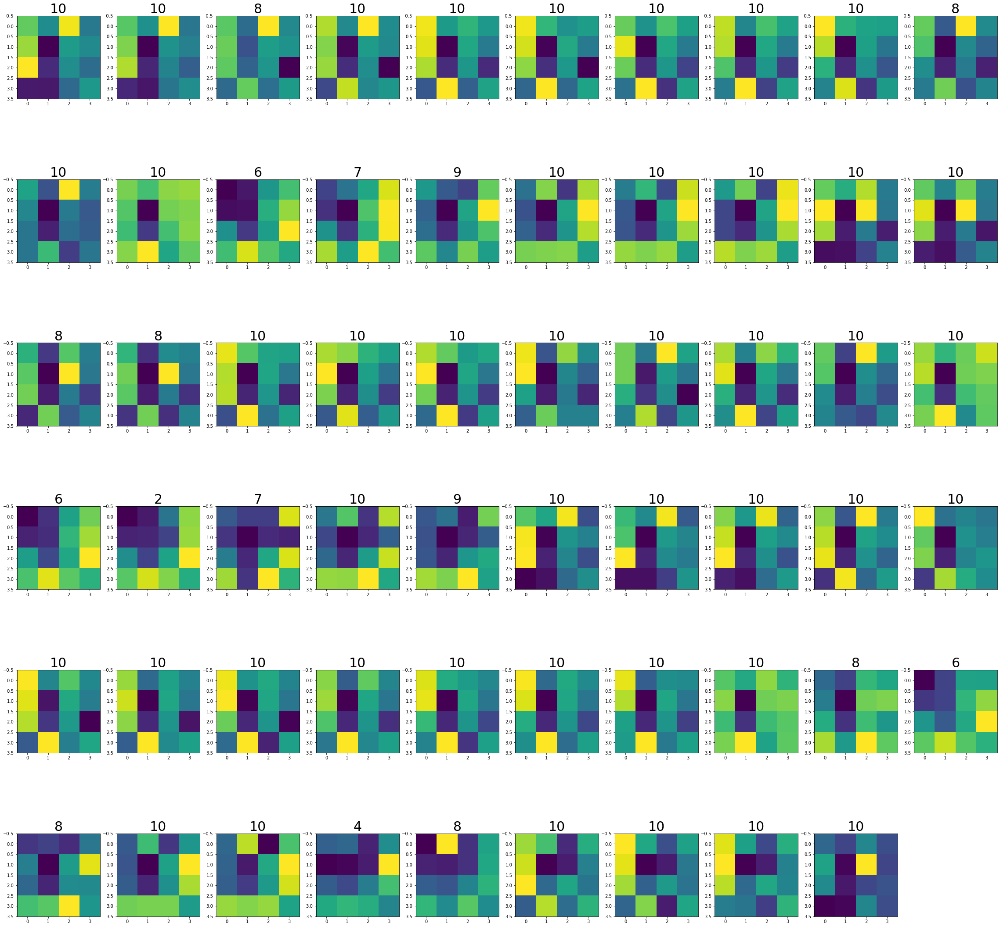

In [32]:
plt.figure(figsize=(40, 40))
for i, (image, label) in enumerate(image_and_label_train[1000:60000:1000]):
    plt.subplot(6,10,i+1)
    plt.imshow(image)
    plt.title(label, size=30)

In [172]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Conv2D, MaxPool2D, Dense, AvgPool2D
from tensorflow.keras.utils import to_categorical

In [181]:
model12 = Sequential()
model12.add(Conv2D(16, (2, 2), activation='relu', input_shape=(4, 4, 1), padding='SAME'))
model12.add(AvgPool2D(pool_size=(2, 2)))
model12.add(Flatten())
model12.add(Dense(128, activation='relu'))
model12.add(Dense(64, activation='relu'))
model12.add(Dense(12, activation='softmax')
)

In [182]:
model12.summary()

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 4, 4, 16)          80        
                                                                 
 average_pooling2d_19 (Avera  (None, 2, 2, 16)         0         
 gePooling2D)                                                    
                                                                 
 flatten_13 (Flatten)        (None, 64)                0         
                                                                 
 dense_38 (Dense)            (None, 128)               8320      
                                                                 
 dense_39 (Dense)            (None, 64)                8256      
                                                                 
 dense_40 (Dense)            (None, 12)                780       
                                                     

In [137]:
y_train_ohe = to_categorical(y_train)
y_test_ohe = to_categorical(y_test)
y_hidden_ohe = to_categorical(y_hidden)

In [138]:
print(image_train.shape)
print(y_train_ohe.shape)
print(image_test.shape)
print(y_test_ohe.shape)

(1170511, 4, 4, 1)
(1170511, 12)
(136786, 4, 4, 1)
(136786, 12)


In [139]:
def score_tf(y_true, y_pred):
    import numpy as np
    matrix_path = 'penalty_matrix_ordered.npy'
    A = np.load(matrix_path)
    arg_y_true = K.argmax(y_true, axis=1)
    arg_y_pred = K.argmax(y_pred, axis=1)
    S = 0.0
    for i in range(0, len(arg_y_true)):
        S -= (K.cast(A,K.floatx())[arg_y_true[i], arg_y_pred[i]]) 
    return S / K.cast(len(arg_y_true),K.floatx())

In [140]:
#model.compile(optimizer=tf.keras.optimizers.Adam(), loss=tf.keras.losses.CategoricalCrossentropy(), metrics=['accuracy'])
model12.compile(optimizer=tf.keras.optimizers.Adam(), loss=tf.keras.losses.CategoricalCrossentropy(), metrics=[score_tf])

In [141]:
history = model12.fit(image_train, y_train_ohe, epochs=5, validation_data=(image_test, y_test_ohe), batch_size=50)

Epoch 1/5
23411/23411 [==============================] - 73s 3ms/step - loss: 0.9753 - score_tf: -0.9300 - val_loss: 0.9887 - val_score_tf: -0.9618
Epoch 2/5
23411/23411 [==============================] - 70s 3ms/step - loss: 0.9300 - score_tf: -0.8797 - val_loss: 0.9772 - val_score_tf: -0.9427
Epoch 3/5
23411/23411 [==============================] - 71s 3ms/step - loss: 0.9089 - score_tf: -0.8432 - val_loss: 0.9355 - val_score_tf: -0.8486
Epoch 4/5
23411/23411 [==============================] - 71s 3ms/step - loss: 0.8943 - score_tf: -0.8276 - val_loss: 0.9282 - val_score_tf: -0.8419
Epoch 5/5
23411/23411 [==============================] - 71s 3ms/step - loss: 0.8802 - score_tf: -0.8152 - val_loss: 0.9096 - val_score_tf: -0.8423


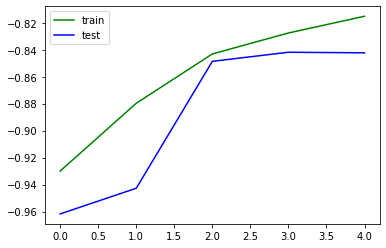

In [142]:
import matplotlib.pyplot as plt
plt.plot(history.history['score_tf'], color='green', label='train')
plt.plot(history.history['val_score_tf'], color='blue', label='test')
plt.legend()
plt.show()

In [143]:
y_train_pred = model12.predict(image_train)
y_test_pred = model12.predict(image_test)
y_hidden_pred = model12.predict(image_hidden)

3825/3825 [==============================] - 4s 1ms/step


In [155]:
arg_y_true_train = K.argmax(y_train_ohe, axis=1)
arg_y_pred_train = K.argmax(y_train_pred, axis=1)
arg_y_true_test = K.argmax(y_test_ohe, axis=1)
arg_y_pred_test = K.argmax(y_test_pred, axis=1)
arg_y_true_hidden = K.argmax(y_hidden_ohe, axis=1)
arg_y_pred_hidden = K.argmax(y_hidden_pred, axis=1)

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.7889490755492373
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Chlk', 'Hal', 'Lims', 'SS', 'SS-Sh', 'Sh']
Not exist in l1 or l2: ['Anhy' 'Coal' 'Dol' 'Marl' 'Tuf']
              precision    recall  f1-score   support

        Anhy       0.00      0.00      0.00       597
        Chlk       0.47      0.29      0.36      2905
        Coal       0.00      0.00      0.00       244
         Dol       0.00      0.00      0.00       287
         Hal       0.89      0.95      0.92      6498
        Lims       0.44      0.56      0.50      8374
        Marl       0.00      0.00      0.00      4396
          SS       0.45      0.61      0.51     14045
       SS-Sh       0.16      0.01      0.02     12283
          Sh       0.81      0.93      0.86     71827
         Tuf       0.00      0.00      0.00       941

    accuracy 

d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
d:\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1327: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


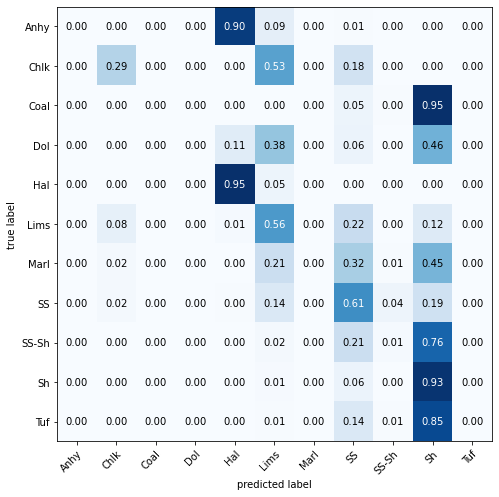

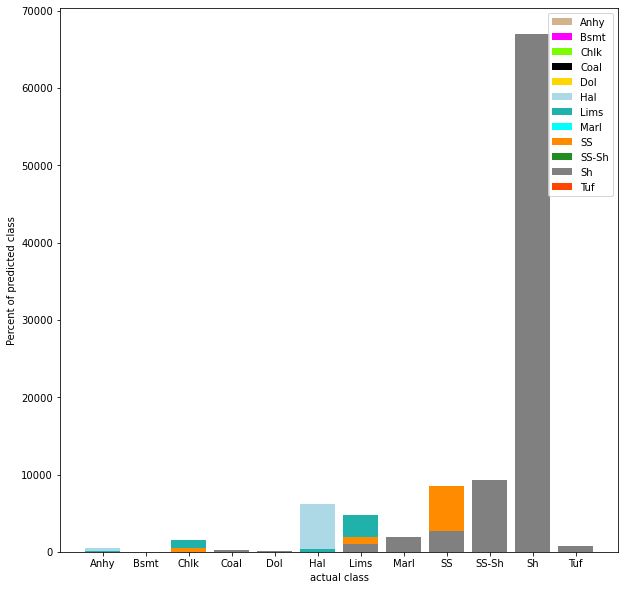

In [169]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(arg_y_true_hidden.numpy(), arg_y_pred_hidden.numpy()))
print(clf_rep(arg_y_true_hidden, arg_y_pred_hidden, le))
cm_plot(arg_y_true_hidden, arg_y_pred_hidden, le)
error_plot(arg_y_true_hidden, arg_y_pred_hidden, le)

In [163]:
hidden_cnn_res = hidden_form.copy()
hidden_cnn_res['CNN_TM'] = arg_y_pred_hidden

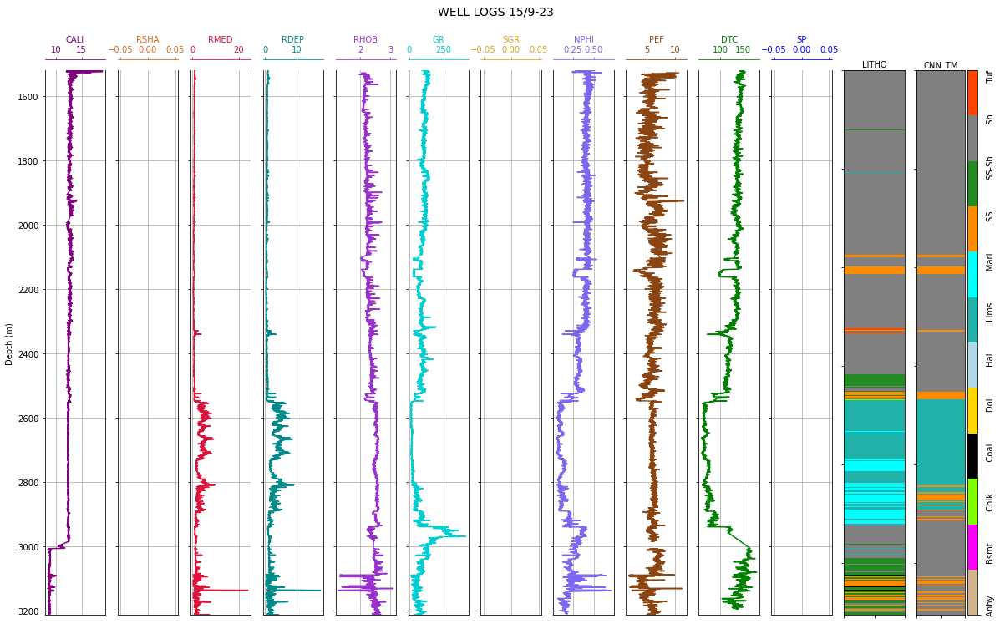

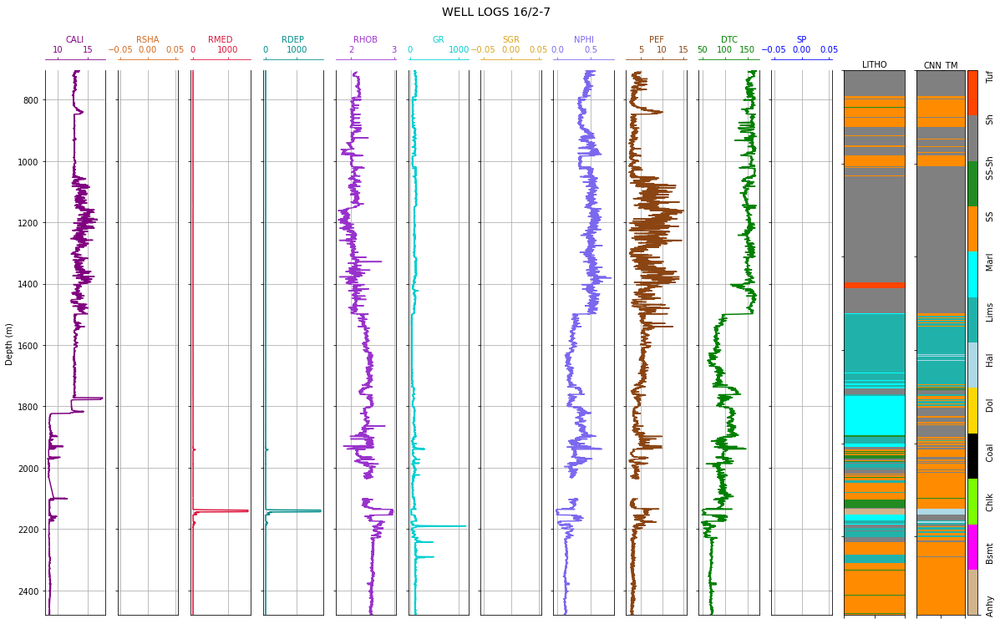

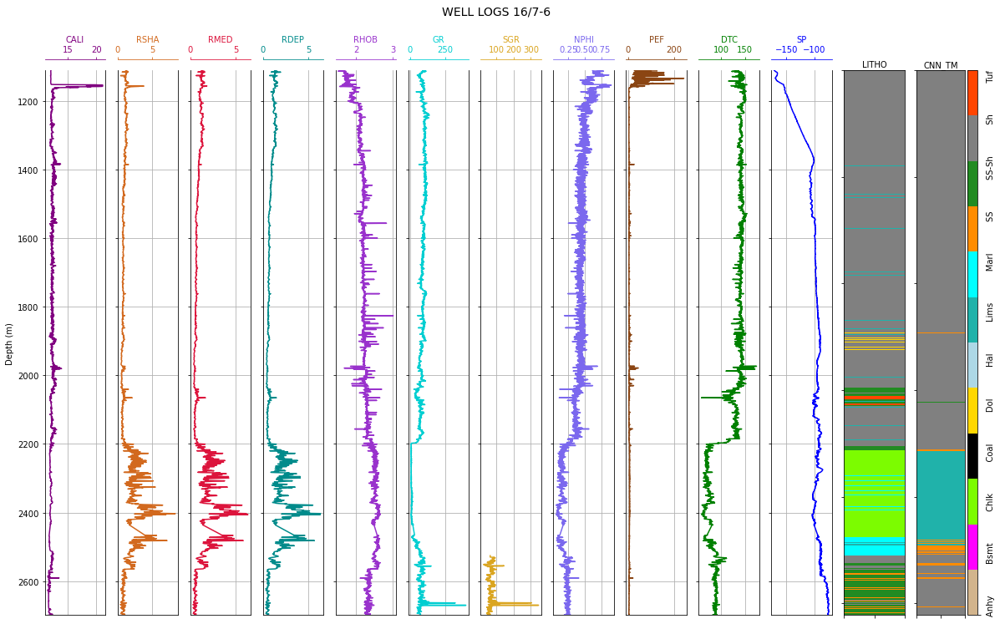

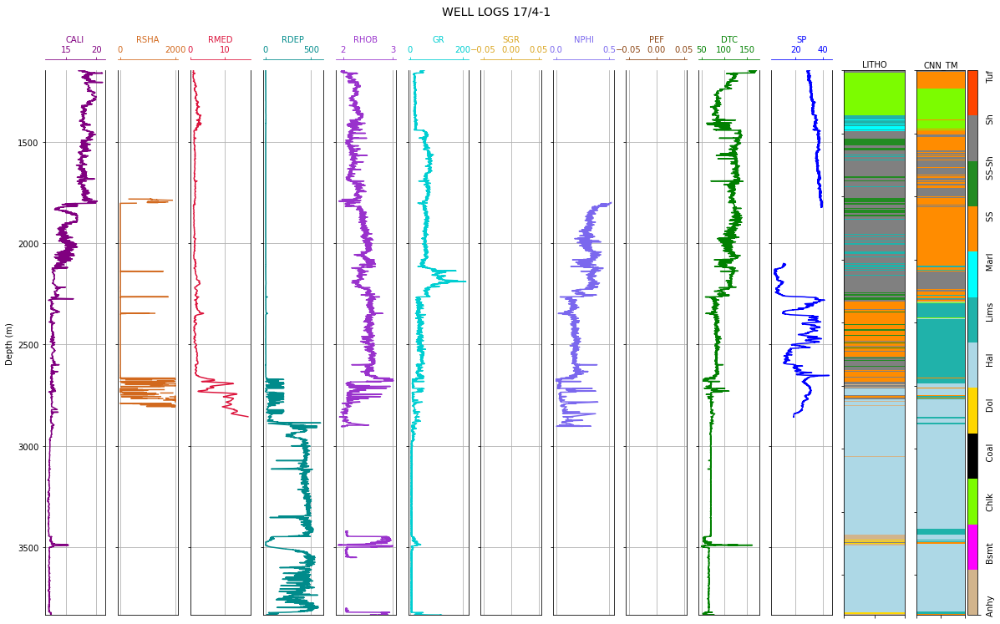

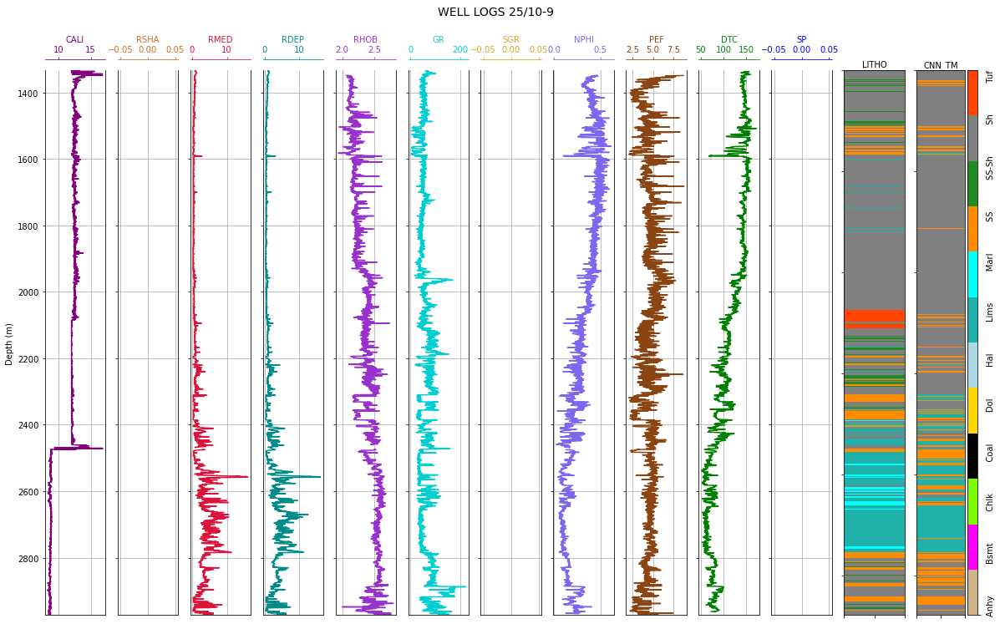

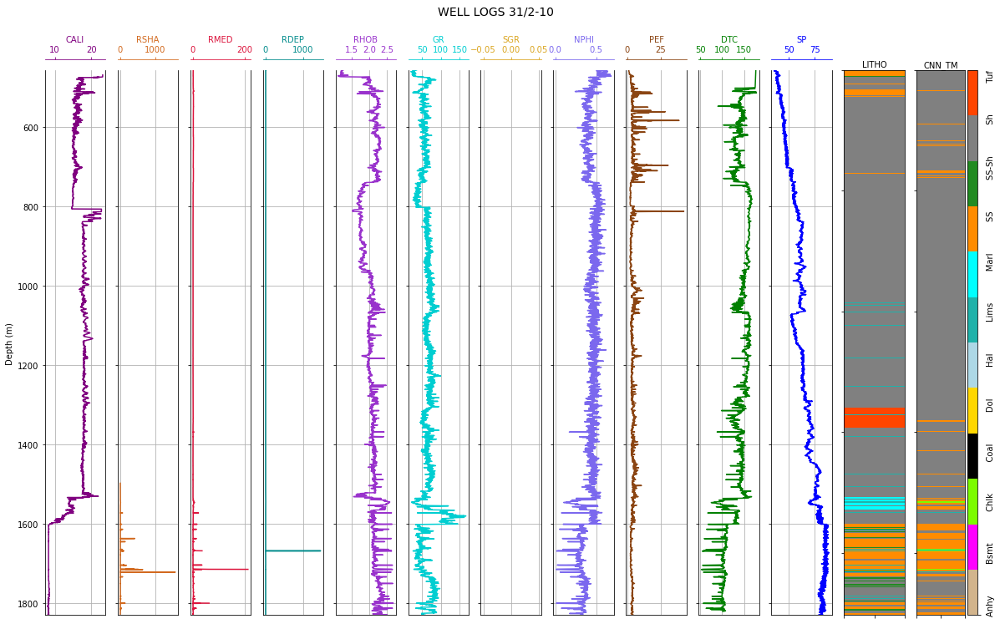

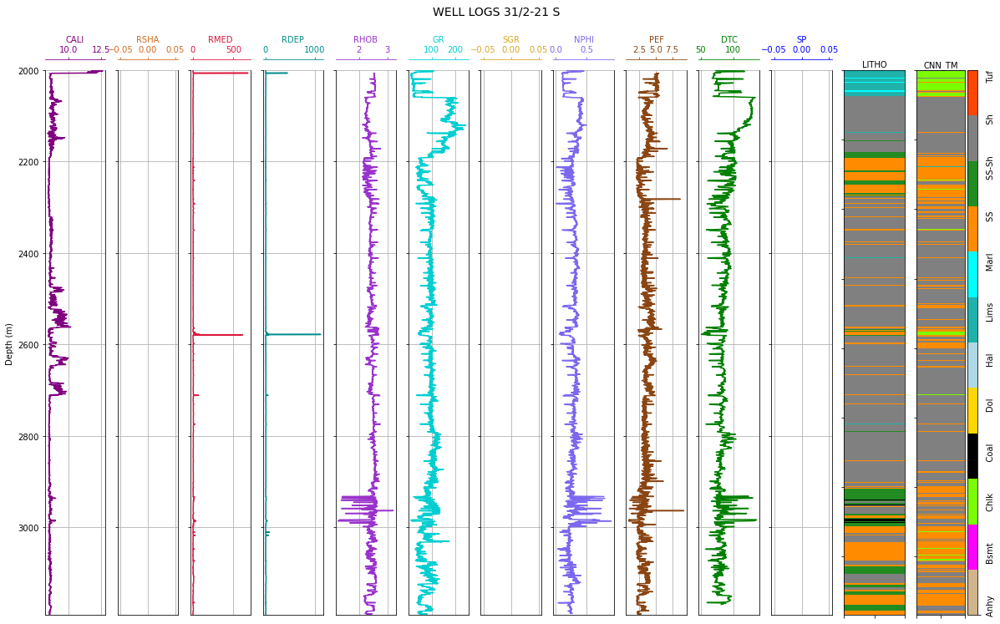

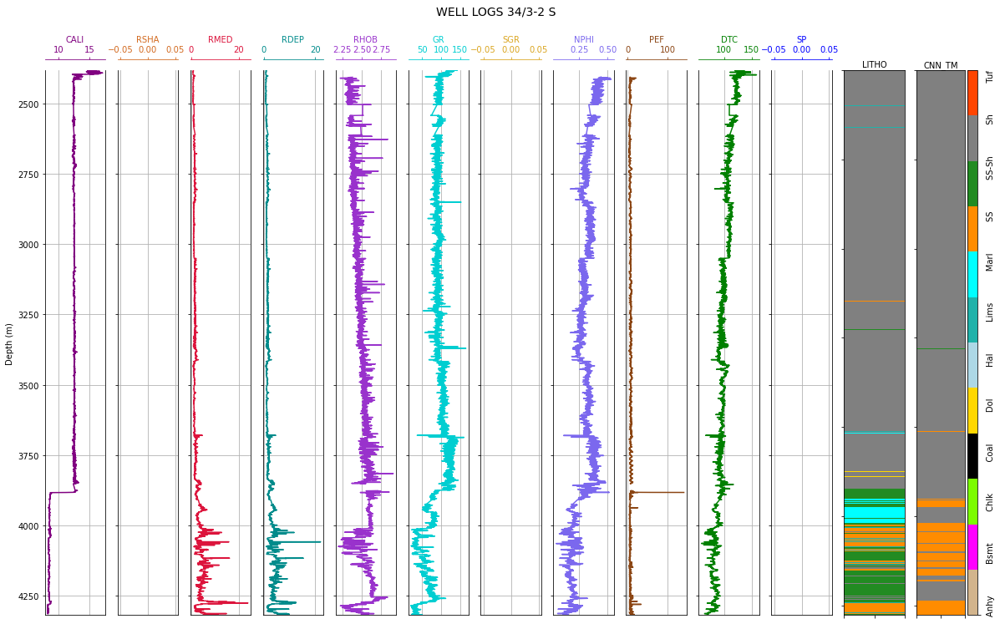

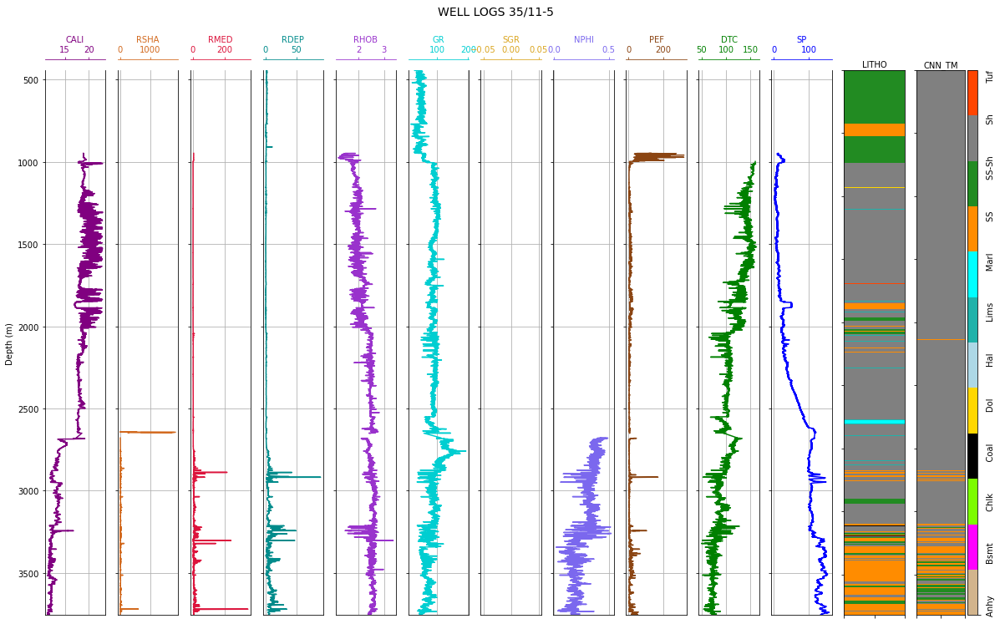

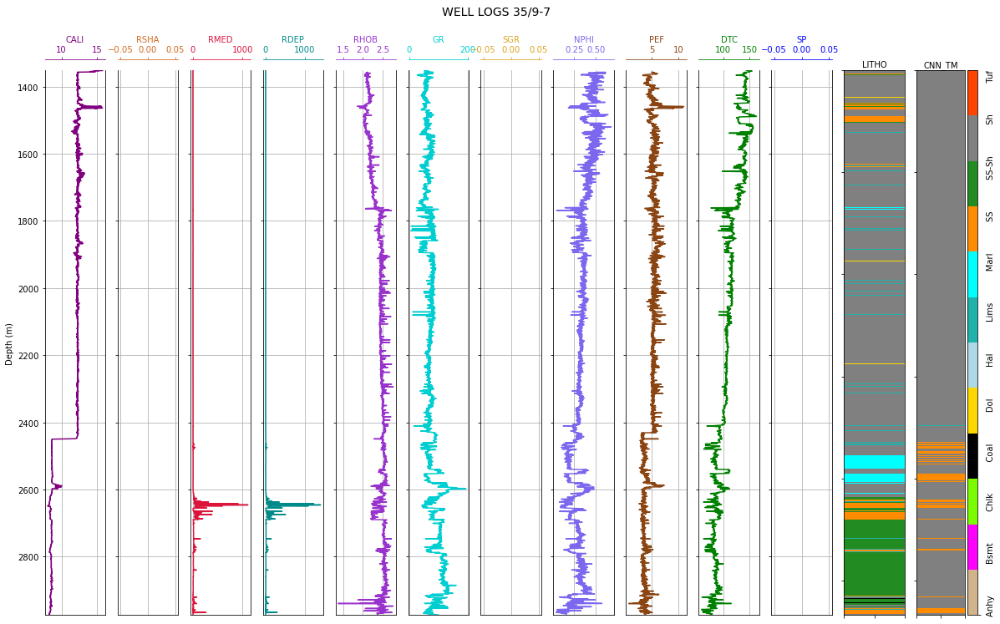

In [164]:
for i in range(0, 10):
  litho_prediction(hidden_cnn_res, i, 1, le)

###  $\color{blue}{\text{10. Blender (Voting)}}$

In [9]:
y_train = train_scaled.iloc[:, -1]

In [10]:
np.unique(y_train, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11], dtype=int64),
 array([  1085,    103,  10513,   3820,   1688,   8213,  56320,  33329,
        168937, 150455, 720803,  15245], dtype=int64))

In [8]:
#{0: 1085, 1: 103, 2: 10513, 3: 3820, 4:1688, 5:8213, 6:56320, 7:33329, 8:168937, 9:150455, 10:720803, 11:15245}
#1
{0: 3000, 1: 1000, 2: 10513, 3: 6000, 4:8000, 5:10000, 6:56320, 7:33329, 8:168937, 9:150455, 10:720803, 11:20000}
#2
{0: 1085, 1: 103, 2: 40000, 3: 6000, 4:20000, 5:8213, 6:56320, 7:33329, 8:168937, 9:150455, 10:720803, 11:15245}
#============================================
# score 1
# over
{0: 1085, 1: 103, 2: 40000, 3: 8000, 4:10000, 5:8213, 6:56320, 7:33329, 8:168937, 9:150455, 10:720803, 11:22000}
# under 
{0: 1085, 1: 103, 2: 40000, 3: 8000, 4:10000, 5:8213, 6:56320, 7:15000, 8:168937, 9:150455, 10:720803, 11:22000}
#============================================
#smt
{0: 1085, 1: 103, 2: 45000, 3: 10000, 4:10000, 5:8213, 6:56320,7:33329, 8:168937, 9:150455, 10:720803, 11:24000}
#under
{0: 1085, 1: 103, 2: 45000, 3: 10000, 4:10000, 5:8213, 6:56320, 7:14000, 8:168937, 9:150455, 10:720803, 11:24000}


{0: 1085,
 1: 103,
 2: 40000,
 3: 6000,
 4: 20000,
 5: 8213,
 6: 56320,
 7: 33329,
 8: 168937,
 9: 150455,
 10: 720803,
 11: 15245}

In [23]:
def run_Balanced_Blender(train_scaled, test_scaled, hidden_scaled):
          
  from xgboost import XGBClassifier
  from sklearn.ensemble import RandomForestClassifier
  from sklearn.model_selection import StratifiedKFold
  from sklearn.ensemble import VotingClassifier
  from catboost import CatBoostClassifier
  from sklearn.utils.class_weight import compute_class_weight
  import numpy as np
  import pandas as pd
  from sklearn.metrics import accuracy_score, f1_score
 
  # selected features to be used while training
  #selected_fetures_xgb = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
  #                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
  #                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
  #                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

  #x_train = train_scaled[selected_fetures_xgb]
  #y_train = train_scaled['LITHO']

  #x_test = test_scaled[selected_fetures_xgb]
  #y_test = test_scaled['LITHO']

  #x_hidden = hidden_scaled[selected_fetures_xgb]
  #y_hidden = hidden_scaled['LITHO']
  from imblearn.over_sampling import SMOTE
  sm = SMOTE(sampling_strategy = {0: 1085, 1: 103, 2: 40000, 3: 6000, 4:20000, 5:8213, 6:56320,
                                  7:33329, 8:168937, 9:150455, 10:720803, 11:15245}, random_state=42)
  x_train = train_scaled.iloc[:, :-1]
  y_train = train_scaled.iloc[:, -1]
  X_resampled, y_resampled = sm.fit_resample(x_train, y_train)



  x_test = test_scaled.iloc[:, :-1]
  y_test = test_scaled.iloc[:, -1]

  x_hidden = hidden_scaled.iloc[:, :-1]
  y_hidden = hidden_scaled.iloc[:, -1]
  class_weights = compute_class_weight(
                                          class_weight = "balanced",
                                          classes = np.unique(y_train),
                                          y = y_train                                                    
                                      )
  class_weights = dict(zip(np.unique(y_train), class_weights))
  del x_train
  del y_train
  """The model is trained on 10 stratified k-folds, also uses the open set as 
  validation set to avoid overfitting and a 100-round early stopping callback.
  The model uses a multi-soft_probability objective function which returns the
  probabilities predicted for each class. This probabilities are computed and
  stacked by using each k-fold to give the final prediction.
  """


  split = 10
  kf = StratifiedKFold(n_splits=split, shuffle=True, random_state=0)
  train_pred = np.zeros((len(X_resampled), 12))
  test_pred = np.zeros((len(x_test), 12))
  hidden_pred = np.zeros((len(x_hidden), 12))

  clf1 = XGBClassifier(n_estimators=1000, max_depth=4,
                                 booster='gbtree', objective='multi:softprob',
                                 learning_rate=0.075, random_state=42,
                                 subsample=1, colsample_bytree=1,
                                 tree_method='gpu_hist', predictor='gpu_predictor',
                                 verbose=2020, reg_lambda=1500
                                 )
  clf2 = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.1,
                               depth = 6,
                               l2_leaf_reg = 300,
                               #border_count = 128,
                               #bagging_temperature = 10,
                               grow_policy = 'SymmetricTree',
                               task_type='GPU',
                               verbose=100)


  clf = VotingClassifier(estimators=[('xgb', clf1), ('catb', clf2)], voting='soft')

  i = 1
  for (train_index, test_index) in kf.split(pd.DataFrame(X_resampled), pd.DataFrame(y_resampled)):
    X_train, X_test = pd.DataFrame(X_resampled).iloc[train_index], pd.DataFrame(X_resampled).iloc[test_index]
    Y_train, Y_test = pd.DataFrame(y_resampled).iloc[train_index],pd.DataFrame(y_resampled).iloc[test_index]
    clf.fit(X_train, Y_train)
    prediction = clf.predict(X_test)
    print('Fold accuracy:', accuracy_score(Y_test, prediction))
    print(f'F1 is:', f1_score(prediction, Y_test, average="weighted"))
    print(f'-----------------------FOLD {i}---------------------')
    i+=1
    train_pred += clf.predict_proba(pd.DataFrame(X_resampled))
    test_pred += clf.predict_proba(pd.DataFrame(x_test))
    hidden_pred += clf.predict_proba(pd.DataFrame(x_hidden))

  train_pred= pd.DataFrame(train_pred/split)
  test_pred= pd.DataFrame(test_pred/split)
  hidden_pred= pd.DataFrame(hidden_pred/split)
  train_pred = np.array(pd.DataFrame(train_pred).idxmax(axis=1))
  test_pred = np.array(pd.DataFrame(test_pred).idxmax(axis=1))
  hidden_pred = np.array(pd.DataFrame(hidden_pred).idxmax(axis=1))
  print('---------------CROSS VALIDATION COMPLETE-----------------')

  return train_pred, test_pred, hidden_pred

In [24]:
import warnings
warnings.filterwarnings("ignore")

train_pred_blanced, train_pred_blanced, test_pred_blanced, hidden_pred_blanced = run_Balanced_Blender(train_scaled, test_scaled, hidden_scaled)

[16:49:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[16:49:18] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[0]	validation_0-mlogloss:2.25343
[100]	validation_0-mlogloss:0.49759
[200]	validation_0-mlogloss:0.42032
[300]	validation_0-mlogloss:0.38651
[400]	validation_0-mlogloss:0.36480
[500]	validation_0-mlogloss:0.34870
[600]	validation_0-mlogloss:0.33609
[700]	validation_0-mlogloss:0.32577
[800]	validation

[200]	validation_0-mlogloss:0.42251
[300]	validation_0-mlogloss:0.38869
[400]	validation_0-mlogloss:0.36650
[500]	validation_0-mlogloss:0.34943
[600]	validation_0-mlogloss:0.33680
[700]	validation_0-mlogloss:0.32642
[800]	validation_0-mlogloss:0.31716
[900]	validation_0-mlogloss:0.30906
[999]	validation_0-mlogloss:0.30257
Default score: -0.27416399450297757
Fold accuracy: 0.8975116157319547
F1 is: 0.9009285920261728
-----------------------FOLD 7---------------------
[19:30:00] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "verbose" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[19:30:02] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default e

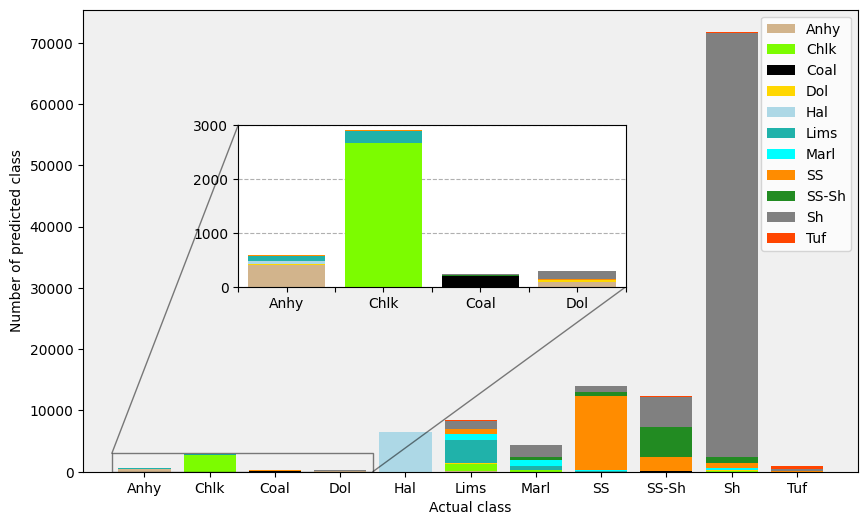

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

y_true = hidden_scaled.LITHO.values
y_pred = hidden_pred_blanced

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_names = np.array(['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS',
       'SS-Sh', 'Sh', 'Tuf'], dtype=object)
colors = ['tan', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']

support = np.sum(cm, axis=1)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(len(class_names)):
    ax.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
plt.xticks(range(len(support)), [class_names[i] for i in range(len(support))])
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')

# Display
ax.set_facecolor('#f0f0f0')

ax_zoom = ax.inset_axes([0.2, 0.4, 0.5, 0.35])

for i in range(len(class_names)):
    ax_zoom.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
ax_zoom.set_xticklabels(class_names)
labels = [item.get_text() for item in ax_zoom.get_xticklabels()]
labels[0] = ''; labels[1] = 'Anhy'; labels[2] = ''; labels[3] = 'Chlk'; labels[4] = ''; labels[5] = 'Coal'
labels[6] = ''; labels[7] = 'Dol'
ax_zoom.set_xticklabels(labels)

ax_zoom.set_xlim(-0.5, 3.5)
ax_zoom.set_ylim(0, 3000)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")


ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')
ax.legend(fontsize="10", loc ="upper right")

plt.savefig('balanced.pdf')
plt.show()


-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.44857104340792664
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.75      0.70      0.72       597
        Chlk       0.66      0.92      0.77      2905
        Coal       0.71      0.80      0.75       244
         Dol       0.16      0.16      0.16       287
         Hal       0.99      0.99      0.99      6498
        Lims       0.75      0.53      0.62      8374
        Marl       0.14      0.10      0.12      4396
          SS       0.77      0.83      0.80     14045
       SS-Sh       0.66      0.44      0.53     12283
          Sh       0.88      0.94      0.91     71827
         Tuf       0.61      0.53      0.57       941

    ac

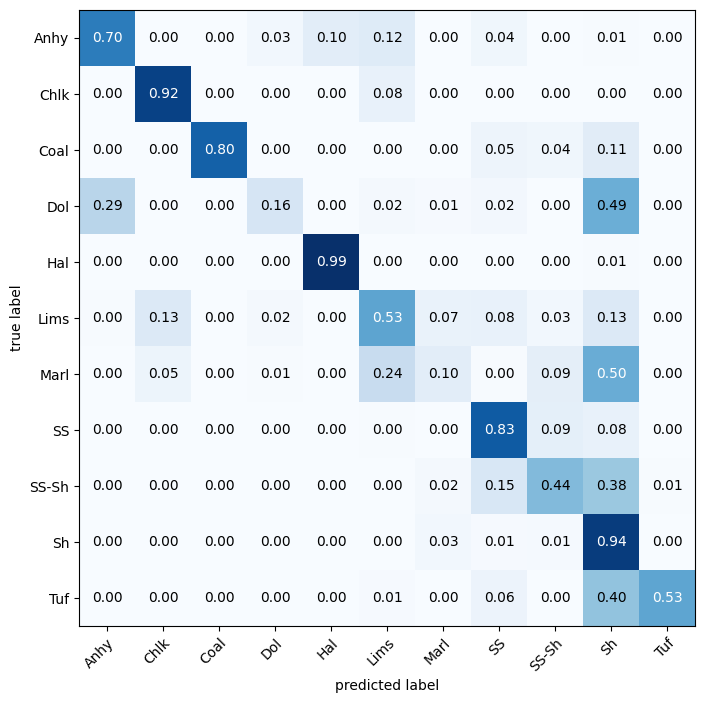

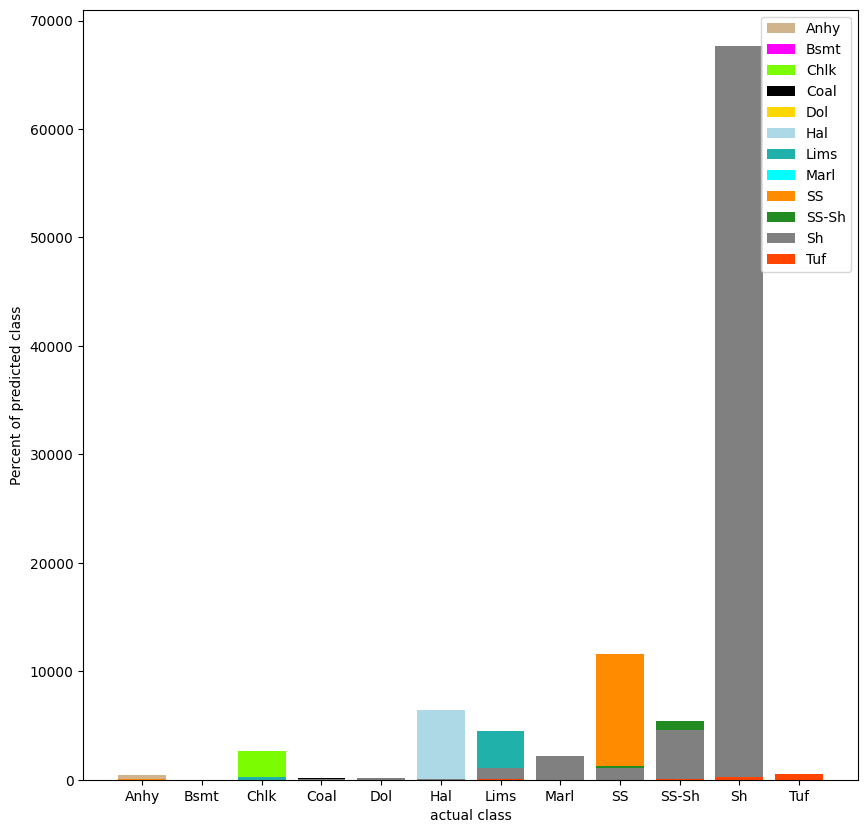

In [22]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_blanced))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_blanced, le))
cm_plot(hidden_scaled.LITHO.values, hidden_pred_blanced, le)
error_plot(hidden_scaled.LITHO.values, hidden_pred_blanced, le)

###  $\color{blue}{\text{11. Deep insight - v2}}$

In [47]:
#selectedfeature = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
#                   'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
#                   'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
#                    'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [48]:
#from sklearn.decomposition import KernelPCA
#reducer = KernelPCA(n_components=2, kernel='cosine', eigen_solver='auto', n_jobs=-1, random_state=5221)

In [49]:
from sklearn.manifold import TSNE

reducer = TSNE(
    n_components=2,
    metric='cosine',
    init='random',
    learning_rate='auto',
    n_jobs=-1,
    random_state=5221
)

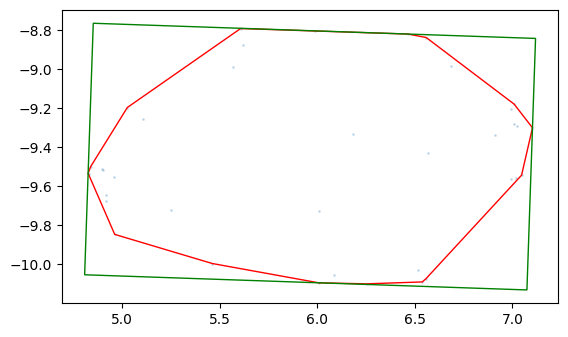

In [50]:
from pyDeepInsight import ImageTransformer
it = ImageTransformer(feature_extractor=reducer, discretization='assignment', pixels=(8, 8))
it.fit(X_train,y_train, plot=True)

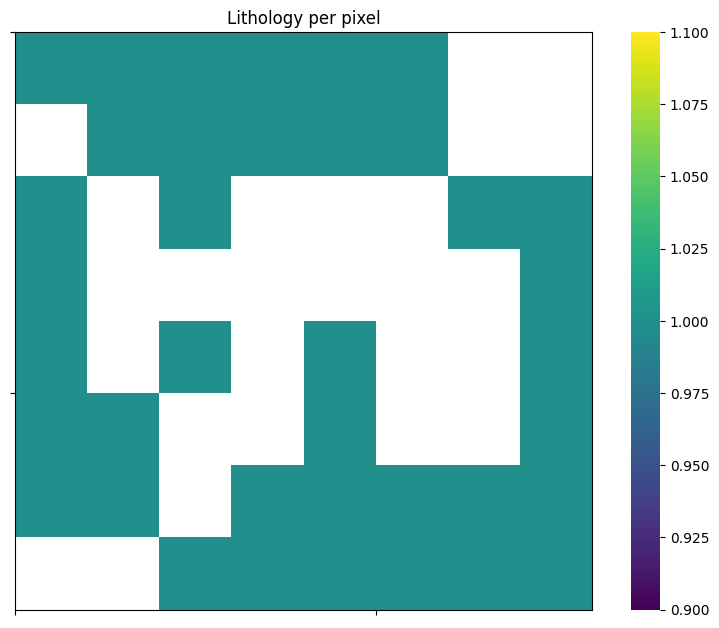

In [51]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns

fdm = it.feature_density_matrix()
fdm[fdm == 0] = np.nan

plt.figure(figsize=(10, 7.5))

ax = sns.heatmap(fdm, cmap="viridis", linewidths=0., 
                 linecolor="lightgrey", square=True)
ax.xaxis.set_major_locator(ticker.MultipleLocator(5))
ax.yaxis.set_major_locator(ticker.MultipleLocator(5))
for _, spine in ax.spines.items():
    spine.set_visible(True)
_ = plt.title("Lithology per pixel")

In [52]:
X_train_img = it.transform(X_train, img_format='rgb')
X_test_img = it.transform(X_test, img_format='rgb')
X_hidden_img = it.transform(X_hidden, img_format='rgb')

print(X_train_img.shape)
print(X_test_img.shape)
print(X_hidden_img.shape)

(1170511, 8, 8, 3)
(136786, 8, 8, 3)
(122397, 8, 8, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


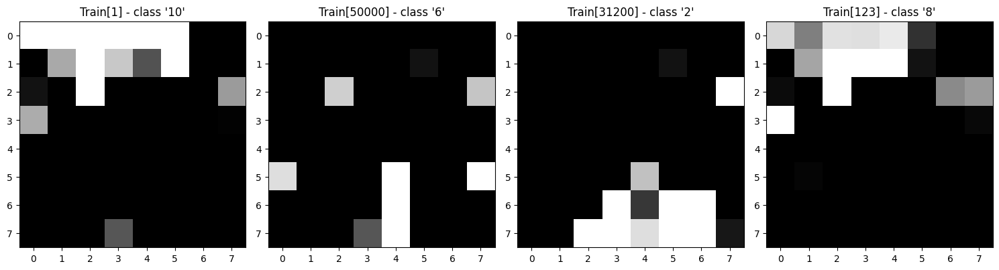

In [105]:
from matplotlib import pyplot as plt
fig, ax = plt.subplots(1, 4, figsize=(15, 5))
for i,v in enumerate([1, 50000, 31200, 123]):
    ax[i].imshow(X_hidden_img[v])
    ax[i].title.set_text(f"Train[{v}] - class '{y_train[v]}'")
plt.tight_layout()
plt.savefig('CNN-deepInsight.pdf')

In [54]:
import tensorflow.keras.layers as L
import keras

In [39]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Conv2D, MaxPool2D, Dense, AvgPool2D, BatchNormalization, Dropout
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
import tensorflow.keras.layers as L
import keras
model = Sequential()
model.add(Conv2D(16, (2, 2), activation='relu', input_shape=(8, 8, 3)))
model.add(AvgPool2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(40, activation='relu'))
model.add(Dense(20, activation='relu'))
model.add(Dense(12, activation='softmax'))

In [23]:
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
import tensorflow.keras.layers as L
import keras
inputs = layers.Input(shape=(8, 8, 3))
x = layers.Rescaling(1./255)(inputs)
x = layers.Conv2D(filters=32, kernel_size=2, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2, padding='same')(x)
x = layers.Conv2D(filters=64, kernel_size=2, activation="relu")(x)
x = layers.MaxPooling2D(pool_size=2, padding='same')(x)
x = layers.Flatten()(x)
x = L.Dense(40, activation='relu')(x)
x = layers.Dropout(0.1)(x)
x = L.Dense(20, activation='relu')(x)
outputs = layers.Dense(12, activation="softmax")(x)
model = keras.Model(inputs=inputs, outputs=outputs)

In [26]:
from tensorflow.keras.utils import plot_model

In [27]:
from keras.utils import plot_model
plot_model(model, to_file='model.png')

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model/model_to_dot to work.


In [83]:
model.compile(optimizer=tf.keras.optimizers.Adamax(learning_rate=0.001),
              loss='categorical_crossentropy',
              metrics=['accuracy']) 

In [40]:
model.compile(optimizer=tf.keras.optimizers.Adamax(),
              loss='categorical_crossentropy',
              metrics=['accuracy']) 

In [84]:
from tensorflow.keras.utils import to_categorical
y_train_ohe = to_categorical(y_train)
y_test_ohe = to_categorical(y_test)
y_hidden_ohe = to_categorical(y_hidden)

In [85]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
es = EarlyStopping(monitor='val_loss', mode='min', patience=5)
mch = ModelCheckpoint('best_CNN.h5', monitor='val_loss', mode='min', save_best_only=True)
rlrop = ReduceLROnPlateau(monitor='val_loss', patience=3, factor=0.2, min_lr=0.001)

In [86]:
history = model.fit(X_train_img, y_train_ohe, epochs=10,
                    validation_data=(X_test_img, y_test_ohe), batch_size=100, callbacks=[mch]
                   )

Epoch 1/10
11706/11706 [==============================] - 75s 6ms/step - loss: 0.9257 - accuracy: 0.7022 - val_loss: 0.8990 - val_accuracy: 0.7178
Epoch 2/10
11706/11706 [==============================] - 73s 6ms/step - loss: 0.6516 - accuracy: 0.7823 - val_loss: 0.8157 - val_accuracy: 0.7456
Epoch 3/10
11706/11706 [==============================] - 72s 6ms/step - loss: 0.5782 - accuracy: 0.8080 - val_loss: 0.7731 - val_accuracy: 0.7472
Epoch 4/10
11706/11706 [==============================] - 71s 6ms/step - loss: 0.5378 - accuracy: 0.8210 - val_loss: 0.8028 - val_accuracy: 0.7485
Epoch 5/10
11706/11706 [==============================] - 71s 6ms/step - loss: 0.5072 - accuracy: 0.8306 - val_loss: 0.8199 - val_accuracy: 0.7582
Epoch 6/10
11706/11706 [==============================] - 70s 6ms/step - loss: 0.4847 - accuracy: 0.8379 - val_loss: 0.8172 - val_accuracy: 0.7387
Epoch 7/10
11706/11706 [==============================] - 71s 6ms/step - loss: 0.4673 - accuracy: 0.8438 - val_loss: 0

In [87]:
#from keras.models import load_model
#model = load_model('best_CNN.h5')

In [91]:
model.save('deep.h5')

In [90]:
y_train_pred = np.argmax(model.predict(X_train_img), axis=1)
y_test_pred =a np.argmax(model.predict(X_test_img), axis=1)
y_hidden_pred = np.argmax(model.predict(X_hidden_img), axis=1)

3825/3825 [==============================] - 7s 2ms/step


-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.526272090002206
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: ['Dol']
              precision    recall  f1-score   support

        Anhy       0.85      0.31      0.46       597
        Chlk       0.66      0.46      0.54      2905
        Coal       0.80      0.46      0.59       244
         Dol       0.00      0.00      0.00       287
         Hal       0.99      0.97      0.98      6498
        Lims       0.61      0.58      0.59      8374
        Marl       0.65      0.30      0.41      4396
          SS       0.69      0.77      0.73     14045
       SS-Sh       0.45      0.37      0.41     12283
          Sh       0.87      0.93      0.90     71827
         Tuf       0.49      0.63      0.55       941

    accura

G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


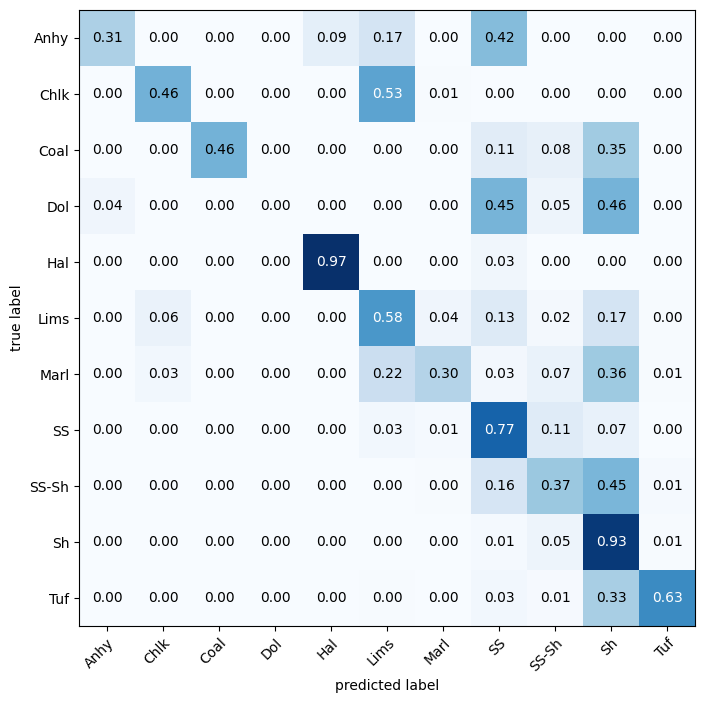

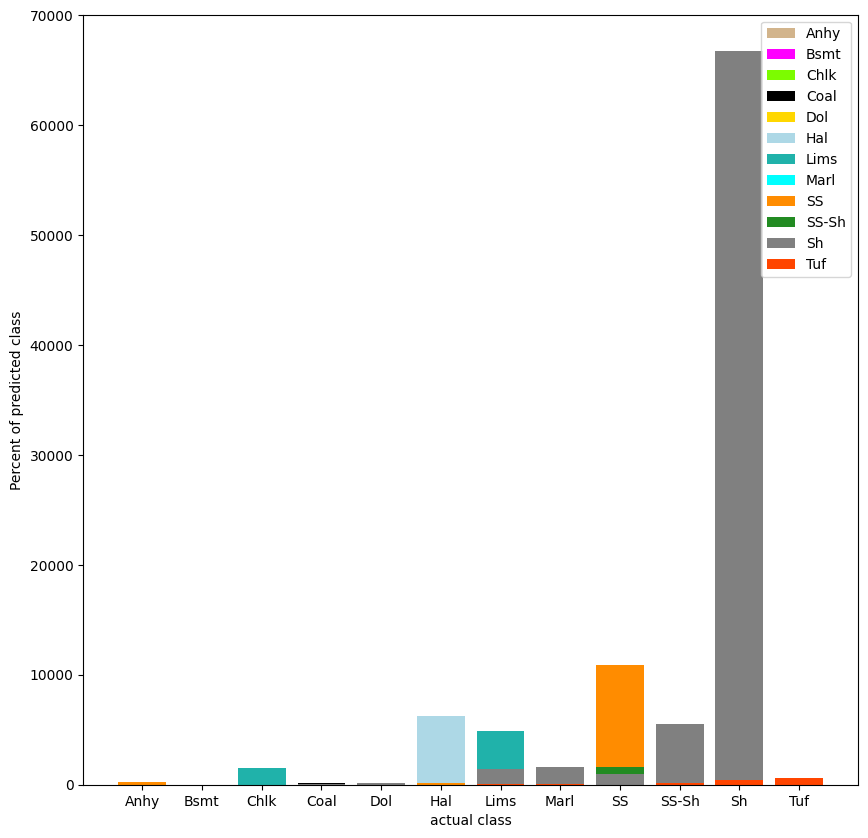

In [94]:
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, y_hidden_pred))
print(clf_rep(hidden_scaled.LITHO.values, y_hidden_pred, le))
cm_plot(hidden_scaled.LITHO.values, y_hidden_pred, le)
error_plot(hidden_scaled.LITHO.values, y_hidden_pred, le)

#  $\color{red}{\text{B. other Noval approches for classification}}$
GrowNet in sections 3.1.1 to 3.1.3

## Boosting and Stacking Neural Networks

 Boosting and Stacking Neural Networks \
 1- “GrowNet” by Sarkan Badirli et al. \
 2- “XBNet” by Tushar Sarkar:

### GrowNet

In [23]:
import grow_net
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
import tensorflow.keras.models as M

In [24]:
#all
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
# good
#selectedfeature = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
#                      'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
#                      'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
#                      'PEF', 'RDEP', 'DTS_COMB', 'G', 'SP',
#                      'Cluster', 'K', 'P_I', 'DRHO', 'DCAL'
#                        ]
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values
print(len(selectedfeature))

38


In [25]:
inp = L.Input(X_train.shape[1])
x = L.BatchNormalization()(inp)
x = L.Dense(64, activation="relu")(x)
x = L.Dense(128, activation="relu")(x)
x = L.BatchNormalization()(x)
#x = L.Dropout(0.25)(x)
x = L.Dense(32, activation="relu")(x)
x = L.BatchNormalization()(x)
out = L.Dense(12, activation='softmax')(x)
model = M.Model(inp, out)

In [74]:
numElements = len(selectedfeature)
inp = L.Input(numElements)
d1 = L.Dense(numElements*4, activation='selu')(inp)
d2 = L.Dense(numElements*8, activation='selu')(d1)
d3 = L.Dense(numElements*16, activation='selu')(d2)
x = L.Reshape((numElements, 16))(d3)
for i in [16, 8, 4]:
    x1a = L.Conv1D(i, 3, padding='same', activation='selu')(x)
    x1b = L.Conv1D(i, 3, padding='same', activation='selu')(x1a)
    x2a = L.Conv1D(i, 5, padding='same', activation='selu')(x)
    x2b = L.Conv1D(i, 3, padding='same', activation='selu')(x2a)
    x3 = L.Conv1D(i, 2, padding='same', activation='selu')(x)
    add = L.Add()([x1b, x2b, x3])
    x = L.AveragePooling1D(2)(add)
    x = L.Conv1D(i, 3, padding='same', activation='selu')(x)
flatten = L.Flatten()(x)
d3 = L.Dense(16, activation='selu')(flatten)
d4 = L.Dense(16, activation='selu')(d3)
out = L.Dense(12, activation='softmax')(d4)
model = keras.models.Model(inputs = inp, outputs = out)


In [75]:
from tensorflow.keras.utils import to_categorical
y_train_ohe= to_categorical(y_train)
y_test_ohe = to_categorical(y_test)
y_hidden_ohe = to_categorical(y_hidden)

In [76]:
model.compile(tf.keras.optimizers.Adam(), 'categorical_crossentropy')

In [77]:
from grow_net import GradientBoost
model = GradientBoost(model, batch_size=200, n_boosting_rounds=3, boost_rate = 1, epochs_per_stage=2)

In [78]:
model.fit(X_train, y_train_ohe,batch_size=400, validation_data = (X_test, y_test_ohe))

Epoch 1/2
2927/2927 [==============================] - 165s 56ms/step - loss: 0.4363 - val_loss: 0.3497
Epoch 2/2
2927/2927 [==============================] - 163s 56ms/step - loss: 0.3333 - val_loss: 0.3106
Epoch 1/2
2927/2927 [==============================] - 269s 91ms/step - loss: 0.3884 - val_loss: 0.3127
Epoch 2/2
36579/36579 [==============================] - 770s 21ms/step - loss: 0.4237 - val_loss: 0.3868
Epoch 1/2
2927/2927 [==============================] - 253s 86ms/step - loss: 0.6946 - val_loss: 0.3185
Epoch 2/2
36579/36579 [==============================] - 823s 22ms/step - loss: 0.3736 - val_loss: 0.3231


In [79]:
hidden_pred = np.argmax(model.predict(X_hidden), axis=1)
print(hidden_pred)
print(y_hidden)
print(clf_rep(y_hidden, hidden_pred, le))

3825/3825 [==============================] - 23s 6ms/step
[10 10 10 ...  8  9 10]
[10 10 10 ... 10 10 10]
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.76      0.38      0.51       597
        Chlk       0.61      0.46      0.53      2905
        Coal       0.88      0.59      0.70       244
         Dol       0.20      0.19      0.20       287
         Hal       0.99      1.00      0.99      6498
        Lims       0.62      0.57      0.59      8374
        Marl       0.47      0.44      0.45      4396
          SS       0.64      0.66      0.65     14045
       SS-Sh       0.42      0.32      0.36     12283
          Sh       0.85      0.90      0.87     71827
         Tuf       0.61      0.47      0.53       941

    accuracy    

### multi chanel model

In [ ]:
import grow_net
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
import tensorflow.keras.models as M

In [ ]:
#all
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
# good
#selectedfeature = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
#                      'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
#                      'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
#                      'PEF', 'RDEP', 'DTS_COMB', 'G', 'SP',
#                      'Cluster', 'K', 'P_I', 'DRHO', 'DCAL'
#                        ]
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values
print(len(selectedfeature))

In [ ]:
modelA = keras.models.Sequential(name='modelA')
modelA.add(L.Input((len(selectedfeature),)))
modelA.add(L.Dense(16, activation='relu'))
modelA.add(L.Dense(16, activation='relu'))
modelA.add(L.Dense(12, activation='softmax'))

modelB = keras.models.Sequential(name='modelB')
modelB.add(L.Input((len(selectedfeature),)))
modelB.add(L.Dense(16, activation='relu'))
modelB.add(L.Dense(16, activation='relu'))
modelB.add(L.Dense(16, activation='relu'))
modelB.add(L.Dense(16, activation='relu'))
modelB.add(L.Dense(12, activation='softmax'))

inp = L.Input((len(selectedfeature),))
dense = L.Dense(16, activation='relu')(inp)
branch1a = L.Dense(16, activation='relu')(dense)
branch1b = L.Dense(16, activation='relu')(branch1a)
branch1c = L.Dense(8, activation='relu')(branch1b)
branch2a = L.Dense(8, activation='relu')(dense)
branch2b = L.Dense(8, activation='relu')(branch2a)
concat = L.Concatenate()([branch1c, branch2b])
out = L.Dense(12, activation='softmax')(concat)
modelC = keras.models.Model(inputs=inp, outputs=out, name='modelC')

modelD = keras.models.Sequential(name='modelD')
modelD.add(L.Input((len(selectedfeature),)))
modelD.add(L.Dense(64, activation='relu'))
modelD.add(L.Reshape((8, 8, 1)))
modelD.add(L.Conv2D(8, (3, 3), padding='same', activation='relu'))
modelD.add(L.Conv2D(8, (3, 3), padding='same', activation='relu'))
modelD.add(L.MaxPooling2D(2, 2))
modelD.add(L.Conv2D(16, (3, 3), padding='same', activation='relu'))
modelD.add(L.Conv2D(16, (3, 3), padding='same', activation='relu'))
modelD.add(L.Flatten())
modelD.add(L.Dense(16, activation='relu'))
modelD.add(L.Dense(12, activation='softmax'))

modelE = keras.models.Sequential(name='modelE')
modelE.add(L.Input((len(selectedfeature),)))
modelE.add(L.Dense(64, activation='relu'))
modelE.add(L.Reshape((64, 1)))
modelE.add(L.Conv1D(8, 3, padding='same', activation='relu'))
modelE.add(L.Conv1D(8, 3, padding='same', activation='relu'))
modelE.add(L.MaxPooling1D(2))
modelE.add(L.Conv1D(16, 3, padding='same', activation='relu'))
modelE.add(L.Conv1D(16, 3, padding='same', activation='relu'))
modelE.add(L.Flatten())
modelE.add(L.Dense(16, activation='relu'))
modelE.add(L.Dense(12, activation='softmax'))

models = {'modelA': modelA,
          'modelB': modelB,
          'modelC': modelC,
          'modelD': modelD,
          'modelE': modelE}

for model in models:
    models[model].trainable = False
inp = L.Input((len(selectedfeature),))
mergeList = []
for model in models:
    modelOut = models[model](inp)
    reshape = L.Reshape((4, 1))(modelOut)
    scale = L.Conv1D(1, 1, use_bias=False)(reshape)
    flatten = L.Flatten()(scale)
    mergeList.append(flatten)
concat = L.Add()(mergeList)
softmax = L.Softmax()(concat)
metaModel = keras.models.Model(inputs=inp, outputs=softmax)

In [ ]:
metaModel.compile(optimizer='adam',
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

In [ ]:
metaModel.fit(X_train, y_train, epochs=5,
          validation_data=(X_test, y_test))

In [ ]:
hidden_pred = np.argmax(metaModel.predict(X_hidden), axis=1)
print(hidden_pred)
print(y_hidden)
print(clf_rep(y_hidden, hidden_pred, le))

In [ ]:
for model in models:
   models[model].trainable = True
metaModel.fit(X_train, y_train, epochs=3,
          validation_data=(X_test, y_test))

### GrowNet proba.

In [44]:
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
import tensorflow.keras.models as M
import numpy as np
import keras
import keras as K
from grow_net_v2 import GradientBoost
from sklearn.metrics import accuracy_score, f1_score
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.utils import to_categorical


selected_fetures_xgb = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

x_train = train_scaled[selected_fetures_xgb]
y_train = train_scaled['LITHO']

x_test = test_scaled[selected_fetures_xgb]
y_test = test_scaled['LITHO']

x_hidden = hidden_scaled[selected_fetures_xgb]
y_hidden = hidden_scaled['LITHO']

split = 5
kf = StratifiedKFold(n_splits=split, shuffle=True)
train_prob_xgb1 = np.zeros((len(x_train), 12))
open_prob_xgb1 = np.zeros((len(x_test), 12))
hidden_prob_xgb1 = np.zeros((len(x_hidden), 12))


inp = L.Input(x_train.shape[1])
x = L.BatchNormalization()(inp)
x = L.Dense(64, activation="relu")(x)
x = L.Dense(128, activation="relu")(x)
x = L.BatchNormalization()(x)
#x = L.Dropout(0.25)(x)
x = L.Dense(32, activation="relu")(x)
x = L.BatchNormalization()(x)
out = L.Dense(12, activation='softmax')(x)
model = M.Model(inp, out)

model.compile(tf.keras.optimizers.SGD(learning_rate=3e-1), 'categorical_crossentropy')
model = GradientBoost(model, batch_size=2000, n_boosting_rounds=2, boost_rate = 1, epochs_per_stage=2)

i = 1
for (train_index, test_index) in kf.split(x_train, y_train):
  X_train, X_test = x_train.iloc[train_index], x_train.iloc[test_index]
  Y_train, Y_test = y_train.iloc[train_index], y_train.iloc[test_index]
  Y_train_ohe= to_categorical(Y_train)
  Y_test_ohe = to_categorical(Y_test)
    
  model.fit(X_train, Y_train_ohe,batch_size=2000, validation_data = (X_test, Y_test_ohe))
  prediction = np.argmax(model.predict(X_test), axis=1)
  #print(f'Default score:', matrix_score(Y_test, prediction))
  print('Fold accuracy:', accuracy_score(Y_test, prediction))
  #print(f'F1 is:', f1_score(prediction, np.argmax(Y_test, average="weighted"))
  print(f'-----------------------FOLD {i}---------------------')
  
  # stacking probabilities
  train_prob_xgb1 += model.predict(x_train)
  open_prob_xgb1 += model.predict(x_test)
  hidden_prob_xgb1 += model.predict(x_hidden)
  i += 1
# final lithology class prediction
train_prob_xgb1 = pd.DataFrame(train_prob_xgb1/split)
train_pred_xgb1 = np.array(pd.DataFrame(train_prob_xgb1).idxmax(axis=1))
open_prob_xgb1 = pd.DataFrame(open_prob_xgb1/split)
open_pred_xgb1 = np.array(pd.DataFrame(open_prob_xgb1).idxmax(axis=1))
hidden_prob_xgb1 = pd.DataFrame(hidden_prob_xgb1/split)
hidden_pred_xgb1 = np.array(pd.DataFrame(hidden_prob_xgb1).idxmax(axis=1))

Epoch 1/2
469/469 [==============================] - 13s 27ms/step - loss: 0.7196 - val_loss: 0.6128
Epoch 2/2
469/469 [==============================] - 12s 26ms/step - loss: 0.4384 - val_loss: 0.4535
Epoch 1/2
469/469 [==============================] - 15s 31ms/step - loss: 0.6421 - val_loss: 0.5398
Epoch 2/2
7316/7316 [==============================] - 10s 1ms/step
Fold accuracy: 0.8506512090831814
-----------------------FOLD 1---------------------
3825/3825 [==============================] - 5s 1ms/step
Epoch 1/2
469/469 [==============================] - 13s 26ms/step - loss: 1.3930 - val_loss: 0.8487
Epoch 2/2
469/469 [==============================] - 12s 25ms/step - loss: 0.6412 - val_loss: 0.6102
Epoch 1/2
469/469 [==============================] - 15s 30ms/step - loss: 1.2107 - val_loss: 0.7023
Epoch 2/2
7316/7316 [==============================] - 9s 1ms/step
Fold accuracy: 0.8460329258186603
-----------------------FOLD 2---------------------
3825/3825 [=====================

C:\Users\esfahani\AppData\Local\Temp\ipykernel_4248\636951427.py:39: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(class_names)
C:\Users\esfahani\AppData\Local\Temp\ipykernel_4248\636951427.py:43: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_zoom.set_xticklabels(labels)


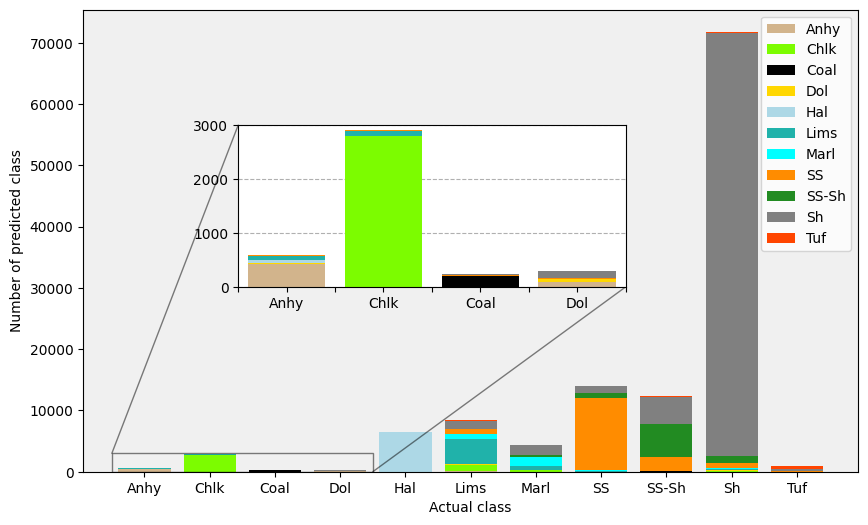

In [39]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

y_true = hidden_scaled.LITHO.values
y_pred = hidden_prob_xgb1

import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import numpy as np

# Compute confusion matrix
cm = confusion_matrix(y_true, y_pred)
class_names = np.array(['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS',
       'SS-Sh', 'Sh', 'Tuf'], dtype=object)
colors = ['tan', 'lawngreen', '#000000', 'gold', 'lightblue', 'lightseagreen', 'cyan', 'darkorange', '#228B22' , 'grey', '#FF4500']

support = np.sum(cm, axis=1)

# Plot stacked bar chart
fig, ax = plt.subplots(figsize=(10, 6))
for i in range(len(class_names)):
    ax.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
plt.xticks(range(len(support)), [class_names[i] for i in range(len(support))])
ax.set_xlabel('Actual class')
ax.set_ylabel('Number of predicted class')

# Display
ax.set_facecolor('#f0f0f0')

ax_zoom = ax.inset_axes([0.2, 0.4, 0.5, 0.35])

for i in range(len(class_names)):
    ax_zoom.bar(range(len(support)), cm[:, i], bottom=np.sum(cm[:, :i], axis=1),color=colors[i],
            label=class_names[i], linewidth=0)
ax_zoom.set_xticklabels(class_names)
labels = [item.get_text() for item in ax_zoom.get_xticklabels()]
labels[0] = ''; labels[1] = 'Anhy'; labels[2] = ''; labels[3] = 'Chlk'; labels[4] = ''; labels[5] = 'Coal'
labels[6] = ''; labels[7] = 'Dol'
ax_zoom.set_xticklabels(labels)

ax_zoom.set_xlim(-0.5, 3.5)
ax_zoom.set_ylim(0, 3000)
ax.indicate_inset_zoom(ax_zoom, edgecolor="black")


ax_zoom.set_axisbelow(True)
ax_zoom.grid(axis='y', linestyle='dashed')
ax.legend(fontsize="10", loc ="upper right")

plt.savefig('grownet.pdf')
plt.show()


-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.41607535315408056
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.74      0.72      0.73       597
        Chlk       0.68      0.96      0.79      2905
        Coal       0.70      0.84      0.76       244
         Dol       0.14      0.17      0.15       287
         Hal       0.99      0.99      0.99      6498
        Lims       0.78      0.49      0.60      8374
        Marl       0.49      0.31      0.38      4396
          SS       0.75      0.84      0.79     14045
       SS-Sh       0.69      0.44      0.54     12283
          Sh       0.88      0.96      0.92     71827
         Tuf       0.62      0.57      0.59       941

    ac

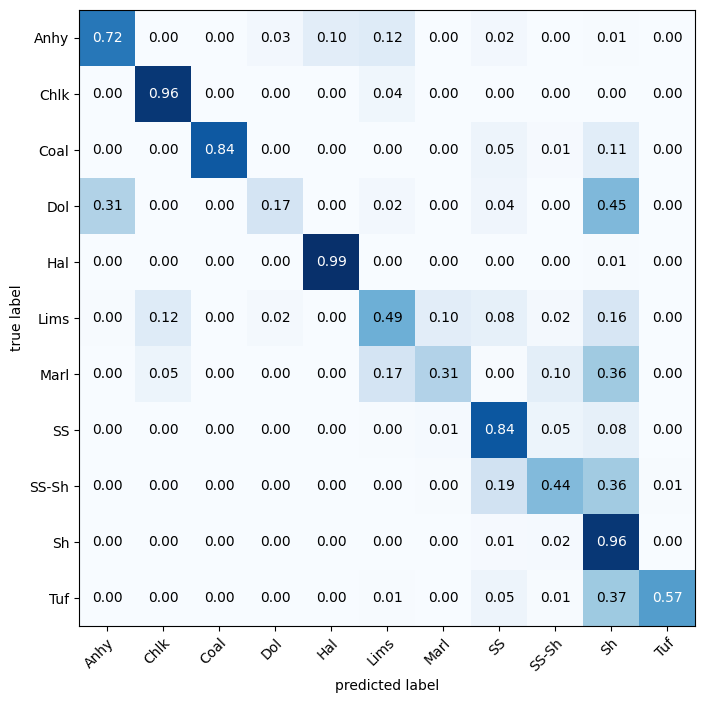

In [41]:
""""Plotting the classification report for the hidden test set
and the matrix penalty score.
"""

print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_prob_xgb1))
print(clf_rep(hidden_scaled.LITHO.values, hidden_prob_xgb1, le))
cm_plot(hidden_scaled.LITHO.values, hidden_prob_xgb1, le)

In [27]:
hidden_grow_res = hidden_form.copy()
hidden_grow_res['grow_TM'] = hidden_prob_xgb1

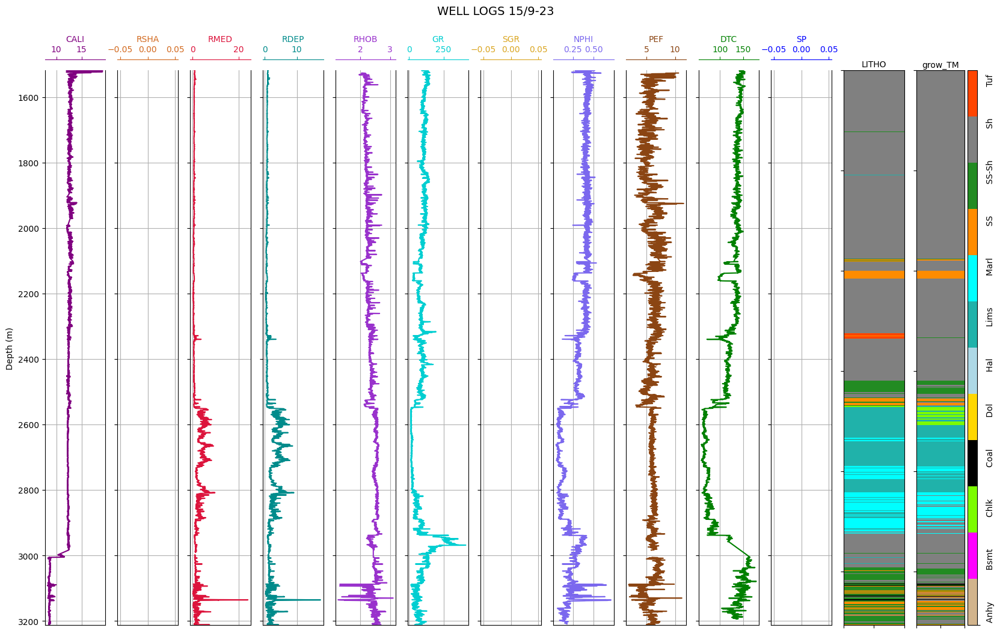

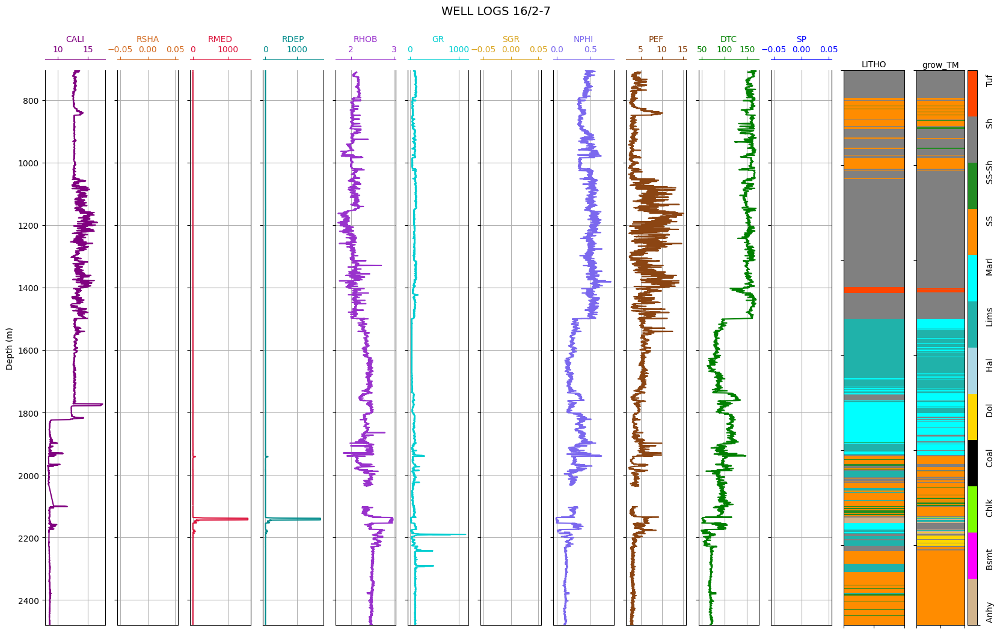

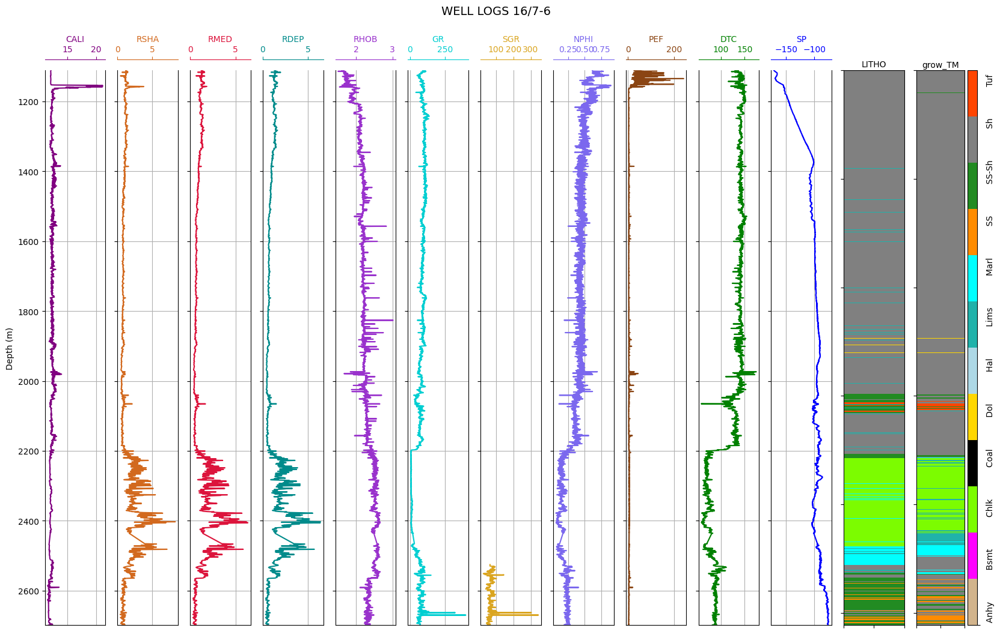

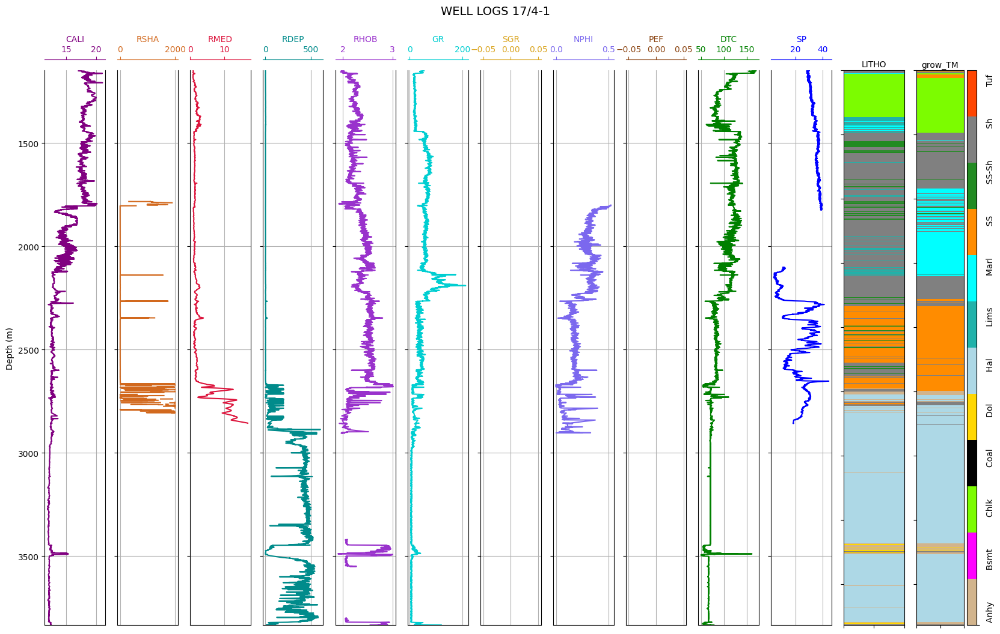

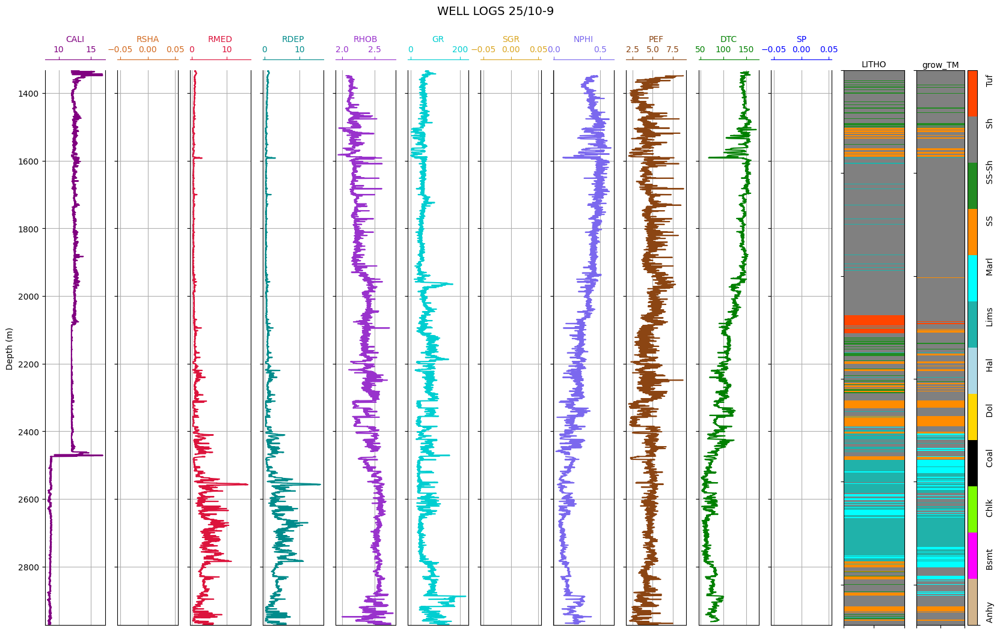

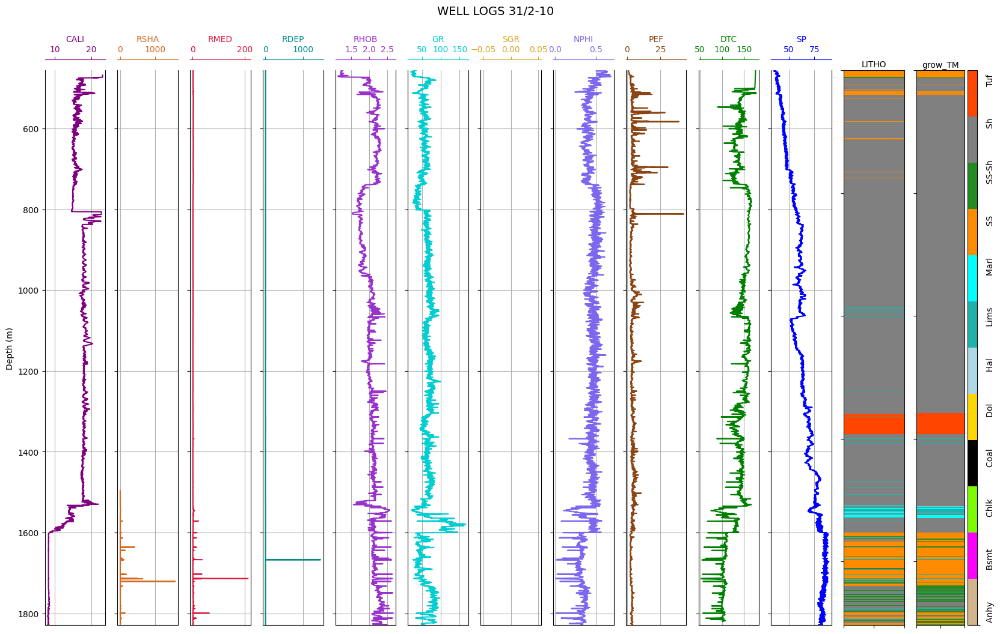

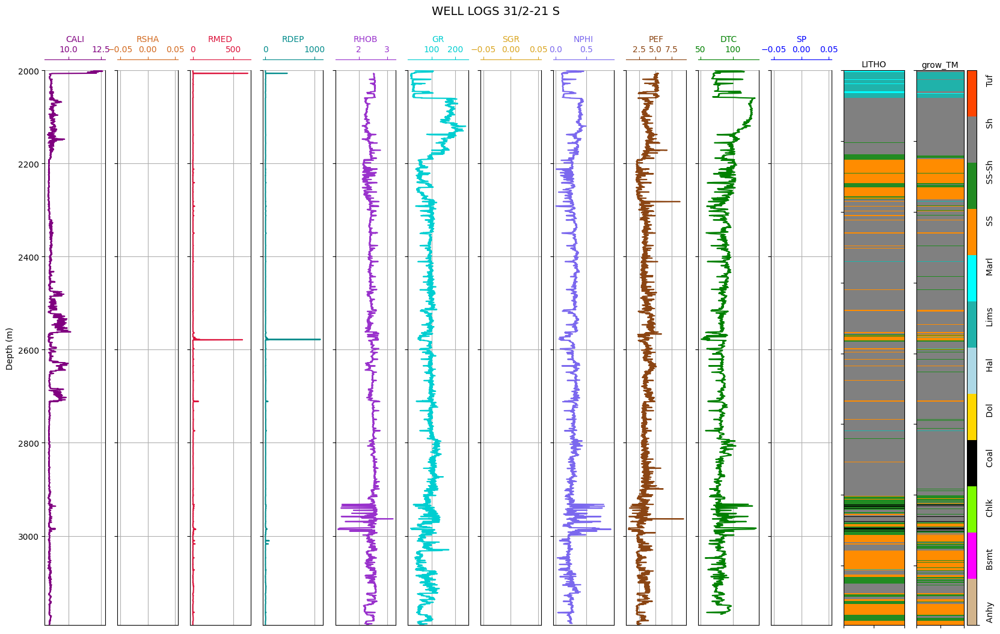

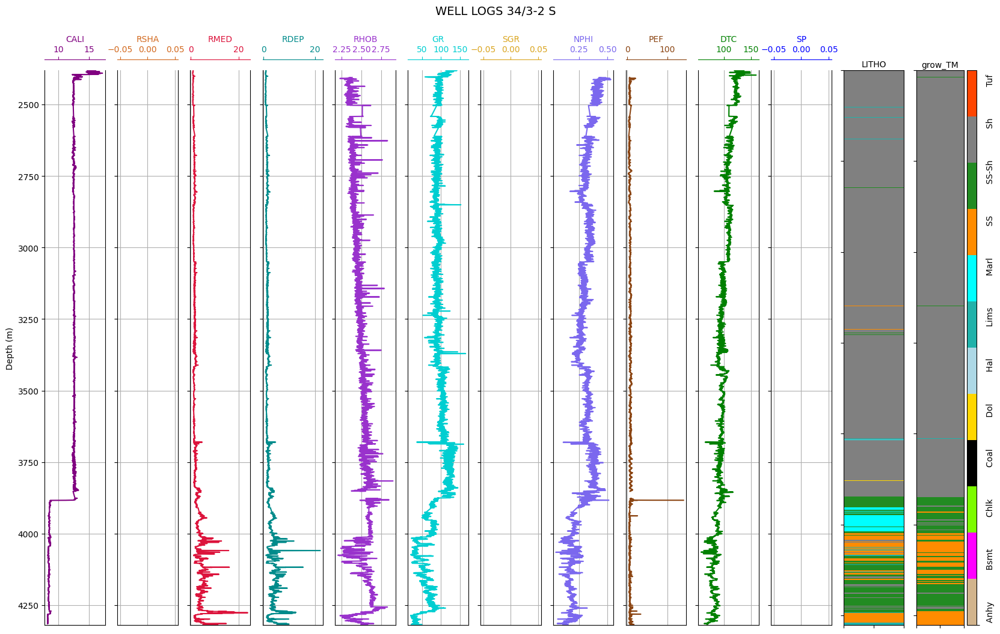

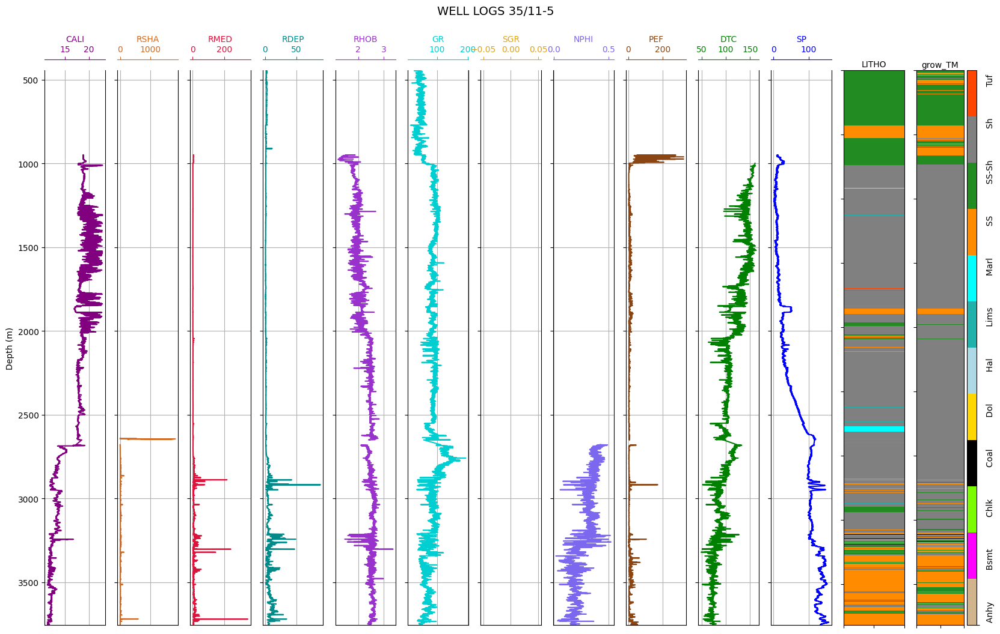

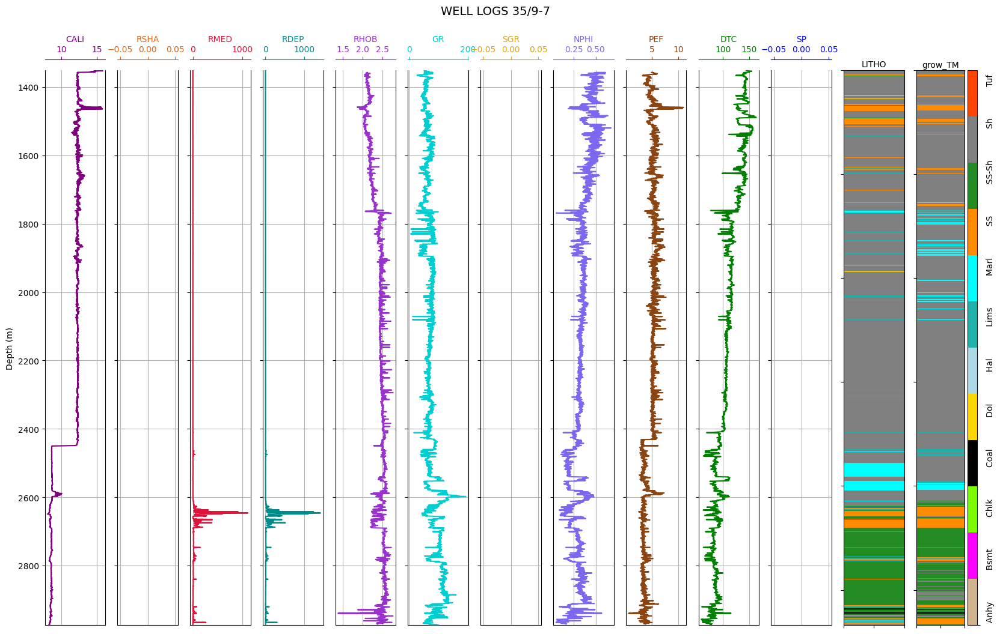

In [28]:
for i in range(0, 10):
  litho_prediction(hidden_grow_res, i, 1, le)

### GrowNet + Attention block
https://github.com/GAA-UAM/GBNN

In [51]:
def attn_block(inp,
               dense_units=4,
               num_heads=4,
               key_dim=4):
    dense = L.Dense(dense_units, activation='relu')(inp)
    dense2 = L.Dense(dense_units, activation='relu')(dense)
    attn_out = L.Attention(use_scale=True)([dense2, dense2])
    layer_norm = L.LayerNormalization()(attn_out)
    return layer_norm

In [61]:
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
import tensorflow.keras.models as M
from grow_net_v2 import GradientBoost
from sklearn.metrics import accuracy_score, f1_score
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.utils import to_categorical


selected_feature = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

x_train = train_scaled[selected_feature]
y_train = train_scaled['LITHO']

x_test = test_scaled[selected_feature]
y_test = test_scaled['LITHO']

x_hidden = hidden_scaled[selected_feature]
y_hidden = hidden_scaled['LITHO']

split = 2
kf = StratifiedKFold(n_splits=split, shuffle=True)
train_prob_xgb1 = np.zeros((len(x_train), 12))
open_prob_xgb1 = np.zeros((len(x_test), 12))
hidden_prob_xgb1 = np.zeros((len(x_hidden), 12))


numElements = len(selected_feature)
inp = L.Input(numElements)
d1 = L.Dense(numElements*4, activation='selu')(inp)
d2 = L.Dense(numElements*8, activation='selu')(d1)
d3 = L.Dense(numElements*16, activation='selu')(d2)
x = L.Reshape((numElements, 16))(d3)
for i in [16, 8, 4]:
    x1a = L.Conv1D(i, 3, padding='same', activation='selu')(x)
    x1b = L.Conv1D(i, 3, padding='same', activation='selu')(x1a)
    x2a = L.Conv1D(i, 5, padding='same', activation='selu')(x)
    x2b = L.Conv1D(i, 3, padding='same', activation='selu')(x2a)
    x3 = L.Conv1D(i, 2, padding='same', activation='selu')(x)
    add = L.Add()([x1b, x2b, x3])
    x = L.AveragePooling1D(2)(add)
    x = L.Conv1D(i, 3, padding='same', activation='selu')(x)
flatten = L.Flatten()(x)
d3 = L.Dense(16, activation='selu')(flatten)
d4 = L.Dense(16, activation='selu')(d3)
out = L.Dense(12, activation='softmax')(d4)
model = keras.models.Model(inputs = inp, outputs = out)


model.compile(tf.keras.optimizers.Adam(), 'categorical_crossentropy')
model = GradientBoost(model, batch_size=400, n_boosting_rounds=2, boost_rate = 1, epochs_per_stage=2)

i = 1
for (train_index, test_index) in kf.split(x_train, y_train):
  X_train, X_test = x_train.iloc[train_index], x_train.iloc[test_index]
  Y_train, Y_test = y_train.iloc[train_index], y_train.iloc[test_index]
  Y_train_ohe= to_categorical(Y_train)
  Y_test_ohe = to_categorical(Y_test)
    
  model.fit(X_train, Y_train_ohe,batch_size=200, validation_data = (X_test, Y_test_ohe))
  prediction = np.argmax(model.predict(X_test), axis=1)
  #print(f'Default score:', matrix_score(Y_test, prediction))
  print('Fold accuracy:', accuracy_score(Y_test, prediction))
  #print(f'F1 is:', f1_score(prediction, np.argmax(Y_test, average="weighted"))
  print(f'-----------------------FOLD {i}---------------------')
  
  # stacking probabilities
  train_prob_xgb1 += model.predict(x_train)
  open_prob_xgb1 += model.predict(x_test)
  hidden_prob_xgb1 += model.predict(x_hidden)
  i += 1
# final lithology class prediction
train_prob_xgb1 = pd.DataFrame(train_prob_xgb1/split)
train_pred_xgb1 = np.array(pd.DataFrame(train_prob_xgb1).idxmax(axis=1))
open_prob_xgb1 = pd.DataFrame(open_prob_xgb1/split)
open_pred_xgb1 = np.array(pd.DataFrame(open_prob_xgb1).idxmax(axis=1))
hidden_prob_xgb1 = pd.DataFrame(hidden_prob_xgb1/split)
hidden_pred_xgb1 = np.array(pd.DataFrame(hidden_prob_xgb1).idxmax(axis=1))

Epoch 1/2
2927/2927 [==============================] - 171s 57ms/step - loss: 0.4878 - val_loss: 0.3920
Epoch 2/2
2927/2927 [==============================] - 146s 50ms/step - loss: 0.3750 - val_loss: 0.3620
Epoch 1/2
2927/2927 [==============================] - 180s 60ms/step - loss: 0.4539 - val_loss: 0.3732
Epoch 2/2
18290/18290 [==============================] - 78s 4ms/step
Fold accuracy: 0.8556494935549571
-----------------------FOLD 1---------------------
3825/3825 [==============================] - 16s 4ms/step
Epoch 1/2
2927/2927 [==============================] - 93s 31ms/step - loss: 0.4920 - val_loss: 0.4060
Epoch 2/2
2927/2927 [==============================] - 92s 31ms/step - loss: 0.3807 - val_loss: 0.3544
Epoch 1/2
2927/2927 [==============================] - 102s 34ms/step - loss: 0.4513 - val_loss: 0.3620
Epoch 2/2
18290/18290 [==============================] - 67s 4ms/step
Fold accuracy: 0.8545505805161853
-----------------------FOLD 2---------------------
3825/3825 

In [64]:
""""Plotting the classification report for the hidden test set
and the matrix penalty score.
"""
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', matrix_score(hidden_scaled.LITHO.values, hidden_pred_xgb1))
print('Accuracy score:', accuracy_score(hidden_scaled.LITHO.values, hidden_pred_xgb1))
print(clf_rep(hidden_scaled.LITHO.values, hidden_pred_xgb1, le))

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.5172103891435248
Accuracy score: 0.7970048285497193
Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: ['Dol']
              precision    recall  f1-score   support

        Anhy       0.92      0.06      0.11       597
        Chlk       0.68      0.46      0.55      2905
        Coal       0.88      0.55      0.68       244
         Dol       0.00      0.00      0.00       287
         Hal       0.99      0.96      0.97      6498
        Lims       0.62      0.55      0.58      8374
        Marl       0.42      0.39      0.40      4396
          SS       0.80      0.67      0.73     14045
       SS-Sh       0.53      0.53      0.53     12283
          Sh       0.86      0.93      0.90     71827
         Tuf       0.69      

G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
G:\Pc\litho-venv\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


### XBNet

In [24]:
import warnings
warnings.filterwarnings('ignore')

In [25]:
from XBNet.training_utils import training,predict
from XBNet.models import XBNETClassifier
from XBNet.run import run_XBNET

In [26]:
import torch

In [28]:
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [29]:
len(selectedfeature)

38

In [37]:
model = XBNETClassifier(X_train,y_train,num_layers=2)

Enter dimensions of linear layers: 
Enter input dimensions of layer 1: 20
Enter output dimensions of layer 1: 12
Set bias as True or False: False
Enter input dimensions of layer 2: 12
Enter output dimensions of layer 2: 12
Set bias as True or False: False
Enter your last layer 
1. Sigmoid 
2. Softmax 
3. None 
3


In [38]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

Percentage training completed:   0%|                                                             | 0/5 [00:00<?, ?it/s]

[14:32:28] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "scale_pos_weight" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


Training Loss after epoch 1 is 1.030445843989931 and Accuracy is 74.74359489146194


Percentage training completed:  20%|██████████▍                                         | 1/5 [05:59<23:58, 359.74s/it]

Validation Loss after epoch 1 is 3.151947021484375 and Accuracy is 51.03884900501513
Training Loss after epoch 2 is 1.0079790214895346 and Accuracy is 75.731368607386


Percentage training completed:  40%|████████████████████▊                               | 2/5 [12:26<18:46, 375.44s/it]

Validation Loss after epoch 2 is 2.308589220046997 and Accuracy is 52.80949804804585
Training Loss after epoch 3 is 0.9901616019999245 and Accuracy is 76.22944167120173


Percentage training completed:  60%|███████████████████████████████▏                    | 3/5 [18:44<12:33, 376.76s/it]

Validation Loss after epoch 3 is 2.4022302627563477 and Accuracy is 46.57421081104791
Training Loss after epoch 4 is 0.9801065955067001 and Accuracy is 76.37168723745441


Percentage training completed:  80%|█████████████████████████████████████████▌          | 4/5 [25:10<06:20, 380.35s/it]

Validation Loss after epoch 4 is 2.2812747955322266 and Accuracy is 49.48752065269838
Training Loss after epoch 5 is 0.9733301657220251 and Accuracy is 76.21602872591544


Percentage training completed: 100%|████████████████████████████████████████████████████| 5/5 [31:36<00:00, 379.30s/it]

Validation Loss after epoch 5 is 1.913508653640747 and Accuracy is 49.08543271972278


              precision    recall  f1-score   support

           0       0.64      0.39      0.48      1085
           1       0.00      0.00      0.00       103
           2       0.60      0.55      0.58     10513
           3       0.55      0.37      0.44      3820
           4       0.05      0.01      0.02      1688
           5       0.96      0.94      0.95      8213
           6       0.56      0.46      0.51     56320
           7       0.42      0.28      0.34     33329
           8       0.63      0.65      0.64    168937
           9       0.58      0.45      0.51    150455
          10       0.84      0.92      0.88    720803
          11       0.37      0.20      0.26     15245

    accuracy                           0.76   1170511
   macro avg       0.52      0.44      0.47   1170511
weighted avg       0.74      0.76      0.75   1170511

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       125
           2       0.00 

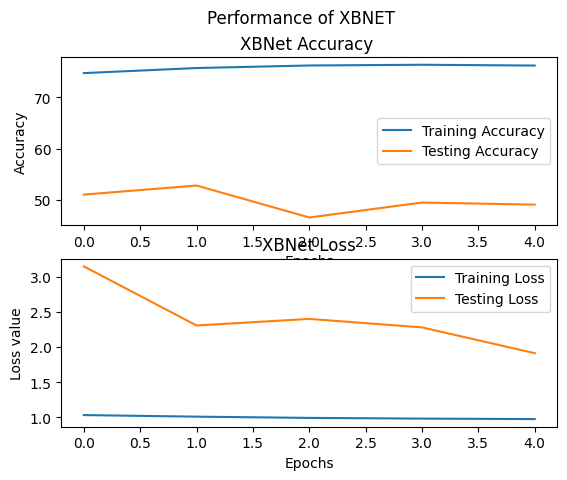

In [39]:
m,acc, lo, val_ac, val_lo = run_XBNET(X_train,X_test,y_train,y_test,model,criterion,optimizer,epochs=5,batch_size=150)

In [33]:
predict(model, X_hidden)

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [34]:
y_pred_hidden = predict(model, X_hidden)

## Tree-Structured Neural Networks

Deep Neural Decision Trees by Yongxin Yang et al. \
1- Deep Neural Decision Trees by Yongxin Yang et al. \
2- SDTR: Soft Decision Tree Regressor for Tabular Data” by Haoran Luo et al. \
3- Neural Oblivious Decision Ensembles for Deep Learning on Tabular Data by Sergei 
Popov et al. \
4- Deep Neural Network Initialization with Decision Trees” by Kelli Humbird et al. \
5- DNF-Net: A Neural Architecture for Tabular Data” by Ami Abutbul


###  1-Deep Neural Decision Trees

In [24]:
#selectedfeature = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 
#                        'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD#
#                        'DTC', 'Cluster']
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [25]:
from sklearn.datasets import load_iris
import torch
# used for implementation later
from functools import reduce

In [26]:
from functools import reduce
#data = load_iris()
#X = np.array(data.data)
#X = torch.from_numpy(X.astype(np.float32))
#y = torch.from_numpy(np.array(data.target))
X = torch.from_numpy(X_train.astype(np.float32))
y = torch.from_numpy(y_train)

In [27]:
def torch_kron_prod(a, b):
    res = torch.einsum('ij,ik->ijk', [a, b])
    res = torch.reshape(res, [-1, np.prod(res.shape[1:])])
    return res

In [28]:
def torch_bin(x, cut_points, temperature=0.1):
    # x is a N-by-1 matrix (column vector)
    # cut_points is a D-dim vector (D is the number of cut-points)
    #  this function produces a N-by-(D+1) matrix, each row has only one element being one and the rest are all zeros
    D = cut_points.shape[0]
    W = torch.reshape(torch.linspace(1.0, D + 1.0, D + 1), [1, -1])
    cut_points, _ = torch.sort(cut_points)  # make sure cut_points is monotonically increasing
    b = torch.cumsum(torch.cat([torch.zeros([1]), -cut_points], 0),0)
    h = torch.matmul(x, W) + b
    res = torch.exp(h-torch.max(h))
    res = res/torch.sum(res, dim=-1, keepdim=True)
    return h

In [29]:
def nn_decision_tree(x, cut_points_list, leaf_score, temperature=0.1):
    # cut_points_list contains the cut_points for each dimension of feature
    leaf = reduce(torch_kron_prod,
                  map(lambda z: torch_bin(x[:, z[0]:z[0] + 1], z[1], temperature),
                      enumerate(cut_points_list)))
    return torch.matmul(leaf, leaf_score)

In [30]:
num_cut = [2]*4  # 4 features with 2 cut points each
num_leaf = np.prod(np.array(num_cut) + 1) # number of leaf node
num_class = 12
# randomly initialize cutpoints
cut_points_list = [torch.rand([i], requires_grad=True) for i in num_cut]
leaf_score = torch.rand([num_leaf, num_class], requires_grad=True)
loss_function = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(cut_points_list + [leaf_score], lr=0.001)

In [32]:
X_test = torch.from_numpy(X_test.astype(np.float32))
y_test = torch.from_numpy(y_test)

In [ ]:
from sklearn.metrics import accuracy_score
import torch
import torch.nn as nn
for i in range(2000):
    optimizer.zero_grad()
    y_pred = nn_decision_tree(X_test, cut_points_list, leaf_score, temperature=0.05)
    loss = nn.CrossEntropyLoss()
    loss = loss(y_pred, y_test.type(torch.LongTensor))
    loss.backward()
    optimizer.step()
    if (i+1) % 100 == 0:
        print(f"EPOCH {i} RESULTS")
        print(accuracy_score(np.array(y_test), np.argmax(y_pred.detach().numpy(), axis=1)))

EPOCH 99 RESULTS
0.29047563347126165


### 2- SDTR: Soft Decision Tree Regressor 

In [109]:
import numpy as np
import tensorflow.keras.layers as L
import keras
import keras as K
#import tensorflow.keras as K

In [110]:
#selectedfeature = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 
#                        'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD#
#                        'DTC', 'Cluster']
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [111]:
MAX_DEPTH = 5
inp = L.Input((len(selectedfeature),))
outputs = []
for node in range(sum([2**i for i in range(MAX_DEPTH + 1)])):
    outputs.append(L.Dense(20, activation='relu')(inp))
outputs.append(L.Dense(12, activation='softmax')(inp))
model = keras.models.Model(inputs=inp, outputs=outputs)

In [112]:
model.summary()

Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_19 (InputLayer)          [(None, 38)]         0           []                               
                                                                                                  
 dense_769 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_770 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_771 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                            

 dense_808 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_809 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_810 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_811 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_812 (Dense)              (None, 20)           780         ['input_19[0][0]']               
                                                                                                  
 dense_813

In [113]:
index = 0
class Node():
    def __init__(self):
        global index
        self.index = index
        self.left = None
        self.right = None
        index += 1
def add_nodes(depths_left):
    curr = Node()
    if depths_left != 0:
        curr.left = add_nodes(depths_left - 1)
        curr.right = add_nodes(depths_left - 1)
    return curr
root = add_nodes(MAX_DEPTH)

In [114]:
def get_outs(root, y_pred):
    if not root.left and not root.right: # is a leaf
        return [y_pred[root.index]]
    lefts = get_outs(root.left, y_pred)
    lefts = [y_pred[root.index] * prob for prob in lefts]
    rights = get_outs(root.right, y_pred)
    rights = [(1-y_pred[root.index]) * prob for prob in rights]
    return lefts + rights

In [115]:
from tensorflow.keras.losses import binary_crossentropy as bce
import tensorflow as tf
NUM_OUT = tf.constant(2**MAX_DEPTH, dtype=tf.float32)
def custom_loss(y_true, y_pred):
    outputs = get_outs(root, y_pred)
    return tf.math.divide(tf.add_n([bce(y_true, out) for out in outputs]), NUM_OUT)

In [116]:
import tensorflow as tf
avg_loss = tf.keras.metrics.Mean('loss', dtype=tf.float32)
class custom_fit(tf.keras.Model):
    def train_step(self, data):
        images, labels = data
        with tf.GradientTape() as tape:
            outputs = self(images, training=True) # forward pass
            total_loss = custom_loss(labels, outputs)
        gradients = tape.gradient(total_loss, self.trainable_variables)
        self.optimizer.apply_gradients(zip(gradients, self.trainable_variables))
        avg_loss.update_state(total_loss)
        return {"loss": avg_loss.result()}

In [61]:
model = custom_fit(inputs=inp, outputs=outputs)

In [63]:
model.compile(optimizer='adam', loss='categorical_crossentropy',  metrics=['accuracy'])

In [ ]:
history = model.fit(X_train, y_train)

In [117]:
NUM_LITERALS = 64
NUM_DISJ_ARGS = 32
AVG_NUM_CONJ_LITS = 16
NUM_DNNF_BLOCKS = 8

In [118]:
NUM_DISJ_ARGS_const = tf.constant(NUM_DISJ_ARGS, dtype=tf.float32)
def neural_or(x):
    return tf.keras.activations.tanh(K.sum(x, axis=1) + NUM_DISJ_ARGS_const - 1.5)
neural_or = L.Lambda(neural_or)

In [119]:
def neural_and(inputs):
    x, u = inputs
    u = tf.reshape(u, (NUM_LITERALS,1))
    return K.tanh(K.dot(x, u) - K.sum(u) + 1.5)
neural_and = L.Lambda(neural_and)

In [120]:
def DNNF(inp_layer):
    stimulus = tf.random.uniform((NUM_DISJ_ARGS, NUM_LITERALS))
    ratio = tf.constant(AVG_NUM_CONJ_LITS / NUM_LITERALS)
    masks = tf.cast(tf.math.less(stimulus, ratio), np.float32)
    literals = L.Dense(NUM_LITERALS, activation='tanh')(inp_layer)
    disj_args = []
    for i in range(NUM_DISJ_ARGS):
        disj_args.append(neural_and([literals, masks[i]]))
    disj_inp = L.Concatenate()(disj_args)
    disj = neural_or(disj_inp)
    return L.Reshape((1,))(disj)

In [121]:
def DNF_Net(input_dim, output_dim):
    inp = L.Input((input_dim,))
    dnnf_block_outs = []
    for i in range(NUM_DNNF_BLOCKS):
        dnnf_block_outs.append(DNNF(inp))
    concat = L.Concatenate()(dnnf_block_outs)
    out = L.Dense(output_dim, activation='softmax')(concat)
    return keras.models.Model(inputs=inp, outputs=out)

## Attention to Tabular Data

### 1-Attention to Tabular Data

In [36]:
import numpy as np
import tensorflow.keras.layers as L
import keras
import keras as K

In [37]:
#selectedfeature = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 
#                        'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD#
#                        'DTC', 'Cluster']
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [38]:
def attn_block(inp,
               dense_units=4,
               num_heads=4,
               key_dim=4):
    dense = L.Dense(dense_units, activation='relu')(inp)
    dense2 = L.Dense(dense_units, activation='relu')(dense)
    attn_out = L.Attention(use_scale=True)([dense2, dense2])
    layer_norm = L.LayerNormalization()(attn_out)
    return layer_norm

In [39]:
inp = L.Input((len(selectedfeature),))
reshape = L.Reshape((len(selectedfeature),1))(inp)
attn1 = attn_block(reshape)
attn2 = attn_block(attn1)
flatten = L.Flatten()(attn2)
predense = L.Dense(32, activation='relu')(flatten)
out = L.Dense(12, activation='softmax')(predense)
model = keras.models.Model(inputs=inp, outputs=out)

In [40]:
model.compile(optimizer='adam', loss='categorical_crossentropy',  metrics=['accuracy']) 

In [41]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)
y_hidden = to_categorical(y_hidden)

In [ ]:
history = model.fit(X_train, 
            y_train,
            batch_size = 256,
            validation_data = (X_test, y_test),
            verbose=1,
            epochs=5
            ) 

Epoch 1/5
4573/4573 [==============================] - 76s 16ms/step - loss: 1.1818 - accuracy: 0.6311 - val_loss: 1.1307 - val_accuracy: 0.6565
Epoch 2/5
1517/4573 [========>.....................] - ETA: 48s - loss: 1.1216 - accuracy: 0.6405

In [ ]:
y_hidden_pred = model.predict(X_hidden)

In [ ]:
print(clf_rep(np.argmax(y_hidden, axis=1), np.argmax(y_hidden_pred, axis=1), le))

### 2-TabNet

In [23]:
from tabnet import TabNetClassifier
from tabnet import StackedTabNetClassifier

In [24]:
#selectedfeature = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 
#                        'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD#
#                        'DTC', 'Cluster']
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [105]:
model = TabNetClassifier(feature_columns=None,
                         num_features=X_train.shape[-1],
                         num_classes=12,
                         feature_dim=32, # 50
                         output_dim=15,
                         num_decision_steps=6, #4 5
                         relaxation_factor=0.9, #0.7
                         #sparsity_coefficient=1e-6
                        )

[TabNet]: 17 features will be used for decision steps.


In [106]:
model = StackedTabNetClassifier(feature_columns=None,
                         num_features=X_train.shape[-1],
                         num_classes=12,
                         num_layers=1,
                         feature_dim=32, # 50
                         output_dim=12,
                         num_decision_steps=4, #4 5
                         relaxation_factor=0.8, #0.7
                         norm_type='group',
                         num_groups=2,
                         epsilon=1e-5
                        )

[TabNet]: 20 features will be used for decision steps.


In [107]:
model.compile(optimizer='adam', loss='categorical_crossentropy',
              metrics=['accuracy'])

In [108]:
from tensorflow.keras.utils import to_categorical
y_train_ohe = to_categorical(y_train)
y_test_ohe = to_categorical(y_test)
y_hidden_ohe = to_categorical(y_hidden)

In [109]:
model.fit(X_train, y_train_ohe, epochs=5,
          validation_data=(X_test, y_test_ohe),
          batch_size=200)

Epoch 1/5
5853/5853 [==============================] - 105s 17ms/step - loss: 0.7832 - accuracy: 0.7337 - val_loss: 0.8119 - val_accuracy: 0.7461
Epoch 2/5
5853/5853 [==============================] - 95s 16ms/step - loss: 0.5585 - accuracy: 0.8117 - val_loss: 0.8586 - val_accuracy: 0.7282
Epoch 3/5
5853/5853 [==============================] - 95s 16ms/step - loss: 0.5192 - accuracy: 0.8256 - val_loss: 0.8655 - val_accuracy: 0.7278
Epoch 4/5
5853/5853 [==============================] - 95s 16ms/step - loss: 0.4769 - accuracy: 0.8381 - val_loss: 0.9625 - val_accuracy: 0.7245
Epoch 5/5
5853/5853 [==============================] - 95s 16ms/step - loss: 0.4545 - accuracy: 0.8452 - val_loss: 0.9333 - val_accuracy: 0.7255


In [110]:
y_hidden_pred = model.predict(X_hidden)

3825/3825 [==============================] - 13s 3ms/step


In [111]:
print(clf_rep(np.argmax(y_hidden_ohe, axis=1), np.argmax(y_hidden_pred, axis=1), le))

Real Facies (l1): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Pred Facies (l2): ['Anhy', 'Chlk', 'Coal', 'Dol', 'Hal', 'Lims', 'Marl', 'SS', 'SS-Sh', 'Sh', 'Tuf']
Not exist in l1 or l2: []
              precision    recall  f1-score   support

        Anhy       0.62      0.17      0.26       597
        Chlk       0.68      0.57      0.62      2905
        Coal       0.38      0.64      0.48       244
         Dol       0.00      0.00      0.00       287
         Hal       0.99      0.95      0.97      6498
        Lims       0.62      0.57      0.59      8374
        Marl       0.41      0.36      0.38      4396
          SS       0.76      0.60      0.67     14045
       SS-Sh       0.49      0.37      0.42     12283
          Sh       0.84      0.95      0.89     71827
         Tuf       0.42      0.18      0.26       941

    accuracy                           0.78    122397
   macro avg       0.56      0.49      0.50    122397
weighted avg  

### 3-TabNet use pytorch

https://www.kaggle.com/code/optimo/tabnetmultitaskclassifier/notebook#About-this-notebook \
https://github.com/dreamquark-ai/tabnet/blob/develop/forest_example.ipynb \
https://github.com/dreamquark-ai/tabnet \
https://towardsdatascience.com/tabnet-deep-neural-network-for-structured-tabular-data-39eb4b27a9e4

In [23]:
import pytorch_tabnet
from pytorch_tabnet.tab_model import TabNetClassifier
import torch
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import roc_auc_score, accuracy_score
import numpy as np
np.random.seed(0)

In [33]:
#selectedfeature = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 
#                        'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD#
#                        'DTC', 'Cluster']
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

In [52]:
# define the model
clf1_nopreproc = TabNetClassifier(optimizer_fn=torch.optim.SGD,
                       optimizer_params=dict(lr=2e-1),
                       scheduler_params={"step_size":10, # how to use learning rate scheduler
                                         "gamma":0.5},
                       scheduler_fn=torch.optim.lr_scheduler.StepLR,
                       mask_type='sparsemax', # "sparsemax", 'entmax'
                       verbose=1,
                       n_d=32,
                       n_a=12

                      )


G:\Pc\litho-venv\lib\site-packages\pytorch_tabnet\abstract_model.py:75: UserWarning: Device used : cpu
  warnings.warn(f"Device used : {self.device}")


In [53]:
#clf1_nopreproc = TabNetClassifier(
#    n_d=64, n_a=64, n_steps=5,
#    gamma=1.5, n_independent=2, n_shared=2,
#    lambda_sparse=1e-4, momentum=0.3, clip_value=2.,
#    optimizer_fn=torch.optim.Adam,
#    optimizer_params=dict(lr=2e-2),
#    scheduler_params = {"gamma": 0.95,
#                     "step_size": 20},
#    scheduler_fn=torch.optim.lr_scheduler.StepLR, epsilon=1e-15,
#    verbose=1
#)

In [54]:
from pytorch_tabnet.augmentations import ClassificationSMOTE
aug = ClassificationSMOTE(p=0.2)
#
# fit the model 
clf1_nopreproc.fit(
    X_train,y_train,
    eval_set=[(X_train, y_train), (X_test, y_test)],
    eval_name=['train', 'test'],
    eval_metric=['accuracy'],
    max_epochs=10, patience=10,
    batch_size=400, virtual_batch_size=256,
    num_workers=0,
    #weights=1,
    drop_last=False,
    augmentations=aug

)     

epoch 0  | loss: 0.87661 | train_accuracy: 0.77941 | test_accuracy: 0.74421 |  0:02:21s
epoch 1  | loss: 0.65531 | train_accuracy: 0.81596 | test_accuracy: 0.75381 |  0:04:44s
epoch 2  | loss: 0.59306 | train_accuracy: 0.83356 | test_accuracy: 0.75736 |  0:07:07s
epoch 3  | loss: 0.56029 | train_accuracy: 0.83485 | test_accuracy: 0.74445 |  0:09:28s
epoch 4  | loss: 0.54055 | train_accuracy: 0.83595 | test_accuracy: 0.7505  |  0:11:50s
epoch 5  | loss: 0.53065 | train_accuracy: 0.8366  | test_accuracy: 0.75731 |  0:14:07s
epoch 6  | loss: 0.51692 | train_accuracy: 0.84711 | test_accuracy: 0.74538 |  0:16:29s
epoch 7  | loss: 0.50688 | train_accuracy: 0.85833 | test_accuracy: 0.75098 |  0:18:52s
epoch 8  | loss: 0.49991 | train_accuracy: 0.85264 | test_accuracy: 0.7232  |  0:21:14s
epoch 9  | loss: 0.49177 | train_accuracy: 0.86014 | test_accuracy: 0.75178 |  0:23:36s
Stop training because you reached max_epochs = 10 with best_epoch = 2 and best_test_accuracy = 0.75736


G:\Pc\litho-venv\lib\site-packages\pytorch_tabnet\callbacks.py:172: UserWarning: Best weights from best epoch are automatically used!
  warnings.warn(wrn_msg)


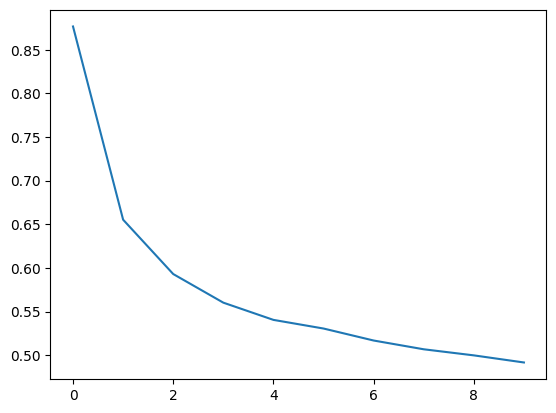

In [55]:
# plot losses
from matplotlib import pyplot as plt
plt.plot(clf1_nopreproc.history['loss'])

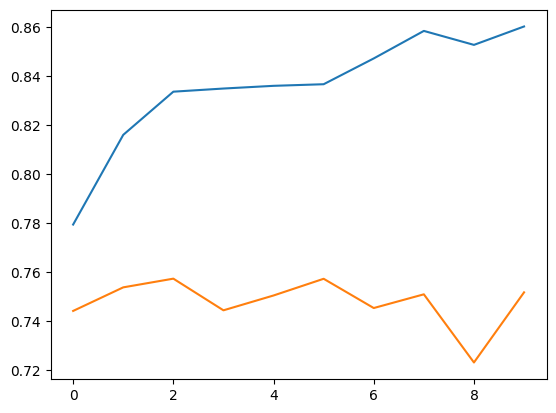

In [56]:
# plot accuracy
plt.plot(clf1_nopreproc.history['train_accuracy'])
plt.plot(clf1_nopreproc.history['test_accuracy'])

In [57]:
preds = clf1_nopreproc.predict(X_hidden)
hidden_acc = accuracy_score(preds, y_hidden)
print(f"BEST ACCURACY SCORE ON HIDDEN SET : {hidden_acc}")

BEST ACCURACY SCORE ON HIDDEN SET : 0.7372893126465518


### Keras Models Using the Genetic Algorithm

https://pygad.readthedocs.io/en/latest/README_pygad_kerasga_ReadTheDocs.html#examples \
https://www.youtube.com/watch?v=N_xvfPNjgn8 \
https://www.youtube.com/watch?v=QQKYrmF4QUY

In [23]:
import grow_net
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
import tensorflow.keras.models as M

In [24]:
#all
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
# good
#selectedfeature = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
#                      'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
#                      'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
#                      'PEF', 'RDEP', 'DTS_COMB', 'G', 'SP',
#                      'Cluster', 'K', 'P_I', 'DRHO', 'DCAL'
#                        ]
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values
print(len(selectedfeature))

38


In [25]:
from tensorflow.keras.utils import to_categorical
y_train_ohe= to_categorical(y_train)
y_test_ohe = to_categorical(y_test)
y_hidden_ohe = to_categorical(y_hidden)

In [26]:
import tensorflow.keras
import pygad.kerasga
import numpy
import pygad

In [40]:
def fitness_func(solution, sol_idx):
    global data_inputs, data_outputs, keras_ga, model

    predictions = pygad.kerasga.predict(model=model,
                                        solution=solution,
                                        data=data_inputs)

    cce = tensorflow.keras.losses.CategoricalCrossentropy()
    solution_fitness = 1.0 / (cce(data_outputs, predictions).numpy() + 0.00000001)

    return solution_fitness

In [41]:
def callback_generation(ga_instance):
    print("Generation = {generation}".format(generation=ga_instance.generations_completed))
    print("Fitness    = {fitness}".format(fitness=ga_instance.best_solution()[1]))

In [43]:
input_layer = L.Input(X_train.shape[1])
dense_layer = L.BatchNormalization()(input_layer)
dense_layer = L.Dense(64, activation="relu")(dense_layer)
dense_layer = L.Dense(128, activation="relu")(dense_layer)
dense_layer = L.BatchNormalization()(dense_layer)
#x = L.Dropout(0.25)(x)
dense_layer = L.Dense(32, activation="relu")(dense_layer)
dense_layer = L.BatchNormalization()(dense_layer)
out = L.Dense(12, activation='softmax')(dense_layer)
model = M.Model(input_layer, out)

In [29]:
# Build the keras model using the functional API.
input_layer  = tensorflow.keras.layers.Input(X_train.shape[1])
dense_layer = tensorflow.keras.layers.Dense(64, activation="relu")(input_layer)
dense_layer = tensorflow.keras.layers.Dense(32, activation="relu")(dense_layer)
output_layer = tensorflow.keras.layers.Dense(12, activation="softmax")(dense_layer)

model = tensorflow.keras.Model(inputs=input_layer, outputs=output_layer)

In [44]:
# Create an instance of the pygad.kerasga.KerasGA class to build the initial population.
keras_ga = pygad.kerasga.KerasGA(model=model,
                                   num_solutions=10)

In [45]:
data_inputs  = X_train
data_outputs = y_train_ohe

In [46]:
# Prepare the PyGAD parameters. Check the documentation for more information: https://pygad.readthedocs.io/en/latest/README_pygad_ReadTheDocs.html#pygad-ga-class
num_generations = 2 # Number of generations.
num_parents_mating = 5 # Number of solutions to be selected as parents in the mating pool.
initial_population = keras_ga.population_weights # Initial population of network weights.

In [47]:
# Create an instance of the pygad.GA class
ga_instance = pygad.GA(num_generations=num_generations,
                       num_parents_mating=num_parents_mating,
                       initial_population=initial_population,
                       fitness_func=fitness_func,
                       on_generation=callback_generation)


In [48]:
# Start the genetic algorithm evolution.
ga_instance.run()

36579/36579 [==============================] - 42s 1ms/step


IndexError: index 0 is out of bounds for axis 0 with size 0

In [ ]:
# After the generations complete, some plots are showed that summarize how the outputs/fitness values evolve over generations.
ga_instance.plot_fitness(title="PyGAD & Keras - Iteration vs. Fitness", linewidth=4)

In [ ]:
# Returning the details of the best solution.
solution, solution_fitness, solution_idx = ga_instance.best_solution()
print("Fitness value of the best solution = {solution_fitness}".format(solution_fitness=solution_fitness))
print("Index of the best solution : {solution_idx}".format(solution_idx=solution_idx))

In [ ]:
# Make predictions based on the best solution.
predictions = pygad.kerasga.predict(model=model,
                                    solution=solution,
                                    data=data_inputs)
# print("Predictions : \n", predictions)

In [ ]:
# Calculate the categorical crossentropy for the trained model.
cce = tensorflow.keras.losses.CategoricalCrossentropy()
print("Categorical Crossentropy : ", cce(data_outputs, predictions).numpy())

In [ ]:
# Calculate the classification accuracy for the trained model.
ca = tensorflow.keras.metrics.CategoricalAccuracy()
ca.update_state(data_outputs, predictions)
accuracy = ca.result().numpy()
print("Accuracy : ", accuracy)

### boosting sklearn + keras model

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

#all
selectedfeature = ['Cluster', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
       'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
       'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded', 'FORMATION_encoded',
       'WELL_encoded', 'DTS_pred', 'DTS_COMB', 'NPHI_pred', 'NPHI_COMB',
       'RHOB_pred', 'RHOB_COMB', 'DTC_pred', 'DTC_COMB', 'S_I', 'P_I', 'DT_R',
       'G', 'K', 'MD_TVD']
# good
#selectedfeature = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
#                      'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
#                      'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
#                      'PEF', 'RDEP', 'DTS_COMB', 'G', 'SP',
#                      'Cluster', 'K', 'P_I', 'DRHO', 'DCAL'
#                        ]
X_train = train_scaled[selectedfeature].values
y_train = train_scaled['LITHO'].values
X_test = test_scaled[selectedfeature].values
y_test = test_scaled['LITHO'].values
X_hidden = hidden_scaled[selectedfeature].values
y_hidden = hidden_scaled['LITHO'].values

# Define the MLP model using Keras
def create_model():
    model = Sequential()
    model.add(Dense(10, input_dim=X_train.shape[1], activation='relu'))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(12, activation='softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='SGD', metrics=['accuracy'])
    return model

# Wrap the MLP model with KerasClassifier for use with scikit-learn
mlp = KerasClassifier(build_fn=create_model, epochs=20, batch_size=500, verbose=1)

# Initialize the gradient boosting classifier with MLP as the weak learner
gb_clf = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42,
                                     loss='deviance', min_samples_split=2, min_samples_leaf=1,
                                     subsample=1.0, max_features=None, warm_start=False)

# Train the gradient boosting classifier with MLP as the weak learner
gb_clf.fit(X_train, y_train)

# Predict on the test set
y_pred = gb_clf.predict(X_test)

# Calculate the accuracy score
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy: {:.2f}%".format(accuracy*100))

C:\Users\esfahani\AppData\Local\Temp\ipykernel_3128\1851475682.py:38: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  mlp = KerasClassifier(build_fn=create_model, epochs=20, batch_size=500, verbose=1)
G:\Pc\litho-venv\lib\site-packages\sklearn\ensemble\_gb.py:280: FutureWarning: The loss parameter name 'deviance' was deprecated in v1.1 and will be removed in version 1.3. Use the new parameter name 'log_loss' which is equivalent.
  warnings.warn(


In [ ]:
# Predict on the test set
y_pred_hidden = gb_clf.predict(X_hidden)
# Calculate the accuracy score
accuracy = accuracy_score(y_hidden, y_pred_hidden)
print("Accuracy: {:.2f}%".format(accuracy*100))

In [ ]:
import tensorflow as tf
import tensorflow.keras.callbacks as C
import tensorflow.keras.layers as L
import tensorflow.keras.models as M
from grow_net_v2 import GradientBoost
from sklearn.metrics import accuracy_score, f1_score
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score

selected_feature = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

x_train = train_scaled[selected_feature]
y_train = train_scaled['LITHO']

x_test = test_scaled[selected_feature]
y_test = test_scaled['LITHO']

x_hidden = hidden_scaled[selected_feature]
y_hidden = hidden_scaled['LITHO']

split = 10
kf = StratifiedKFold(n_splits=split, shuffle=True)
train_prob_xgb1 = np.zeros((len(x_train), 12))
open_prob_xgb1 = np.zeros((len(x_test), 12))
hidden_prob_xgb1 = np.zeros((len(x_hidden), 12))

# Define the MLP model using Keras
def create_model():
    model = Sequential()
    model.add(Dense(10, input_dim=X_train.shape[1], activation='relu'))
    model.add(Dense(20, activation='relu'))
    model.add(Dense(12, activation='softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='SGD', metrics=['accuracy'])
    return model

i = 1
for (train_index, test_index) in kf.split(x_train, y_train):
  X_train, X_test = x_train.iloc[train_index], x_train.iloc[test_index]
  Y_train, Y_test = y_train.iloc[train_index], y_train.iloc[test_index]
    
  # Wrap the MLP model with KerasClassifier for use with scikit-learn
  mlp = KerasClassifier(build_fn=create_model, epochs=10, batch_size=500, verbose=1)
  
  # Initialize the gradient boosting classifier with MLP as the weak learner
  model = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42,
                                          loss='log_loss', min_samples_split=2, min_samples_leaf=1,
                                          subsample=1.0, max_features=None, warm_start=False, verbose=3)
  # Train the gradient boosting classifier with MLP as the weak learner
  model.fit(X_train, Y_train)
  
  # Predict on the test set
  y_pred = model.predict(X_test)
  
  # Calculate the accuracy score
  accuracy = accuracy_score(Y_test, y_pred)
  print("Accuracy: {:.2f}%".format(accuracy*100))  
  print(f'-----------------------FOLD {i}---------------------')
  
  # stacking probabilities
  train_prob_xgb1 += model.predict_proba(x_train)
  open_prob_xgb1 += model.predict_proba(x_test)
  hidden_prob_xgb1 += model.predict_proba(x_hidden)
  i += 1
# final lithology class prediction
train_prob_xgb1 = pd.DataFrame(train_prob_xgb1/split)
train_pred_xgb1 = np.array(pd.DataFrame(train_prob_xgb1).idxmax(axis=1))
open_prob_xgb1 = pd.DataFrame(open_prob_xgb1/split)
open_pred_xgb1 = np.array(pd.DataFrame(open_prob_xgb1).idxmax(axis=1))
hidden_prob_xgb1 = pd.DataFrame(hidden_prob_xgb1/split)
hidden_pred_xgb1 = np.array(pd.DataFrame(hidden_prob_xgb1).idxmax(axis=1))

C:\Users\esfahani\AppData\Local\Temp\ipykernel_11452\4225868280.py:50: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  mlp = KerasClassifier(build_fn=create_model, epochs=10, batch_size=500, verbose=1)


      Iter       Train Loss   Remaining Time 
         1           1.0608          286.61m
         2           1.0376          283.57m
         3           0.9915          278.37m
         4   729014321.4843          270.68m
         5   729014321.4505          264.95m
         6   729014321.4227          260.30m
         7   729014321.4008          255.59m
         8   729014321.3804          251.78m
         9   729014828.3736          248.07m
        10   729014828.3549          244.06m
        11   729014828.3392          240.23m
        12   729014828.3270          236.65m
        13   729014828.3153          233.07m
        14   729014828.3043          229.62m
        15   729014828.2948          226.33m
        16   729014828.2846          222.97m
        17   729014828.2769          219.70m
        18   729014828.2682          216.45m
        19   729014828.2610          213.44m
        20   729014828.2540          210.54m
        21   729014828.2459          207.54m
        2

## genetic algorithm + keras model 

Multi-Layer Perceptron (MLP) neural network using genetic algorithms in Keras. Here's an example code using the DEAP (Distributed Evolutionary Algorithms in Python) library

In [ ]:
import numpy as np
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import to_categorical
from deap import algorithms, base, creator, tools
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split

# Load dataset
selected_feature = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

X_train = train_scaled[selected_feature]
y_train = train_scaled['LITHO']

X_test = test_scaled[selected_feature]
y_test = test_scaled['LITHO']

X_hidden = hidden_scaled[selected_feature]
y_hidden = hidden_scaled['LITHO']

# Define the MLP model architecture
def create_model(num_hidden_layers, num_neurons_per_layer, activation_func):
    model = Sequential()
    model.add(Dense(num_neurons_per_layer, input_dim=X_train.shape[1], activation=activation_func))
    for i in range(num_hidden_layers-1):
        model.add(Dense(num_neurons_per_layer, activation=activation_func))
    model.add(Dense(len(np.unique(y_train)), activation='softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

# Define the fitness function for genetic algorithm
def evaluate(individual):
    model = create_model(individual[0], individual[1], individual[2])
    model.fit(X_train, to_categorical(y_train), epochs=5, batch_size=400, verbose=0)
    accuracy = model.evaluate(X_test, to_categorical(y_test), verbose=1)[1]
    return accuracy,

# Define the genetic algorithm parameters
creator.create("FitnessMax", base.Fitness, weights=(1.0,))
creator.create("Individual", list, fitness=creator.FitnessMax)
toolbox = base.Toolbox()
toolbox.register("num_hidden_layers", np.random.randint, 1, 6)
toolbox.register("num_neurons_per_layer", np.random.randint, 5, 51)
toolbox.register("activation_func", np.random.choice, ['relu', 'sigmoid', 'tanh'])
toolbox.register("individual", tools.initCycle, creator.Individual, 
                 (toolbox.num_hidden_layers, toolbox.num_neurons_per_layer, toolbox.activation_func), n=1)
toolbox.register("population", tools.initRepeat, list, toolbox.individual)
toolbox.register("mate", tools.cxTwoPoint)
toolbox.register("mutate", tools.mutUniformInt, low=[1, 5, 0], up=[5, 50, 2], indpb=0.1)
toolbox.register("select", tools.selTournament, tournsize=3)
toolbox.register("evaluate", evaluate)

# Initialize the genetic algorithm population and run the evolution process
population = toolbox.population(n=10)
num_generations = 5
for gen in range(num_generations):
    offspring = algorithms.varAnd(population, toolbox, cxpb=0.5, mutpb=0.1)
    fits = toolbox.map(toolbox.evaluate, offspring)
    for fit, ind in zip(fits, offspring):
        ind.fitness.values = fit
    population = toolbox.select(offspring, k=len(population))

# Get the best MLP model from the final population
best_individual = tools.selBest(population, k=1)[0]
best_model = create_model(best_individual[0], best_individual[1], best_individual[2])

# Train the best MLP model on the full dataset
best_model.fit(X_train, to_categorical(y_train), epochs=5, batch_size=400, verbose=1)


In [ ]:
y_pred_test = best_model.predict(X_test)
# Calculate the accuracy score
accuracy = accuracy_score(y_test, np.argmax(y_pred_test, axis=1))
print("Accuracy: {:.2f}%".format(accuracy*100)) 

y_pred_hidden = best_model.predict(X_hidden)
# Calculate the accuracy score
accuracy = accuracy_score(y_hidden, np.argmax(y_pred_hidden, axis=1))
print("Accuracy: {:.2f}%".format(accuracy*100)) 

### windows length to create image

In [53]:
selected_feature = ['RDEP', 'GR', 'NPHI_COMB', 'G', 'P_I', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

X_train = train_scaled[selected_feature]
y_train = train_scaled['LITHO']

X_test = test_scaled[selected_feature]
y_test = test_scaled['LITHO']

X_hidden = hidden_scaled[selected_feature]
y_hidden = hidden_scaled['LITHO']

In [54]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
n = 2
# Sample data
data = X_train.values.T

# Define window length and stride
window_length = n
stride = 1

# Slide window over data and generate image for each window
#images = []
window_datas_train = []
for i in range(0, data.shape[1] , stride):
    if np.abs(i - (data.shape[1] - window_length)) < n:
        window_data = data[:, i-window_length:i]
    else:
        window_data = data[:, i:i+window_length]
    #image = plt.imshow(window_data, cmap='gray')
    #images.append(image)
    window_datas_train.append(window_data)
    
    #plt.savefig(''+'img'+str(i)+'.jpg')

# Show the generated images
#plt.show()


In [55]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Sample data
data = X_test.values.T

# Define window length and stride
window_length = n
stride = 1

# Slide window over data and generate image for each window
#images = []
window_datas_test = []
for i in range(0, data.shape[1] , stride):
    if np.abs(i - (data.shape[1] - window_length)) < n:
        window_data = data[:, i-window_length:i]
    else:
        window_data = data[:, i:i+window_length]
    #image = plt.imshow(window_data, cmap='gray')
    #images.append(image)
    window_datas_test.append(window_data)
    
    #plt.savefig(''+'img'+str(i)+'.jpg')

# Show the generated images
#plt.show()


In [56]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Sample data
data = X_hidden.values.T

# Define window length and stride
window_length = n
stride = 1

# Slide window over data and generate image for each window
#images = []
window_datas_hidden = []
for i in range(0, data.shape[1] , stride):
    if np.abs(i - (data.shape[1] - window_length)) < n:
        window_data = data[:, i-window_length:i]
    else:
        window_data = data[:, i:i+window_length]
    #image = plt.imshow(window_data, cmap='gray')
    #images.append(image)
    window_datas_hidden.append(window_data)
    
    #plt.savefig(''+'img'+str(i)+'.jpg')

# Show the generated images
#plt.show()


In [57]:
from tensorflow.keras.utils import to_categorical
y_train_ohe = to_categorical(y_train)
y_test_ohe = to_categorical(y_test)
y_hidden_ohe = to_categorical(y_hidden)

In [58]:
window_datas_train = np.array(window_datas_train)
window_datas_test = np.array(window_datas_test)
window_datas_hidden = np.array(window_datas_hidden)


In [59]:
image_and_label_train = list(zip(window_datas_train, y_train))

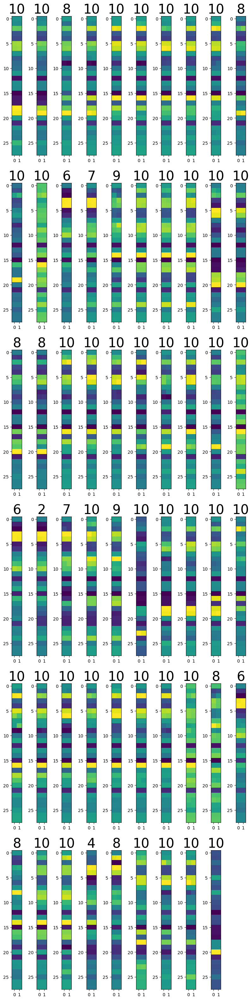

In [60]:
plt.figure(figsize=(10, 40))
for i, (image, label) in enumerate(image_and_label_train[1000:60000:1000]):
    plt.subplot(6,10,i+1)
    plt.imshow(image)
    plt.title(label, size=30)

In [220]:
image_train = np.expand_dims(window_datas_train, axis=3)
image_test = np.expand_dims(window_datas_test, axis=3)
image_hidden = np.expand_dims(window_datas_hidden, axis=3)

In [226]:
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
import tensorflow.keras.layers as L
import keras
inputs = layers.Input(shape=(28, 2, 1))
x = layers.Rescaling(1./255)(inputs)
x = layers.Conv2D(filters=32, kernel_size=(1, 2), activation="relu")(x)
x = layers.AveragePooling2D(pool_size=(1, 2), padding='same')(x)
x = layers.Conv2D(filters=64, kernel_size=(2, 1), activation="relu")(x)
x = layers.AveragePooling2D(pool_size=(2, 1), padding='same')(x)
x = layers.Flatten()(x)
x = L.Dense(40, activation='relu')(x)
x = layers.Dropout(0.1)(x)
x = L.Dense(20, activation='relu')(x)
outputs = layers.Dense(12, activation="softmax")(x)
model12 = keras.Model(inputs=inputs, outputs=outputs)

In [227]:
import tensorflow as tf
model12.compile(optimizer=tf.keras.optimizers.Adam(),
                loss=tf.keras.losses.CategoricalCrossentropy(), metrics=['Accuracy'])

In [228]:
history = model12.fit(image_train, y_train_ohe, epochs=10,
                      validation_data=(image_test, y_test_ohe), batch_size=200)

Epoch 1/10
5853/5853 [==============================] - 48s 8ms/step - loss: 0.7600 - Accuracy: 0.7504 - val_loss: 0.8269 - val_Accuracy: 0.7605
Epoch 2/10
5853/5853 [==============================] - 50s 9ms/step - loss: 0.5552 - Accuracy: 0.8140 - val_loss: 0.8303 - val_Accuracy: 0.7614
Epoch 3/10
5853/5853 [==============================] - 48s 8ms/step - loss: 0.5067 - Accuracy: 0.8305 - val_loss: 0.7695 - val_Accuracy: 0.7743
Epoch 4/10
5853/5853 [==============================] - 48s 8ms/step - loss: 0.4838 - Accuracy: 0.8376 - val_loss: 0.8356 - val_Accuracy: 0.7568
Epoch 5/10
5853/5853 [==============================] - 47s 8ms/step - loss: 0.4688 - Accuracy: 0.8423 - val_loss: 0.8379 - val_Accuracy: 0.7697
Epoch 6/10
5853/5853 [==============================] - 49s 8ms/step - loss: 0.4575 - Accuracy: 0.8455 - val_loss: 0.8967 - val_Accuracy: 0.7451
Epoch 7/10
5853/5853 [==============================] - 48s 8ms/step - loss: 0.4484 - Accuracy: 0.8484 - val_loss: 0.8806 - val_Ac

In [229]:
y_hidden_pred = model12.predict(image_hidden)

3825/3825 [==============================] - 7s 2ms/step


In [230]:
from sklearn.metrics import accuracy_score
accuracy_score(y_pred=np.argmax(y_hidden_pred, axis=1), y_true=y_hidden)

0.7322401692851949

## Ensemble Model (xgb | lgb | cat)

In [7]:
# Import necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import os
from copy import deepcopy
from functools import partial
from itertools import combinations
import random
import gc

# Import sklearn classes for model selection, cross validation, and performance evaluation
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold, KFold
from sklearn.metrics import roc_auc_score, accuracy_score, log_loss
from sklearn.preprocessing import StandardScaler
import seaborn as sns
#from category_encoders import OneHotEncoder, OrdinalEncoder, CountEncoder, CatBoostEncoder
#from imblearn.under_sampling import RandomUnderSampler

# Import libraries for Hypertuning
import optuna

# Import libraries for gradient boosting
import xgboost as xgb
import lightgbm as lgb
from sklearn.ensemble import RandomForestClassifier, HistGradientBoostingClassifier, GradientBoostingClassifier
from sklearn.svm import NuSVC, SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPClassifier
from catboost import CatBoost, CatBoostRegressor, CatBoostClassifier
from catboost import Pool

# Suppress warnings
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [8]:
X_train = train_scaled.drop('LITHO', axis=1)
y_train = train_scaled['LITHO']
print(f"X_train shape :{X_train.shape} , y_train shape :{y_train.shape}")

X_test = test_scaled.drop('LITHO', axis=1)
y_test = test_scaled['LITHO']
print(f"X_test shape :{X_test.shape} , y_test shape :{y_test.shape}")

X_hidden = hidden_scaled.drop('LITHO', axis=1)
y_hidden = hidden_scaled['LITHO']
print(f"X_hidden shape :{X_hidden.shape} , y_hidden shape :{y_hidden.shape}")


X_train shape :(1170511, 38) , y_train shape :(1170511,)
X_test shape :(136786, 38) , y_test shape :(136786,)
X_hidden shape :(122397, 38) , y_hidden shape :(122397,)


In [12]:
class Splitter:
    def __init__(self, n_splits=5):
        self.n_splits = n_splits

    def split_data(self, X, y, random_state_list):
        for random_state in random_state_list:
            kf = StratifiedKFold(n_splits=self.n_splits, random_state=random_state, shuffle=True)
            for train_index, val_index in kf.split(X, y):
                X_train, X_val = X.iloc[train_index], X.iloc[val_index]
                y_train, y_val = y.iloc[train_index], y.iloc[val_index]
                yield X_train, X_val, y_train, y_val

class Classifier:
    def __init__(self, n_estimators=100, device="cpu", random_state=0):
        self.n_estimators = n_estimators
        self.device = device
        self.random_state = random_state
        self.models = self._define_model()
        self.len_models = len(self.models)
        
    def _define_model(self):
        
        xgb_params = {
            'n_estimators': self.n_estimators,
            'max_depth': 4,
            'booster': 'gbtree',
            'objective': 'multi:softprob',
            'learning_rate': 0.075,
            'subsample': 1.0,
            'colsample_bytree': 1.0,
            'reg_lambda': 1500,
            'n_jobs': -1,
            'verbosity': 0,
            'random_state': self.random_state,
        }
        if self.device == 'gpu':
            xgb_params['tree_method'] = 'gpu_hist'
            xgb_params['predictor'] = 'gpu_predictor'
        
        lgb_params = {
            'n_estimators': self.n_estimators,
            'learning_rate': 0.015,
            'max_depth': 8,
            'reg_lambda': 250,
            'objective': 'multi:softprob',
            'silent': True,
            'verbose': -1,
            'device': self.device,
            'random_state': self.random_state
        }
        
        cb_params = {
            'iterations': self.n_estimators,
            'learning_rate': 0.1,
            'depth': 6,
            'l2_leaf_reg': 300,
            'grow_policy': 'SymmetricTree',
            'task_type': self.device.upper(),
            'random_state': self.random_state
        }
        
        models = {
            'xgb': xgb.XGBClassifier(**xgb_params),
            'lgb': lgb.LGBMClassifier(**lgb_params),
            'cat': CatBoostClassifier(**cb_params)
        }
        
        return models


In [13]:
class OptunaWeights:
    def __init__(self, random_state):
        self.study = None
        self.weights = None
        self.random_state = random_state

    def _objective(self, trial, y_true, y_preds):
        # Define the weights for the predictions from each model
        weights = [trial.suggest_float(f"weight{n}", 0, 1) for n in range(len(y_preds))]

        # Calculate the weighted prediction
        weighted_pred = np.average(np.array(y_preds).T, axis=1, weights=weights)
        
        # Calculate the AUC score for the weighted prediction
        score = accuracy_score(y_true.values, weighted_pred.astype(np.int64))
        return score

    def fit(self, y_true, y_preds, n_trials=2000):
        optuna.logging.set_verbosity(optuna.logging.ERROR)
        sampler = optuna.samplers.CmaEsSampler(seed=self.random_state)
        self.study = optuna.create_study(sampler=sampler, study_name="OptunaWeights", direction='maximize')
        objective_partial = partial(self._objective, y_true=y_true, y_preds=y_preds)
        self.study.optimize(objective_partial, n_trials=n_trials)
        self.weights = [self.study.best_params[f"weight{n}"] for n in range(len(y_preds))]

    def predict(self, y_preds):
        assert self.weights is not None, 'OptunaWeights error, must be fitted before predict'
        weighted_pred = np.average(np.array(y_preds).T, axis=1, weights=self.weights)
        return weighted_pred

    def fit_predict(self, y_true, y_preds, n_trials=2000):
        self.fit(y_true, y_preds, n_trials=n_trials)
        return self.predict(y_preds)
    
    def weights(self):
        return self.weights

In [14]:
kfold = True
n_splits = 1 if not kfold else 10
random_state = 42
random_state_list = [42] # used by split_data [42]
n_estimators = 2000 # 9999
early_stopping_rounds = 100 # 200
verbose = 300
device = 'gpu'

splitter = Splitter(n_splits=n_splits)

# Initialize an array for storing test predictions
test_predss = np.zeros(X_test.shape[0])
hidden_predss = np.zeros(X_hidden.shape[0])

ensemble_score = []
weights = []
trained_models = {'xgb':[], 'lgb':[], 'cat':[]}

for i, (X_train_, X_val, y_train_, y_val) in enumerate(splitter.split_data(X_train, y_train,
                                                                           random_state_list=random_state_list)):
    n = i % n_splits
    m = i // n_splits
    # Get a set of Regressor models
    classifier = Classifier(n_estimators, device, random_state)
    models = classifier.models
    
    # Initialize lists to store oof and test predictions for each base model
    oof_preds = []
    test_preds = []
    hidden_preds = []
    
    # Loop over each base model and fit it to the training data, evaluate on validation data, and store predictions
    for name, model in models.items():
        if name in ['xgb', 'lgb', 'cat']:
            model.fit(X_train_, y_train_, eval_set=[(X_val, y_val)], early_stopping_rounds=early_stopping_rounds, verbose=verbose)
            trained_models[f'{name}'].append(deepcopy(model))
        else:
            model.fit(X_train_, y_train_)
        
        test_pred = model.predict(X_test)
        hidden_pred = model.predict(X_hidden)
        y_val_pred = model.predict(X_val)

        score = accuracy_score(y_val, y_val_pred)
        print(f'{name} [FOLD-{n} SEED-{random_state_list[m]}] accuracy_score: {score:.5f}')
        
        oof_preds.append(y_val_pred)
        test_preds.append(test_pred)
        hidden_preds.append(hidden_pred)
        oof_preds[-1] = oof_preds[-1].reshape(-1)
        test_preds[-1] = test_preds[-1].reshape(-1)
        hidden_preds[-1] = hidden_preds[-1].reshape(-1)
    
    # Use Optuna to find the best ensemble weights
    optweights = OptunaWeights(random_state=random_state)
    y_val_pred_ = optweights.fit_predict(y_val, oof_preds)
    
    score = accuracy_score(y_val, y_val_pred_.astype(np.int64))
    print(f'Ensemble [FOLD-{n} SEED-{random_state_list[m]}] accuracy_score {score:.5f}')
    ensemble_score.append(score)
    weights.append(optweights.weights)
    
    test_predss += optweights.predict(test_preds) / (n_splits * len(random_state_list))
    hidden_predss += optweights.predict(hidden_preds) / (n_splits * len(random_state_list))
    
    gc.collect()
    i += 1

[0]	validation_0-mlogloss:2.24882
[300]	validation_0-mlogloss:0.41070
[600]	validation_0-mlogloss:0.35872
[900]	validation_0-mlogloss:0.33026
[1200]	validation_0-mlogloss:0.31262
[1500]	validation_0-mlogloss:0.29931
[1800]	validation_0-mlogloss:0.28849
[1999]	validation_0-mlogloss:0.28336
xgb [FOLD-0 SEED-42] accuracy_score: 0.90225
[300]	valid_0's multi_logloss: 0.393586
[600]	valid_0's multi_logloss: 0.331033
[900]	valid_0's multi_logloss: 0.302428
[1200]	valid_0's multi_logloss: 0.284813
[1500]	valid_0's multi_logloss: 0.271803
[1800]	valid_0's multi_logloss: 0.261752
lgb [FOLD-0 SEED-42] accuracy_score: 0.91086


0:	learn: 1.9799266	test: 1.9801859	best: 1.9801859 (0)	total: 190ms	remaining: 6m 19s
300:	learn: 0.4118311	test: 0.4148301	best: 0.4148301 (300)	total: 34.7s	remaining: 3m 15s
600:	learn: 0.3579511	test: 0.3621014	best: 0.3621014 (600)	total: 1m 9s	remaining: 2m 41s
900:	learn: 0.3306102	test: 0.3356008	best: 0.3356008 (900)	total: 1m 43s	remaining: 2m 6s
1200:	learn: 0.3121460	test: 0.3179424	best: 0.3179424 (1200)	total: 2m 17s	remaining: 1m 31s
1500:	learn: 0.2989506	test: 0.3054012	best: 0.3054012 (1500)	total: 2m 52s	remaining: 57.3s
1800:	learn: 0.2888604	test: 0.2959403	best: 0.2959403 (1800)	total: 3m 27s	remaining: 22.9s
1999:	learn: 0.2833572	test: 0.2906934	best: 0.2906934 (1999)	total: 3m 50s	remaining: 0us
bestTest = 0.2906934191
bestIteration = 1999
cat [FOLD-0 SEED-42] accuracy_score: 0.90085
Ensemble [FOLD-0 SEED-42] accuracy_score 0.90465
[0]	validation_0-mlogloss:2.24933
[300]	validation_0-mlogloss:0.41200
[600]	validation_0-mlogloss:0.36053
[900]	validation_0-mlogl

0:	learn: 1.9688606	test: 1.9697477	best: 1.9697477 (0)	total: 258ms	remaining: 8m 35s
300:	learn: 0.4106505	test: 0.4139757	best: 0.4139757 (300)	total: 35.5s	remaining: 3m 20s
600:	learn: 0.3574295	test: 0.3617595	best: 0.3617595 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3299348	test: 0.3349660	best: 0.3349660 (900)	total: 1m 45s	remaining: 2m 8s
1200:	learn: 0.3121619	test: 0.3177626	best: 0.3177626 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2990194	test: 0.3051003	best: 0.3051003 (1500)	total: 2m 55s	remaining: 58.2s
1800:	learn: 0.2886651	test: 0.2952119	best: 0.2952119 (1800)	total: 3m 29s	remaining: 23.2s
1999:	learn: 0.2827146	test: 0.2895039	best: 0.2895039 (1999)	total: 3m 52s	remaining: 0us
bestTest = 0.2895039475
bestIteration = 1999
cat [FOLD-1 SEED-42] accuracy_score: 0.90273
Ensemble [FOLD-1 SEED-42] accuracy_score 0.90405
[0]	validation_0-mlogloss:2.24861
[300]	validation_0-mlogloss:0.40716
[600]	validation_0-mlogloss:0.35455
[900]	validation_0-mlog

0:	learn: 1.9794295	test: 1.9797117	best: 1.9797117 (0)	total: 273ms	remaining: 9m 4s
300:	learn: 0.4120543	test: 0.4103614	best: 0.4103614 (300)	total: 35.5s	remaining: 3m 20s
600:	learn: 0.3590618	test: 0.3579462	best: 0.3579462 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3314116	test: 0.3311193	best: 0.3311193 (900)	total: 1m 45s	remaining: 2m 8s
1200:	learn: 0.3127500	test: 0.3132146	best: 0.3132146 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2999955	test: 0.3010626	best: 0.3010626 (1500)	total: 2m 55s	remaining: 58.2s
1800:	learn: 0.2899853	test: 0.2916957	best: 0.2916957 (1800)	total: 3m 29s	remaining: 23.2s
1999:	learn: 0.2846288	test: 0.2867540	best: 0.2867540 (1999)	total: 3m 52s	remaining: 0us
bestTest = 0.2867540444
bestIteration = 1999
cat [FOLD-2 SEED-42] accuracy_score: 0.90291
Ensemble [FOLD-2 SEED-42] accuracy_score 0.90663
[0]	validation_0-mlogloss:2.24844
[300]	validation_0-mlogloss:0.41175
[600]	validation_0-mlogloss:0.35912
[900]	validation_0-mlogl

0:	learn: 1.9796772	test: 1.9789166	best: 1.9789166 (0)	total: 263ms	remaining: 8m 46s
300:	learn: 0.4115179	test: 0.4139259	best: 0.4139259 (300)	total: 35.6s	remaining: 3m 20s
600:	learn: 0.3599670	test: 0.3625820	best: 0.3625820 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3314206	test: 0.3343210	best: 0.3343210 (900)	total: 1m 45s	remaining: 2m 9s
1200:	learn: 0.3126761	test: 0.3160016	best: 0.3160016 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2995690	test: 0.3032228	best: 0.3032228 (1500)	total: 2m 55s	remaining: 58.5s
1800:	learn: 0.2894330	test: 0.2934984	best: 0.2934984 (1800)	total: 3m 30s	remaining: 23.3s
1999:	learn: 0.2841927	test: 0.2885617	best: 0.2885617 (1999)	total: 3m 53s	remaining: 0us
bestTest = 0.2885616833
bestIteration = 1999
cat [FOLD-3 SEED-42] accuracy_score: 0.90236
Ensemble [FOLD-3 SEED-42] accuracy_score 0.90704
[0]	validation_0-mlogloss:2.24885
[300]	validation_0-mlogloss:0.41147
[600]	validation_0-mlogloss:0.36003
[900]	validation_0-mlog

0:	learn: 1.9812851	test: 1.9811817	best: 1.9811817 (0)	total: 260ms	remaining: 8m 40s
300:	learn: 0.4123022	test: 0.4156414	best: 0.4156414 (300)	total: 35.4s	remaining: 3m 19s
600:	learn: 0.3586680	test: 0.3632132	best: 0.3632132 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3305473	test: 0.3357795	best: 0.3357795 (900)	total: 1m 45s	remaining: 2m 8s
1200:	learn: 0.3126537	test: 0.3183622	best: 0.3183622 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2998512	test: 0.3059994	best: 0.3059994 (1500)	total: 2m 55s	remaining: 58.3s
1800:	learn: 0.2892853	test: 0.2958610	best: 0.2958610 (1800)	total: 3m 29s	remaining: 23.2s
1999:	learn: 0.2834189	test: 0.2903431	best: 0.2903431 (1999)	total: 3m 52s	remaining: 0us
bestTest = 0.2903430916
bestIteration = 1999
cat [FOLD-4 SEED-42] accuracy_score: 0.90142
Ensemble [FOLD-4 SEED-42] accuracy_score 0.90396
[0]	validation_0-mlogloss:2.24815
[300]	validation_0-mlogloss:0.40756
[600]	validation_0-mlogloss:0.35526
[900]	validation_0-mlog

0:	learn: 1.9800047	test: 1.9796679	best: 1.9796679 (0)	total: 276ms	remaining: 9m 10s
300:	learn: 0.4124111	test: 0.4107271	best: 0.4107271 (300)	total: 35.5s	remaining: 3m 20s
600:	learn: 0.3586935	test: 0.3579561	best: 0.3579561 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3317810	test: 0.3318258	best: 0.3318258 (900)	total: 1m 45s	remaining: 2m 8s
1200:	learn: 0.3136231	test: 0.3144069	best: 0.3144069 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.3003672	test: 0.3017234	best: 0.3017234 (1500)	total: 2m 55s	remaining: 58.3s
1800:	learn: 0.2897939	test: 0.2916465	best: 0.2916465 (1800)	total: 3m 30s	remaining: 23.2s
1999:	learn: 0.2838256	test: 0.2860137	best: 0.2860137 (1999)	total: 3m 53s	remaining: 0us
bestTest = 0.2860136821
bestIteration = 1999
cat [FOLD-5 SEED-42] accuracy_score: 0.90320
Ensemble [FOLD-5 SEED-42] accuracy_score 0.90711
[0]	validation_0-mlogloss:2.24850
[300]	validation_0-mlogloss:0.41226
[600]	validation_0-mlogloss:0.36011
[900]	validation_0-mlog

0:	learn: 1.9811539	test: 1.9811866	best: 1.9811866 (0)	total: 237ms	remaining: 7m 54s
300:	learn: 0.4112473	test: 0.4135687	best: 0.4135687 (300)	total: 35.2s	remaining: 3m 18s
600:	learn: 0.3581704	test: 0.3613288	best: 0.3613288 (600)	total: 1m 10s	remaining: 2m 43s
900:	learn: 0.3306481	test: 0.3346497	best: 0.3346497 (900)	total: 1m 45s	remaining: 2m 8s
1200:	learn: 0.3122422	test: 0.3170172	best: 0.3170172 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2991811	test: 0.3047192	best: 0.3047192 (1500)	total: 2m 54s	remaining: 58.1s
1800:	learn: 0.2885687	test: 0.2947273	best: 0.2947273 (1800)	total: 3m 29s	remaining: 23.1s
1999:	learn: 0.2829633	test: 0.2895489	best: 0.2895489 (1999)	total: 3m 52s	remaining: 0us
bestTest = 0.2895488665
bestIteration = 1999
cat [FOLD-6 SEED-42] accuracy_score: 0.90247
Ensemble [FOLD-6 SEED-42] accuracy_score 0.90673
[0]	validation_0-mlogloss:2.24865
[300]	validation_0-mlogloss:0.41240
[600]	validation_0-mlogloss:0.35867
[900]	validation_0-mlog

0:	learn: 1.9812304	test: 1.9815620	best: 1.9815620 (0)	total: 323ms	remaining: 10m 45s
300:	learn: 0.4121816	test: 0.4145735	best: 0.4145735 (300)	total: 35.7s	remaining: 3m 21s
600:	learn: 0.3577733	test: 0.3611081	best: 0.3611081 (600)	total: 1m 11s	remaining: 2m 45s
900:	learn: 0.3310725	test: 0.3347984	best: 0.3347984 (900)	total: 1m 46s	remaining: 2m 9s
1200:	learn: 0.3127281	test: 0.3169010	best: 0.3169010 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2998430	test: 0.3043895	best: 0.3043895 (1500)	total: 2m 55s	remaining: 58.4s
1800:	learn: 0.2900122	test: 0.2949427	best: 0.2949427 (1800)	total: 3m 30s	remaining: 23.2s
1999:	learn: 0.2839917	test: 0.2891252	best: 0.2891252 (1999)	total: 3m 53s	remaining: 0us
bestTest = 0.2891252397
bestIteration = 1999
cat [FOLD-7 SEED-42] accuracy_score: 0.90256
Ensemble [FOLD-7 SEED-42] accuracy_score 0.90710
[0]	validation_0-mlogloss:2.24874
[300]	validation_0-mlogloss:0.41115
[600]	validation_0-mlogloss:0.35724
[900]	validation_0-mlo

0:	learn: 1.9689680	test: 1.9698301	best: 1.9698301 (0)	total: 255ms	remaining: 8m 29s
300:	learn: 0.4120396	test: 0.4142554	best: 0.4142554 (300)	total: 35.5s	remaining: 3m 20s
600:	learn: 0.3590261	test: 0.3613684	best: 0.3613684 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3310999	test: 0.3338745	best: 0.3338745 (900)	total: 1m 45s	remaining: 2m 8s
1200:	learn: 0.3127326	test: 0.3160515	best: 0.3160515 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.2992929	test: 0.3031620	best: 0.3031620 (1500)	total: 2m 55s	remaining: 58.3s
1800:	learn: 0.2891536	test: 0.2935867	best: 0.2935867 (1800)	total: 3m 30s	remaining: 23.2s
1999:	learn: 0.2837134	test: 0.2885130	best: 0.2885130 (1999)	total: 3m 52s	remaining: 0us
bestTest = 0.2885129933
bestIteration = 1999
cat [FOLD-8 SEED-42] accuracy_score: 0.90312
Ensemble [FOLD-8 SEED-42] accuracy_score 0.90759
[0]	validation_0-mlogloss:2.24851
[300]	validation_0-mlogloss:0.41001
[600]	validation_0-mlogloss:0.35877
[900]	validation_0-mlog

0:	learn: 1.9799830	test: 1.9793568	best: 1.9793568 (0)	total: 308ms	remaining: 10m 16s
300:	learn: 0.4105340	test: 0.4110725	best: 0.4110725 (300)	total: 35.6s	remaining: 3m 20s
600:	learn: 0.3579928	test: 0.3599681	best: 0.3599681 (600)	total: 1m 10s	remaining: 2m 44s
900:	learn: 0.3317300	test: 0.3348223	best: 0.3348223 (900)	total: 1m 45s	remaining: 2m 9s
1200:	learn: 0.3131120	test: 0.3168273	best: 0.3168273 (1200)	total: 2m 20s	remaining: 1m 33s
1500:	learn: 0.3002995	test: 0.3046377	best: 0.3046377 (1500)	total: 2m 55s	remaining: 58.4s
1800:	learn: 0.2902059	test: 0.2951097	best: 0.2951097 (1800)	total: 3m 30s	remaining: 23.3s
1999:	learn: 0.2845951	test: 0.2898564	best: 0.2898564 (1999)	total: 3m 53s	remaining: 0us
bestTest = 0.2898564248
bestIteration = 1999
cat [FOLD-9 SEED-42] accuracy_score: 0.90254
Ensemble [FOLD-9 SEED-42] accuracy_score 0.90707


In [15]:
# Calculate the mean LogLoss score of the ensemble
mean_score = np.mean(ensemble_score)
std_score = np.std(ensemble_score)
print(f'Ensemble Accuracy score {mean_score:.5f} ± {std_score:.5f}')

# Print the mean and standard deviation of the ensemble weights for each model
print('--- Model Weights ---')
mean_weights = np.mean(weights, axis=0)
std_weights = np.std(weights, axis=0)
for name, mean_weight, std_weight in zip(models.keys(), mean_weights, std_weights):
    print(f'{name}: {mean_weight:.5f} ± {std_weight:.5f}')

Ensemble Accuracy score 0.90619 ± 0.00132
--- Model Weights ---
xgb: 0.19873 ± 0.31337
lgb: 0.71044 ± 0.33132
cat: 0.04555 ± 0.04256


In [16]:
test_predss

array([10., 10., 10., ...,  8.,  8.,  8.])

In [17]:
accuracy_score(y_test, test_predss.astype(np.int64))

0.6226660623163189

In [18]:
hidden_predss

array([10.        , 10.        , 10.        , ...,  8.9916657 ,
        9.01175946,  9.12099091])

In [19]:
accuracy_score(y_hidden, hidden_predss.astype(np.int64))

0.6928764593903446